# Prerequisites

In [1]:
%reload_ext autoreload
%autoreload 2

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import os
import pickle
import copy

import pandas as pd
import numpy as np
from collections import OrderedDict
import itertools

# Regression and statistical tests
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from statsmodels.stats.outliers_influence import summary_table
from scipy.optimize import least_squares
from scipy.interpolate import interp1d
from linearmodels.panel import PanelOLS, PooledOLS, RandomEffects
from linearmodels.panel import compare
import pymannkendall as mk

# Interaction with R
import rpy2
import rpy2.robjects as robjects
from rpy2.robjects import r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
_ = r('library(pdynmc)')
_ = r('library(plm)')

import ipywidgets as widgets
from ipywidgets import interact, Button, Output

from IPython.display import Markdown, Image, display
def printmd(string):
    """Embed the input string into Markdown."""
    display(Markdown(string))

## Visualisation settings
[$\LaTeX$ preamble in matplotlib](https://stackoverflow.com/questions/41453109/how-to-write-your-own-latex-preamble-in-matplotlib)

In [2]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib import rc
rc('text', usetex=True)

latex_packages = [r'\usepackage{siunitx}', r'\sisetup{detect-all}',
                  r'\usepackage{helvet}', r'\usepackage{sansmath}',
                  r'\sansmath', r'\usepackage{amsmath}']
latex_commands = [r'\newcommand{\epr}[2]{[\underline{\pi}^*#1, \overline{\pi}^*#2]}',
                  r'\newcommand{\bbid}[2]{\beta_{#1}^{#2}}',
                  r'\newcommand{\bval}[1]{\overline{\beta}_{#1}}',
                  r'\newcommand{\sbid}[2]{\sigma_{#1}^{#2}}',
                  r'\newcommand{\sval}[1]{\underline{\sigma}_{#1}}']
latex_preamble = ' '.join(latex_packages + latex_commands)

mpl.rcParams['text.latex.preamble'] = latex_preamble
printmd(r'${}$'.format(' '.join(latex_commands)))

from matplotlib.patches import Patch
from matplotlib.lines import Line2D

from matplotlib.colors import ListedColormap
import matplotlib.ticker as tick

import matplotlib.style as style
style.use('seaborn-poster')
style.use('ggplot')
sns.set_style('whitegrid', {'grid.linestyle': 'dotted'})

parameters = {'axes.labelsize': 14, 'axes.titlesize': 14, 'figure.titlesize': 16,
              'xtick.labelsize': 12, 'ytick.labelsize': 12, 'legend.fontsize': 10,
              'xtick.major.pad': -0.5, 'xtick.minor.pad': -0.5,
              'ytick.major.pad': -0.5, 'ytick.minor.pad': -0.5,}

plt.rcParams.update(parameters)

$\newcommand{\epr}[2]{[\underline{\pi}^*#1, \overline{\pi}^*#2]} \newcommand{\bbid}[2]{\beta_{#1}^{#2}} \newcommand{\bval}[1]{\overline{\beta}_{#1}} \newcommand{\sbid}[2]{\sigma_{#1}^{#2}} \newcommand{\sval}[1]{\underline{\sigma}_{#1}}$

$\LaTeX$ shortcuts defined in the cell above:

| Label | Command | Description |
|---|---|---|
| $\bbid{i}{k}$ | ``\bbid{i}{k}`` | $k$-th bid overall submitted by buyer $b_i$ |
| $\bbid{i}{k,T}$ | ``\bbid{i}{k,T}`` | $k$-th bid submitted by buyer $b_i$ in trading round $T$ |
| $\bval{i}$ | ``\bval{i}`` | buyer $b_i$'s valuation (reservation price) |
| $\sbid{j}{k}$ | ``\sbid{j}{k}`` | $k$-th ask overall submitted by seller $s_j$ |
| $\sbid{j}{k,T}$ | ``\sbid{j}{k,T}`` | $k$-th ask submitted by seller $s_j$ in trading round $T$ |
| $\sval{j}$ | ``\sval{j}`` | buyer $s_j$'s valuation (reservation price)

[Enable ```R``` inline plots](https://stackoverflow.com/questions/43110228/how-to-plot-inline-with-rpy2-in-jupyter-notebook)

In [4]:
from contextlib import contextmanager
from rpy2.robjects.lib import grdevices

@contextmanager
def r_inline_plot(width=600, height=600, dpi=100):
    with grdevices.render_to_bytesio(grdevices.png, width=width, height=height, res=dpi) as b:
        yield

    data = b.getvalue()
    display(Image(data=data, format='png', embed=True))

## Helper functions

In [5]:
from copy import deepcopy
from collections import deque

def flatten_list(nested_list):
    """Flatten an arbitrarily nested list (without recursion to avoid
    stack overflows). Returns a new list, the original list is unchanged."""
    q = deque()
    
    for current in nested_list:
        if isinstance(current, list):
            q.extendleft(reversed(current))
        else:
            q.appendleft(current)
        while q:
            toFlat = q.popleft()
            if isinstance(toFlat, list):
                q.extendleft(reversed(toFlat))
            else:
                yield toFlat
                
def bold_text(string):
    """Render the input string as bold.
    Returns a new string, the original string is unchanged."""
    return r'\textbf{{{}}}'.format(string)

## Importing & pre-processing data

In [6]:
df = pd.read_csv('ExperimentalData.csv')
df['id'] = df.groupby(['treatment', 'game', 'id']).ngroup()

Add new experimental sessions (5 baseline and 10 with an upper limit to sellers' asks of which 5 have Black Box feedback and 5 have Full feedback)

In [7]:
df_new = pd.read_csv('NewData.csv')
df_new['valuation'] = df_new['valuation'].fillna(1).astype('int64')
df_new = df.append(df_new[df_new['treatment'].isin(['BBLimS', 'FullLimS', 'CSRnormal'])]).copy()
df_new['id'] = df_new.groupby(['treatment', 'game', 'id']).ngroup()

In [8]:
# Dictionary of the form: 
# {'variable dimension': (list of corresponding treatments, overarching title, relevant part of the treatment name)}
treatment_dimensions = {'feedback': (['BB', 'Same', 'Other', 'Full'], 'Varying the amount of feedback', 0),
                        'price': (['BBRandom','BBMMK','SameMMK'], 'Varying the price rule', 1),
                        'structure': (['BBMoreB', 'BBMoreS', 'BBLargeCE', 'BBMoreRounds', 'FullMoreB', 'FullMoreS', 'FullLargeCE'], 'Varying the market structure', 2),
                        'dynamics': (['FullSShift','FullFromBtoS','FullFromStoB'], 'Dynamic environments', 2)}

dynamic_treatments = treatment_dimensions['dynamics'][0]
BB_treatments = set(filter(lambda treatment: 'BB' in treatment, df['treatment']))
all_treatments = set(df['treatment'])

treatment_groups = OrderedDict(
                        {('Regular markets', 'non-Black Box'): ['Full', 'Other', 'Same', 'SameMMK'],
                         ('Asymmetric markets', 'non-Black Box'): ['FullMoreB', 'FullMoreS'],
                         ('Large markets', 'non-Black Box'): ['FullLargeCE', 'FullSShift', 'FullFromBtoS', 'FullFromStoB'],
                         ('Regular markets', 'Black Box'): ['BB', 'BBRandom', 'BBMMK'],
                         ('Asymmetric markets', 'Black Box'): ['BBMoreB', 'BBMoreS'], 
                         ('Large markets', 'Black Box'): ['BBLargeCE', 'BBMoreRounds']})

treatment_names = {'BB': 'Black Box, First price, Regular', 'BBRandom': 'Black Box, Random price, Regular',
                   'BBMMK': r'Black Box, Matchmaker keeps, Regular', 'BBMoreS': r'Black Box, First price, More sellers',
                   'BBMoreB': r'Black Box, First price, More buyers', 'BBLargeCE': r'Black Box, First price, Large CE',
                   'BBMoreRounds': r'Black Box, First price, More rounds',
                   'Full': 'Private Information, First price, Regular', 'Same': 'Same-side, First price, Regular',
                   'SameMMK': 'Same-side, Matchmaker keeps, Regular', 'Other': 'Other-side, First price, Regular',
                   'FullLargeCE': 'Private Information, First price, Large CE', 'FullMoreS': 'Private Information, First price, More sellers',
                   'FullMoreB': 'Private Information, First price, More buyers', 'FullSShift': 'Private Information, First price, Seller shift',
                   'FullFromBtoS': 'Private Information, First price, From buyers to sellers', 'FullFromStoB': 'Private Information, First price, From sellers to buyers',
                   # New data below
                   'BBLimS': 'Black Box, First price, Limited asks',
                   'FullLimS': 'Private Information, First price, Limited asks',
                   'CSRnormal': 'CSR normal'}

## Colour schemes

[Colour scheme generator](https://coolors.co) \
[Colour picker](https://www.htmlcsscolor.com/)

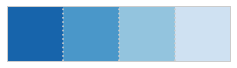

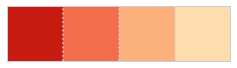

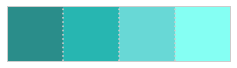

In [9]:
blue_palette = sns.color_palette('Blues_r', n_colors=4) # used for plotting convergence to CE
red_palette = sns.color_palette('OrRd_r', n_colors=4) # used for plotting allocative efficiency
teal_palette = sns.color_palette(['#2A8D8A', '#27B6B1', '#68D8D6', '#85FFF3']) # used for plotting Selten index

sns.palplot(blue_palette)
sns.palplot(red_palette)
sns.palplot(teal_palette)

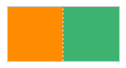

In [10]:
side_colours = {'Seller': 'darkorange', 'Buyer': 'mediumseagreen'}
sns.palplot(side_colours.values())

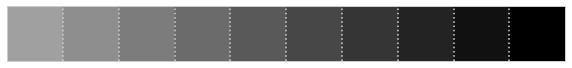

In [11]:
gray_palette = []
n_colours = 10
R1, G1, B1 = [0.7,0.7,0.7]
R2, G2, B2 = [0,0,0]
Rdelta, Gdelta, Bdelta = (R2-R1)/n_colours, (G2-G1)/n_colours, (B2-B1)/n_colours
for col in range(n_colours):
    R1 += Rdelta
    G1 += Gdelta
    B1 += Bdelta
    gray_palette.append((R1, G1, B1))
    
sns.palplot(gray_palette)

# Data overview

[```ipython-tikzmagic``` documentation](https://github.com/mkrphys/ipython-tikzmagic) (prerequisites: ImageMagick, pdf2svg)

In [12]:
%load_ext tikzmagic

preamble = r"""\definecolor{price_rule}{HTML}{586BA4}
\definecolor{market_structure}{HTML}{F5DD90}
\definecolor{feedback}{HTML}{F68E5F}
\definecolor{dynamic}{HTML}{84dcc6}
"""

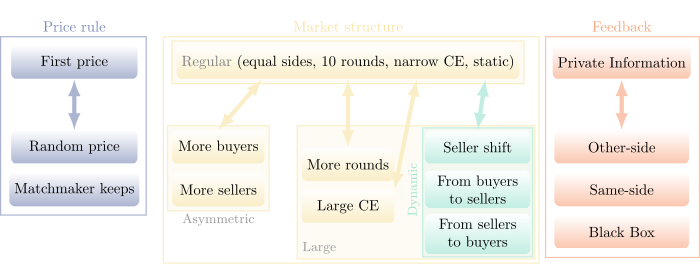

In [13]:
%%tikz -f svg -s 700,280 -l calc,backgrounds -p xcolor -x $preamble
\tikzset{
    block/.style = {shape=rectangle, rounded corners, align=center, minimum size=0.8cm, font=\normalsize},
    price/.style = {top color=white, bottom color=price_rule!50, minimum width=3cm},
    structure/.style = {top color=white, bottom color=market_structure!50, minimum width=2.2cm},
    feedback/.style = {top color=white, bottom color=feedback!50, minimum width=3.2cm},
    dynamic/.style = {top color=white, bottom color=dynamic!50, minimum width=2.5cm},
}

    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %%  Price rule
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, price] (FP) at (0,0) {First price};
    \node[block, price, anchor=north] (RP) at ($(FP.south)+(0,-1.2)$) {Random price};
    \node[block, price] (MMK) at ($(RP.south)+(0,-0.6)$) {Matchmaker keeps};
    
    \draw[line width=1mm, <->, >=latex, color=price_rule!50] (FP.south) -- (RP.north);
    
    \begin{scope}[on background layer]
        \draw[thick, price_rule!50] ($(MMK.south west)+(-0.2,-0.2)$) rectangle ($(FP.north east)+(0.2,0.2)$);
        \node[price_rule!80, anchor=south] at ($(FP.north)+(0,0.2)$) {Price rule};
    \end{scope}
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Market structure
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    \node[block, structure] (ES) at (6.5,0) {\textcolor{gray}{Regular} (equal sides, 10 rounds, narrow CE, static)};

    % Dynamic markets
    \node[block, dynamic, anchor=north] (SShift) at ($(ES.south east)+(-1,-1.2)$) {Seller shift};
    \node[block, dynamic] (FromBtoS) at ($(SShift.south)+(0,-0.6)$) {From buyers\\to sellers};
    \node[block, dynamic] (FromStoB) at ($(FromBtoS.south)+(0,-0.6)$) {From sellers\\to buyers};
    \draw[line width=1mm, <->, >=latex, color=dynamic!50] ($(ES.south)!0.8!(ES.south east)$) -- (SShift.north);

    % More rounds, large CE
    \node[block, structure, anchor=north] (MR) at ($(ES.south |- SShift.center)$) {More rounds};
    \node[block, structure] (LargeCE) at ($(MR.south)+(0,-0.6)$) {Large CE};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] (ES.south) -- (MR.north);
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south)!0.4!(ES.south east)$) -- (LargeCE.north east);
        
    % More buyers, more sellers
    \node[block, structure, anchor=north] (MB) at ($(ES.south west)+(1,-1.2)$) {More buyers};
    \node[block, structure] (MS) at ($(MB.south)+(0,-0.6)$) {More sellers};
    \draw[line width=1mm, <->, >=latex, color=market_structure!50] ($(ES.south west)!0.5!(ES.south)$) -- (MB.north);
    
    \begin{scope}[on background layer]
        \draw[thick, market_structure!50] ($(MS.south west |- FromStoB.south)+(-0.2,-0.2)$) rectangle ($(SShift.east |- ES.north east)+(0.2,0.2)$);
        \node[market_structure!80, anchor=south] at ($(ES.north)+(0,0.2)$) {Market structure};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(LargeCE.west |- FromStoB.south)+(-0.1,-0.1)$) rectangle ($(SShift.north east)+(0.1,0.1)$);
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(ES.south west)+(-0.1,-0.1)$) rectangle ($(ES.north east)+(0.1,0.1)$);
        \node[gray!80, anchor=north, font=\small] at ($(MS.south)+(0,-0.05)$) {Asymmetric};
        
        \draw[thick, market_structure!50, fill=market_structure, opacity=1, fill opacity=0.1] ($(MS.south west)+(-0.1,-0.1)$) rectangle ($(MB.north east)+(0.1,0.1)$);
        \node[gray!80, anchor=south west, font=\small] at ($(LargeCE.west |- FromStoB.south)+(-0.1,-0.1)$) {Large};
        
        \draw[thick, dynamic!50, fill=dynamic, opacity=1, fill opacity=0.1] ($(FromStoB.south west)+(-0.05,-0.05)$) rectangle ($(SShift.north east)+(0.05,0.05)$);
        \node[dynamic!80, anchor=south, font=\small, rotate=90] at ($(FromBtoS.west)$) {Dynamic};
    \end{scope}
    
    %%%%%%%%%%%%%%%%%%%%%%%%%%
    %% Feedback
    %%%%%%%%%%%%%%%%%%%%%%%%%%    
    \node[block, feedback] (PI) at (13,0) {Private Information};
    \node[block, feedback, anchor=north] (Other) at ($(PI.south)+(0,-1.2)$) {Other-side};
    \node[block, feedback] (Same) at ($(Other.south)+(0,-0.6)$) {Same-side};
    \node[block, feedback] (BB) at ($(Same.south)+(0,-0.6)$) {Black Box};
    \draw[line width=1mm, <->, >=latex, color=feedback!50] (PI.south) -- (Other.north);
    
    \begin{scope}[on background layer]
        \draw[thick, feedback!50] ($(BB.south west)+(-0.2,-0.2)$) rectangle ($(PI.north east)+(0.2,0.2)$);
        \node[feedback!80, anchor=south] at ($(PI.north)+(0,0.2)$) {Feedback};
    \end{scope}

In [14]:
data = []
treatments = dict()

for key, vals in copy.deepcopy(treatment_groups).items():
    k = key[0]
    if k in treatments.keys():
        treatments[k].extend(vals)
    else:
        treatments[k] = vals

for treatment in flatten_list(treatments.values()):
    title = treatment_names[treatment].split(',')
    df_treatment = df[df['treatment'] == treatment]
    
    subjects = len(set(df_treatment['id']))
    markets = len(set(df_treatment['game']))
    observations = len(df_treatment)
    
    data.append(title + [subjects, markets, observations])
    
columns = pd.MultiIndex.from_tuples([('Treatment', col) for col in ['Feedback', 'Price rule', 'Market structure']] + 
                                    [('Experimental data', col) for col in ['Subjects', 'Markets', 'Observations']])
treatment_overview = pd.DataFrame.from_records(data, columns=columns)
treatment_overview = treatment_overview.append(treatment_overview.sum(numeric_only=True), ignore_index=True)
treatment_overview.iloc[:,-3:] = treatment_overview.iloc[:,-3:].astype(int)
treatment_overview[('Experimental data','Subjects')] = treatment_overview.apply(lambda row: '{} ({})'.format(row[('Experimental data','Subjects')], 
                                                                                       row[('Experimental data','Markets')]), axis=1)
treatment_overview.rename({'Subjects': 'Subjects (markets)'}, inplace=True, axis=1, level=1)
treatment_overview.drop('Markets', inplace=True, axis=1, level=1)
treatment_overview

Treatment                                              \
               Feedback         Price rule         Market structure   
0   Private Information        First price                  Regular   
1            Other-side        First price                  Regular   
2             Same-side        First price                  Regular   
3             Same-side   Matchmaker keeps                  Regular   
4             Black Box        First price                  Regular   
5             Black Box       Random price                  Regular   
6             Black Box   Matchmaker keeps                  Regular   
7   Private Information        First price              More buyers   
8   Private Information        First price             More sellers   
9             Black Box        First price              More buyers   
10            Black Box        First price             More sellers   
11  Private Information        First price                 Large CE   
12  Private Information        First price             Seller shift   
13  Private Information        First price   From buyers to sellers   
14  Private Information        First price   From sellers to buyers   
15            Black Box        First price                 Large CE   
16            Black Box        First price              More rounds   
17                  NaN                NaN                      NaN   

    Experimental data               
   Subjects (markets) Observations  
0              73 (4)         4810  
1              70 (5)         4238  
2              71 (5)         4069  
3              64 (4)         4605  
4              84 (5)         4495  
5              78 (5)         4249  
6              88 (5)         5334  
7             130 (5)         5683  
8             140 (5)         8012  
9             113 (5)         4792  
10            124 (5)         5236  
11            104 (8)         3479  
12             80 (5)         2467  
13             74 (5)         2380  
14             81 (5)         3118  
15             74 (8)         3259  
16             77 (5)         7392  
17          1525 (89)        77618

# Data analysis

## Equilibrium price range & gains of trade

In [15]:
def get_valuations(df):
    '''Extract buyer and seller valuations.'''
    valuations = {}
    
    for side, df_side in df.groupby(['side']):
        side_valuations = df_side[['id', 'valuation']].drop_duplicates()['valuation'].tolist()
    
        if side == 'Buyer':
            side_valuations.sort(reverse=True)
        else:
            side_valuations.sort()
    
        valuations[side] = side_valuations
    
    return valuations

def get_equilibrium(df):
    '''Extract the equilibrium price range, the gains of trade,
    and the equilibrium quantity corresponding to a given experimental market.'''
    
    valuations = get_valuations(df)
    buyer_valuations = valuations['Buyer']
    seller_valuations = valuations['Seller']

    GOT = 0
    eq_quantity = min(len(buyer_valuations), len(seller_valuations))
    
    # Find the intersection of supply and demand schedules and compute the corresponding gains of trade 
    for i in range(eq_quantity):
        if seller_valuations[i] > buyer_valuations[i]:
            eq_quantity = i
            break
        else:
            GOT += buyer_valuations[i] - seller_valuations[i]

    EPR = [seller_valuations[eq_quantity-1], buyer_valuations[eq_quantity-1]]
        
    return EPR, GOT, eq_quantity

Game-specific equilibrium price ranges, gains of trade, and equilibrium quantities

In [16]:
equilibrium_price_ranges = {}
gains_of_trade = {}
equilibrium_quantities = {}

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    if treatment in dynamic_treatments:
        # The structure of these markets changes after round 5
        df_game1 = df_game[(df_game['round'].isin(range(1,6)))]
        df_game2 = df_game[(df_game['round'].isin(range(6,11)))]
        
        EPR1, GOT1, eq_quantity1 = get_equilibrium(df_game1) 
        EPR2, GOT2, eq_quantity2 = get_equilibrium(df_game2)
        
        equilibrium_price_ranges[treatment, game] = [EPR1, EPR2]
        gains_of_trade[treatment, game] = [GOT1, GOT2]
        equilibrium_quantities[treatment, game] = [eq_quantity1, eq_quantity2]
      
    else:
        EPR, GOT, eq_quantity = get_equilibrium(df_game)

        equilibrium_price_ranges[treatment, game] = [EPR]
        gains_of_trade[treatment, game] = [GOT]
        equilibrium_quantities[treatment, game] = [eq_quantity]

Round-specific equilibrium price ranges, gains of trade, and equilibrium quantities

In [17]:
EPR_rounds = {}
GOT_rounds = {}
eq_quantity_rounds = {}

for (treatment, game, rnd), df_round in df.groupby(['treatment', 'game', 'round']):
    EPR, GOT, eq_quantity = get_equilibrium(df_round)

    EPR_rounds[treatment, game, rnd] = EPR
    GOT_rounds[treatment, game, rnd] = GOT
    eq_quantity_rounds[treatment, game, rnd] = eq_quantity

## Convergence to equilibrium price range & allocative efficiency

### Overview of individual sessions

_Left panel_: demand and supply schedules\
_Right panel_: realised prices with a one-standard-deviation interval around the average per round

The area highlighted in red represents the CE price range $\epr{}{}$.

In [18]:
def plot_epr(ax, EPR):
    [epr1, epr2] = EPR
    
    # Equilibrium price range   
    _ = ax.axhline(y=epr1, linestyle='dashed', linewidth=1.0, color='#E24A33', alpha=0.3)
    _ = ax.axhline(y=epr2, linestyle='dashed', linewidth=1.0, color='#E24A33', alpha=0.3)
    _ = ax.axhspan(epr1, epr2, color='#E24A33', alpha=0.15)

def supply_demand_schedule(ax, buyer_valuations, seller_valuations, eq_quantity):    
    # Supply and demand curves
    buyer_valuations.append(min(seller_valuations))
    seller_valuations.append(max(buyer_valuations))
    len_bvals = len(buyer_valuations)
    len_svals = len(seller_valuations)
    
    _ = ax.step(range(len_bvals), buyer_valuations, 
                 color='black', linewidth=1.2, alpha=0.5, where='post');
    _ = ax.step(range(len_svals), seller_valuations, 
                 color='black', linewidth=1.2, alpha=0.5, where='post');
    _ = ax.fill_between(range(eq_quantity+1), 
                         seller_valuations[0:eq_quantity+1],
                         buyer_valuations[0:eq_quantity+1], 
                         step="post", color='grey', alpha=0.15)

    # Layout
    _ = ax.set_xlabel('Player', fontsize=12)
    xmax = max(len_bvals, len_svals) - 1
    _ = ax.set_xticks(np.arange(0.5, xmax, step=1))
    _ = ax.set_xticks(np.arange(0, xmax+1, step=1), minor=True)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(range(1, xmax+1), size=12)

    _ = ax.set_ylabel('Price', fontsize=12)
    ymin = (min(seller_valuations)-9)//10*10+10
    ymax = (max(buyer_valuations)+9)//10*10+10

    _ = ax.set_ylim(ymin-5, ymax-5)
    _ = ax.set_yticks(np.arange(ymin, ymax, step=10));
    _ = ax.set_yticklabels(range(ymin, ymax, 10), size=12)  

def price_evolution(ax, df, rounds, colour, label):
    time_elapsed = pd.Series((max(df_game['time'])+9)//10*10, index=rounds)
    time_elapsed = time_elapsed.expanding(1).sum()
    time_elapsed.loc[time_elapsed.first_valid_index() - 1] = 0
    time_elapsed.sort_index(inplace=True)
    time_steps = time_elapsed.rolling(2).mean().shift(-1)[:-1]

    # Add rounds in which no bids were submitted
    missing_rounds = pd.DataFrame({'round': [rnd for rnd in rounds if rnd not in df['round'].unique()]}, columns=df.columns)
    df = df.merge(missing_rounds, how='outer').sort_values(['round','time'])

    # Realised prices
    mask = df['price'].notna().values          
    times = df[mask].apply(lambda row: row['match_time'] + time_elapsed[row['round'] - 1], axis=1)
    _ = ax.plot(times, df[mask]['price'], 'ko-', markersize=6, linewidth=2, alpha=0.6)

    # Error bars
    means = df.groupby(['round'])['price'].mean()
    sdevs = df.groupby(['round'])['price'].std()

    mask = means.notna().values
    out = ax.errorbar(time_steps[mask], means[mask], sdevs[mask].fillna(0), 
                      color=colour, fmt='-o', capsize=1, ms=0, linewidth=2, ecolor=colour)
    _ = ax.fill_between(time_steps[mask], out[1][0].get_data()[1], out[1][1].get_data()[1],
                        alpha=0.2, facecolor=colour, label=label)
    
    if label == 'Sellers':
        _ = ax.legend() 
        
    # Layout
    _ = ax.set_xlabel('Round', fontsize=12);
    _ = ax.set_xticks(ticks=time_steps)
    _ = ax.set_xticks(time_elapsed, minor=True)
    _ = ax.set_xlim(min(time_elapsed)-50, max(time_elapsed)+50)
    _ = ax.xaxis.grid(True, which='minor')
    _ = ax.xaxis.grid(False, which='major')
    _ = ax.set_xticklabels(rounds, size=12)
    
def plot_session(treatment, game):
    EPR = equilibrium_price_ranges[treatment, game]
    
    if len(EPR) == 1:
        if 'MoreRounds' in treatment:
            rounds = [np.arange(1,51)]
        else:
            rounds = [np.arange(1,11)]
    else:
        rounds = [np.arange(1,6), np.arange(6,11)]
    
    global session_plots 
    session_plots = []
    
    for idx, [epr1, epr2] in enumerate(EPR): # output two plots when the market is dynamic
        df_game = df[(df['treatment'] == treatment) & (df['game'] == game) & (df['round'].isin(rounds[idx]))]
        eq_quantity = equilibrium_quantities[treatment, game][idx]
        
        valuations = get_valuations(df_game)
        buyer_valuations = valuations['Buyer']
        seller_valuations = valuations['Seller']
        
        # Prepare the figure layout
        width_ratios = [0.1*max(len(buyer_valuations)-1, len(seller_valuations)-1), 2]        
        
        if 'MoreRounds' in treatment:
            width_ratios[1] *= 2
            figwidth = 15
        elif treatment in dynamic_treatments:
            width_ratios[1] /= 2
            figwidth = 7
        else:
            figwidth = 9
        
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(figwidth,3),
                                       constrained_layout=True, sharey=True, 
                                       gridspec_kw={'width_ratios': width_ratios})

        # Equilibrium price range
        plot_epr(ax1, [epr1, epr2])
        plot_epr(ax2, [epr1, epr2])
        
        ###############################################
        # Left-hand side: demand and supply schedules
        ###############################################       
        supply_demand_schedule(ax1, buyer_valuations, seller_valuations, eq_quantity)

        ###############################################
        # Right-hand side: realised prices
        ###############################################
        df_buyers = df_game[df_game['side'] == 'Buyer']
        price_evolution(ax2, df_buyers, rounds[idx], '#348ABD', 'Buyers')
        
        if 'MMK' in treatment: # in these treatments, buyer and seller deal prices differ
            df_sellers = df_game[df_game['side'] == 'Seller']
            price_evolution(ax2, df_sellers, rounds[idx], 'Coral', 'Sellers')
        
        session_plots.append(fig)

treatments = widgets.Dropdown(options=all_treatments)
games = widgets.Dropdown(options=set(df[df['treatment'] == treatments.value]['game']))

def update_game(*args):
    games.options = set(df[df['treatment'] == treatments.value]['game'])

_ = treatments.observe(update_game, 'value')

_ = interact(plot_session, treatment=treatments, game=games)

button = widgets.Button(description='Save figure')
display(button)

def on_button_clicked(b):
    _ = plot_session(treatments.value, games.value)
        
    for idx, fig in enumerate(session_plots):
        if len(session_plots) == 1:
            fig_title = 'Figures/ExampleSession_{}_G{}.pdf'.format(treatments.value, games.value)
        else:
            fig_title = 'Figures/ExampleSession_{}_G{}_{}.pdf'.format(treatments.value, games.value, idx+1)

        _ = fig.savefig(fig_title, bbox_inches='tight')

button.on_click(on_button_clicked)

interactive(children=(Dropdown(description='treatment', options=('Other', 'Same', 'Full', 'BB', 'FullMoreB', '…

Button(description='Save figure', style=ButtonStyle())

Black Box, First price, Regular 1


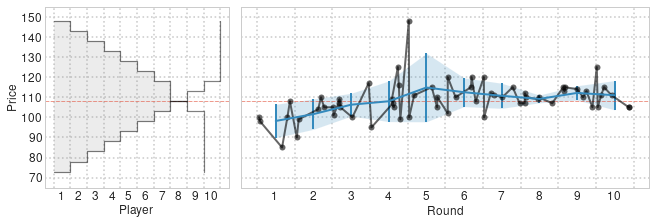

Black Box, First price, Regular 2


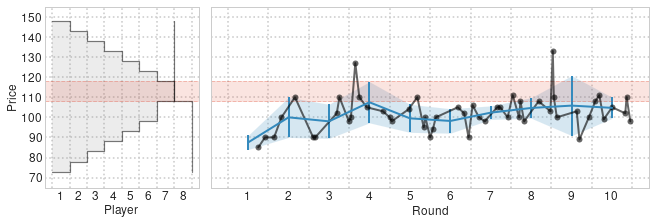

Black Box, First price, Regular 3


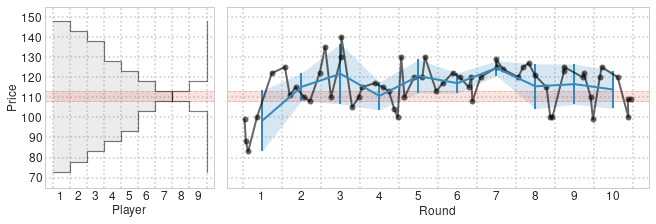

Black Box, First price, Regular 4


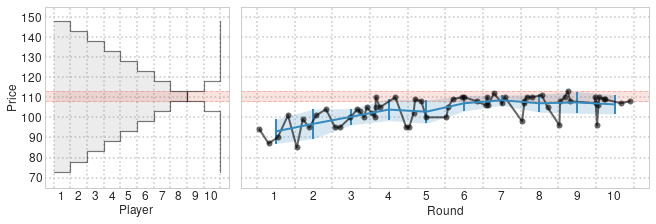

Black Box, First price, Regular 5


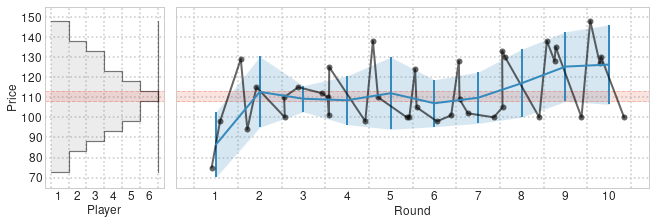

Black Box, First price, Large CE 1


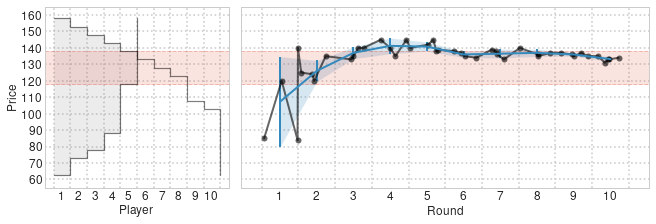

Black Box, First price, Large CE 2


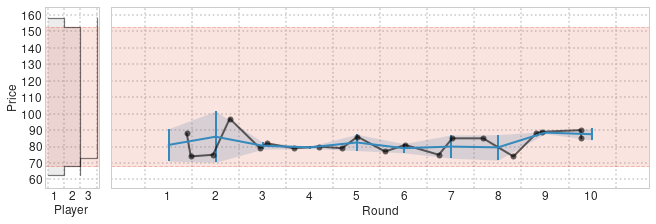

Black Box, First price, Large CE 3


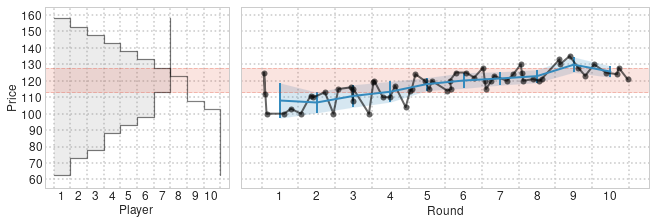

Black Box, First price, Large CE 4


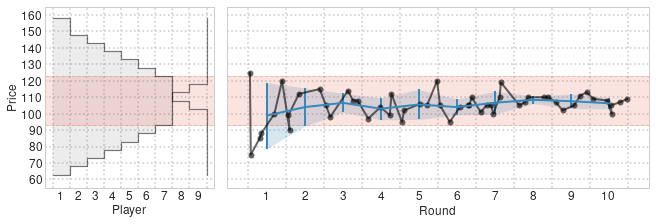

Black Box, First price, Large CE 5


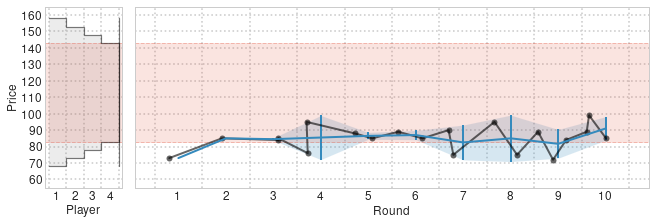

Black Box, First price, Large CE 6


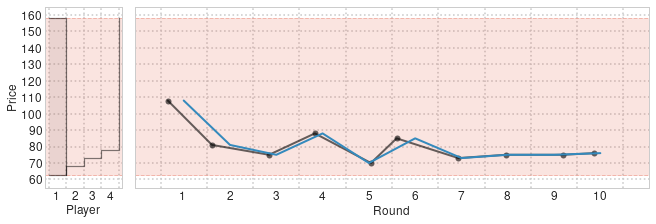

Black Box, First price, Large CE 7


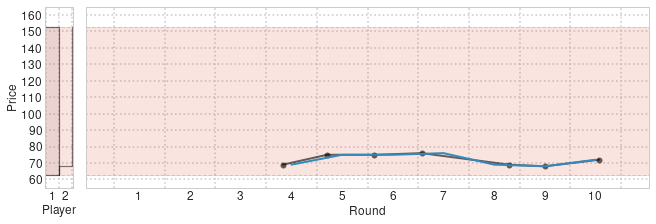

Black Box, First price, Large CE 8


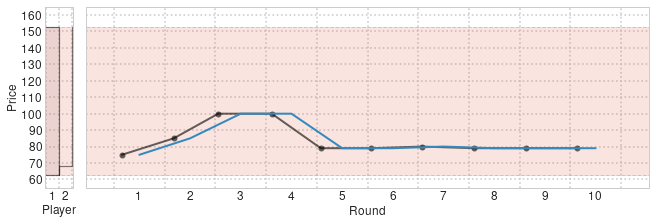

Black Box, Matchmaker keeps, Regular 1


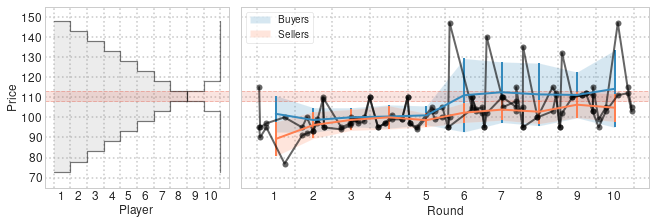

Black Box, Matchmaker keeps, Regular 2


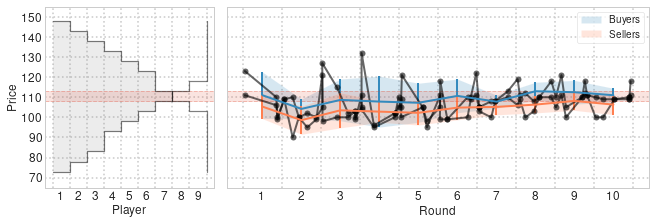

Black Box, Matchmaker keeps, Regular 3


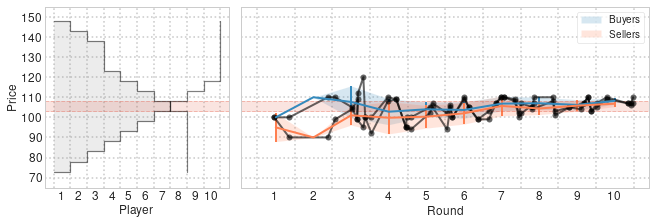

Black Box, Matchmaker keeps, Regular 4


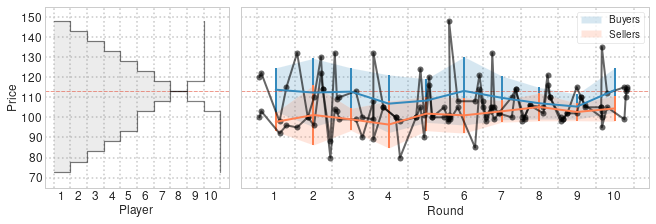

Black Box, Matchmaker keeps, Regular 5


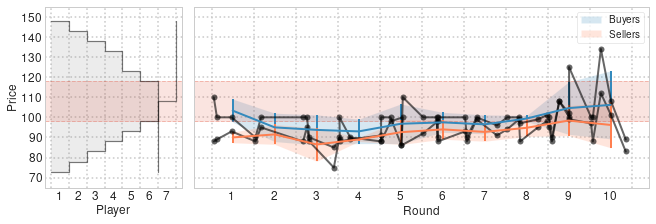

Black Box, First price, More buyers 1


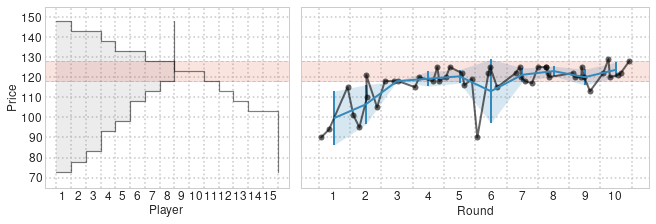

Black Box, First price, More buyers 2


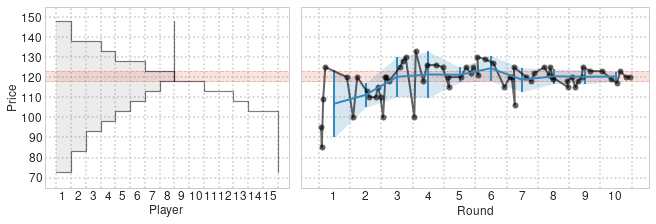

Black Box, First price, More buyers 3


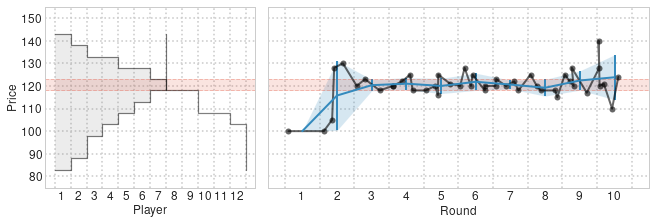

Black Box, First price, More buyers 4


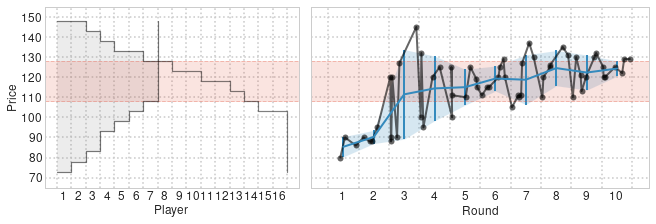

Black Box, First price, More buyers 5


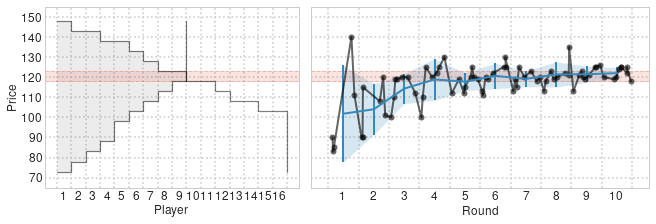

Black Box, First price, More rounds 1


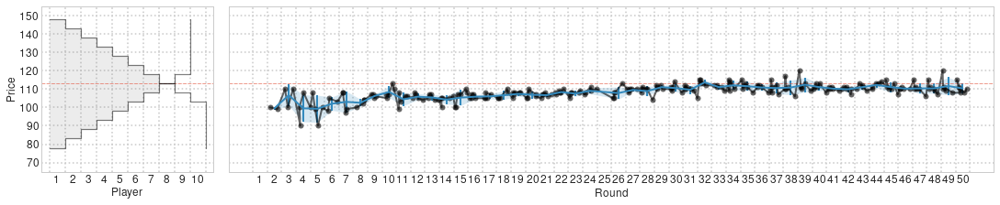

Black Box, First price, More rounds 2


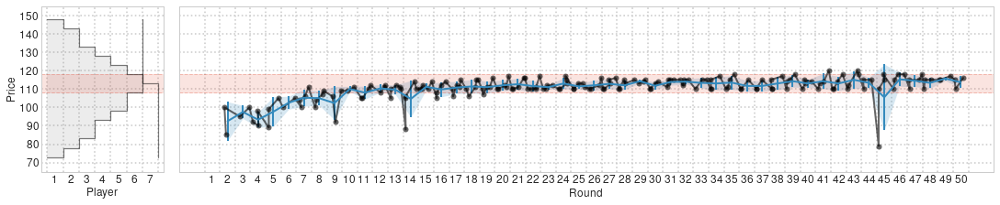

Black Box, First price, More rounds 3


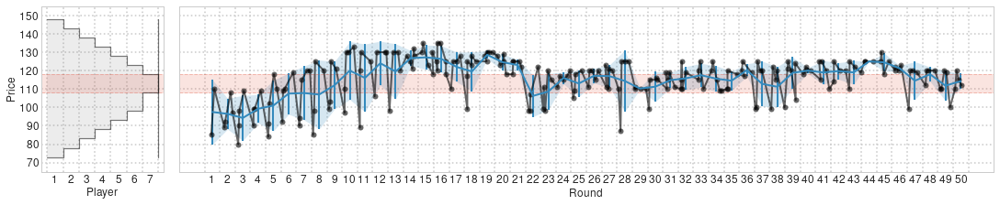

Black Box, First price, More rounds 4


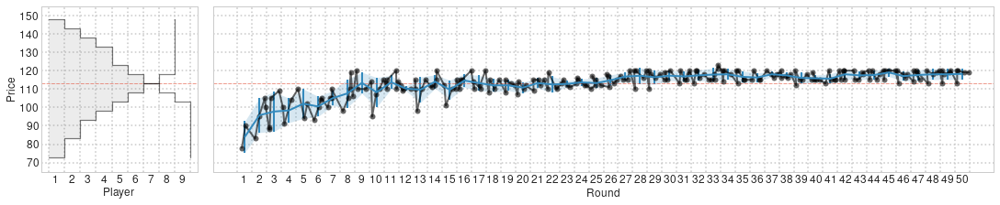

Black Box, First price, More rounds 5


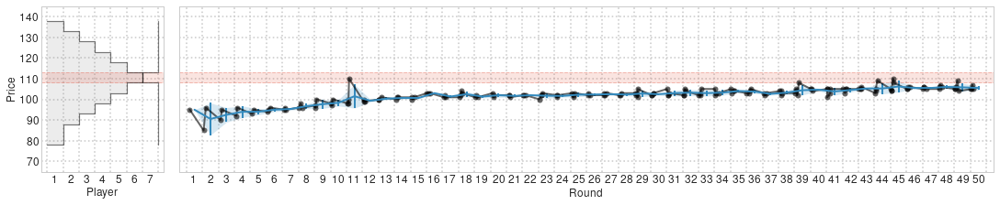

Black Box, First price, More sellers 1


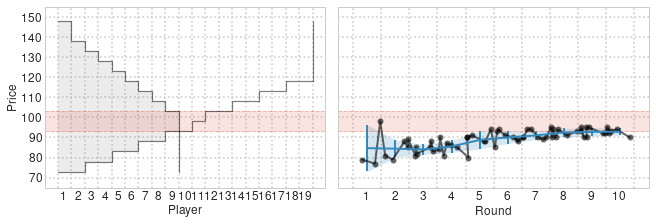

Black Box, First price, More sellers 2


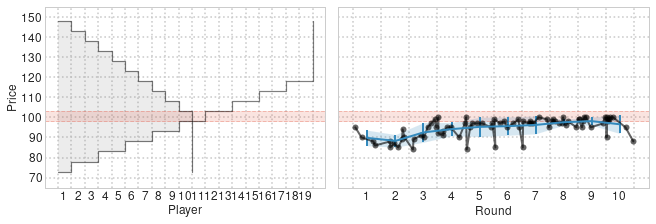

Black Box, First price, More sellers 3


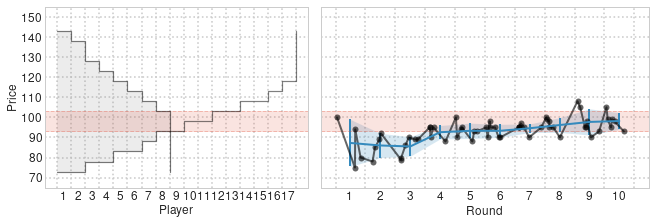

Black Box, First price, More sellers 4


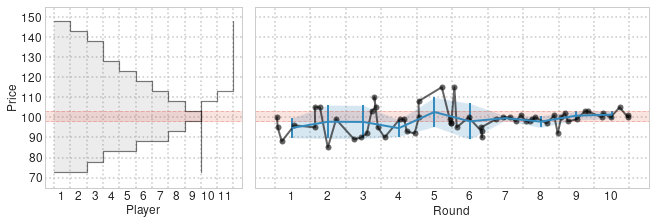

Black Box, First price, More sellers 5


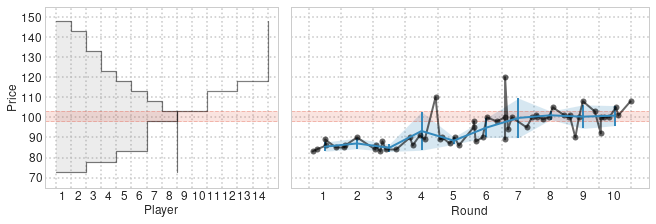

Black Box, Random price, Regular 1


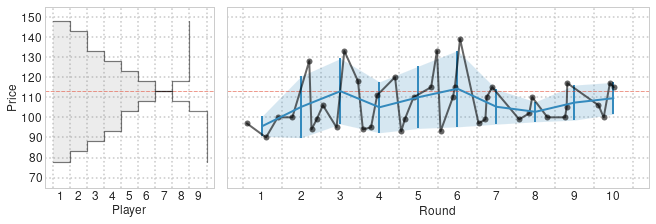

Black Box, Random price, Regular 2


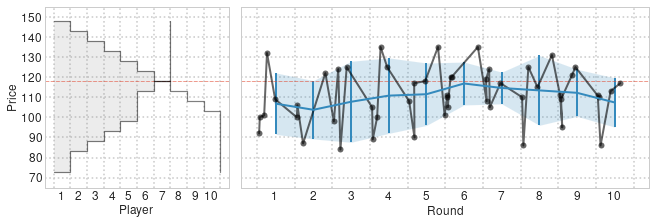

Black Box, Random price, Regular 3


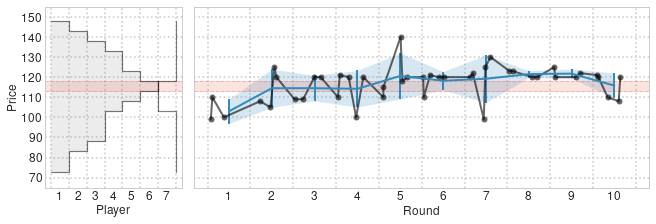

Black Box, Random price, Regular 4


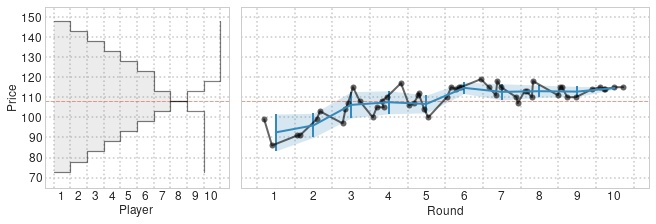

Black Box, Random price, Regular 5


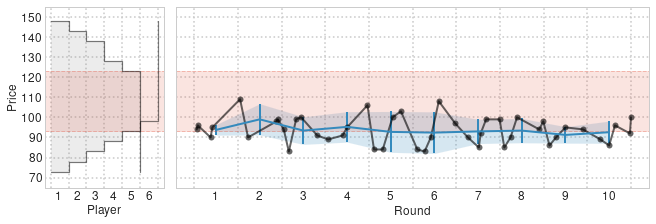

Private Information, First price, Regular 1


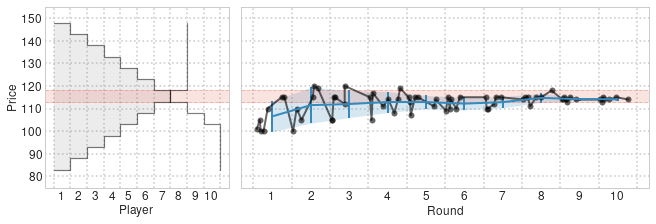

Private Information, First price, Regular 2


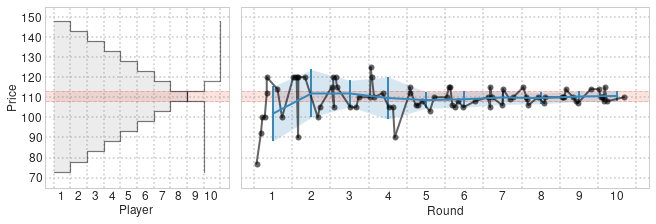

Private Information, First price, Regular 3


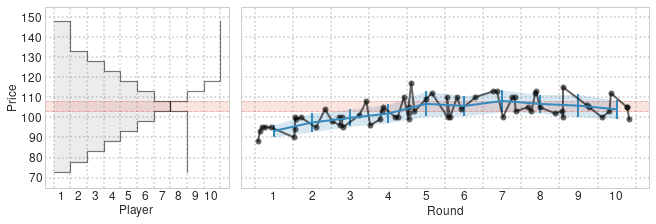

Private Information, First price, Regular 4


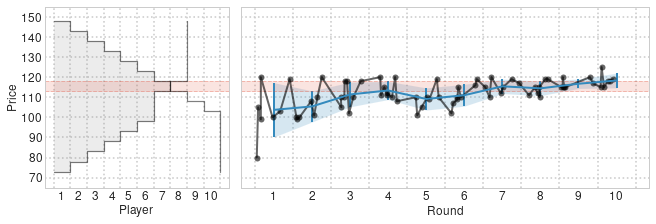

Private Information, First price, From buyers to sellers 1


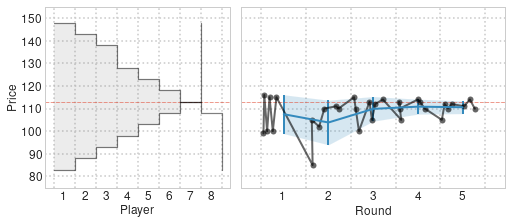

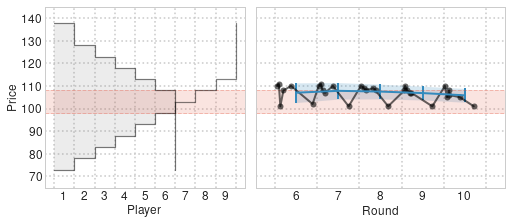

Private Information, First price, From buyers to sellers 2


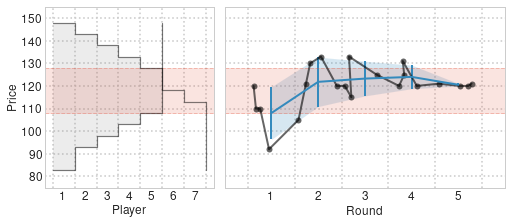

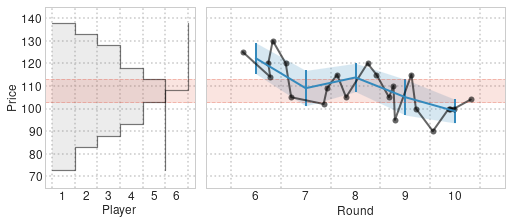

Private Information, First price, From buyers to sellers 3


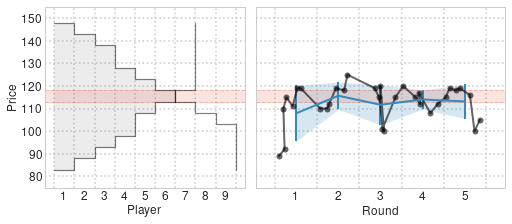

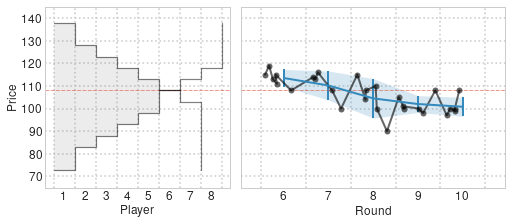

Private Information, First price, From buyers to sellers 4


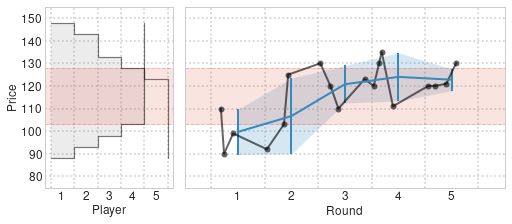

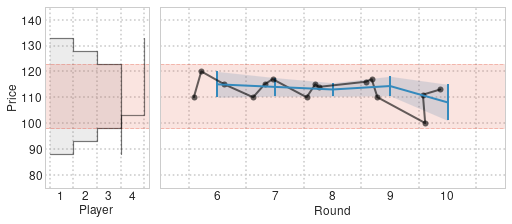

Private Information, First price, From buyers to sellers 5


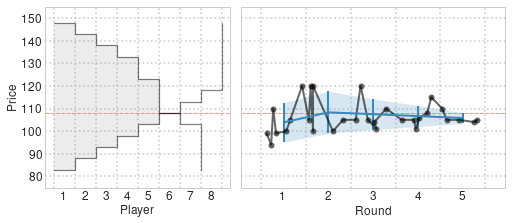

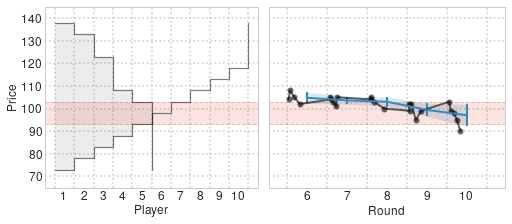

Private Information, First price, From sellers to buyers 1


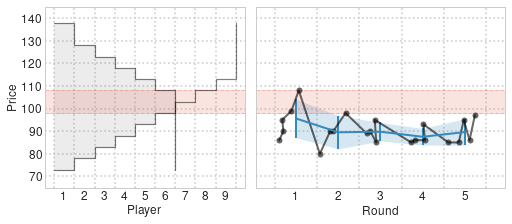

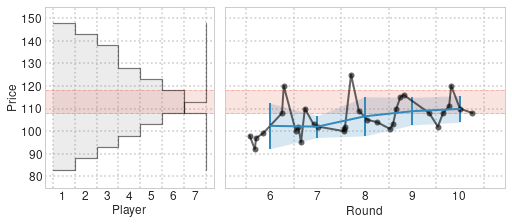

Private Information, First price, From sellers to buyers 2


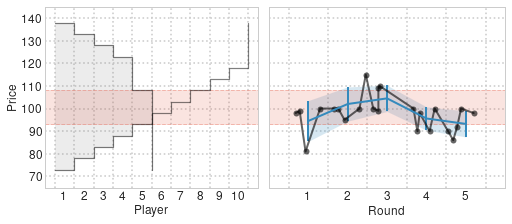

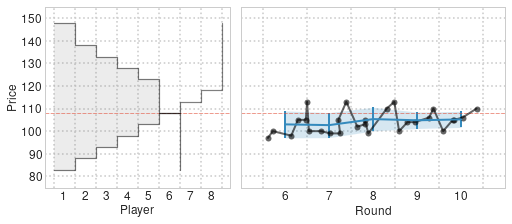

Private Information, First price, From sellers to buyers 3


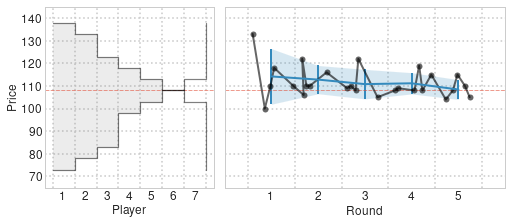

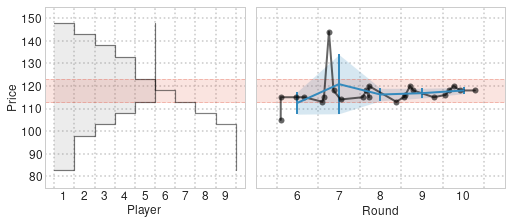

Private Information, First price, From sellers to buyers 4


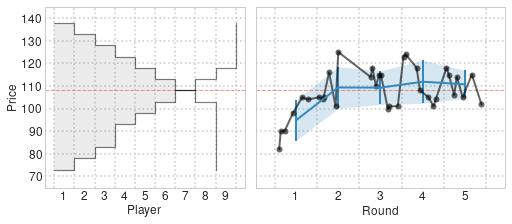

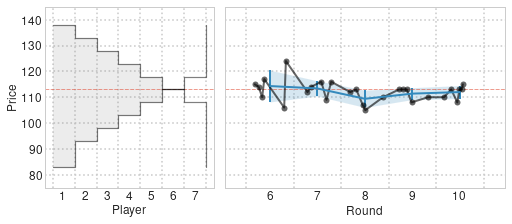

Private Information, First price, From sellers to buyers 5


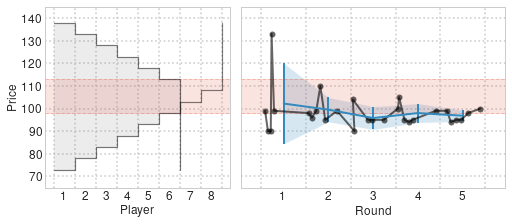

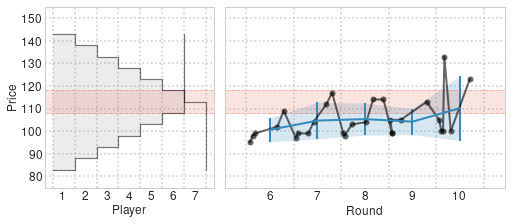

Private Information, First price, Large CE 1


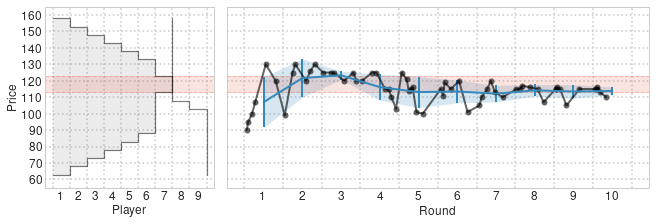

Private Information, First price, Large CE 2


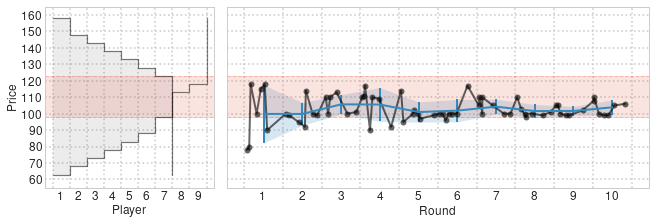

Private Information, First price, Large CE 3


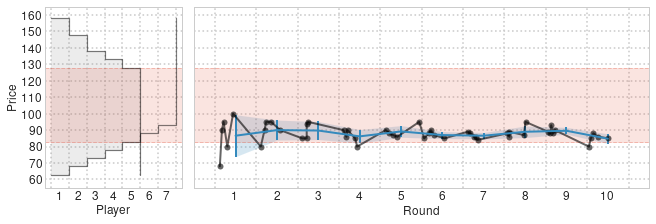

Private Information, First price, Large CE 4


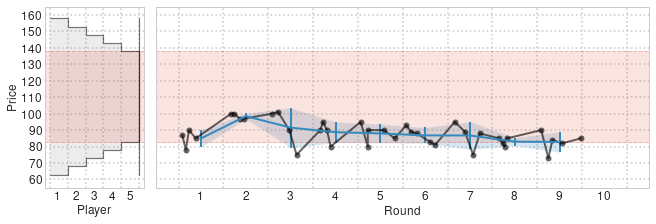

Private Information, First price, Large CE 5


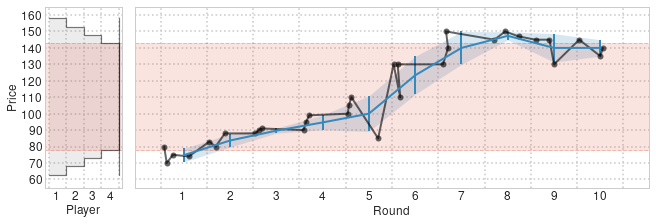

Private Information, First price, Large CE 6


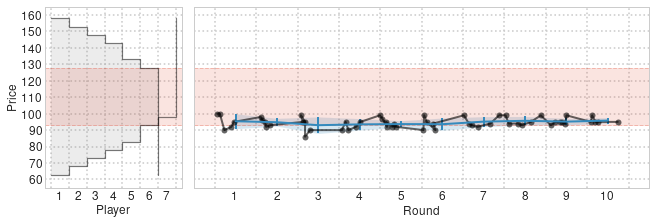

Private Information, First price, Large CE 7


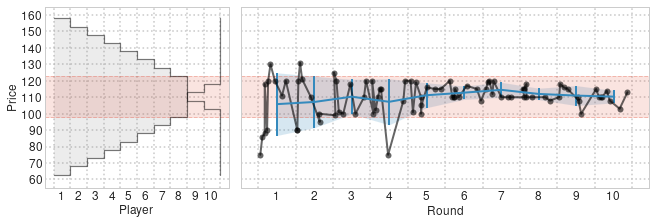

Private Information, First price, Large CE 8


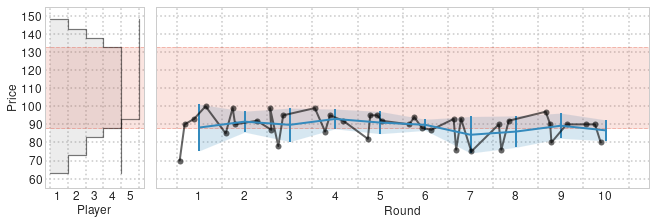

Private Information, First price, More buyers 1


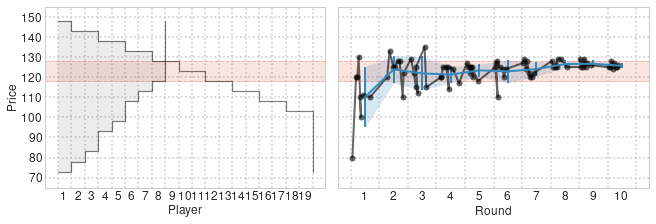

Private Information, First price, More buyers 2


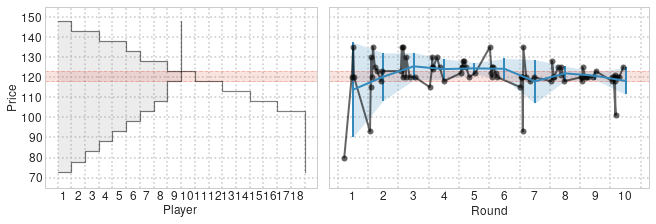

Private Information, First price, More buyers 3


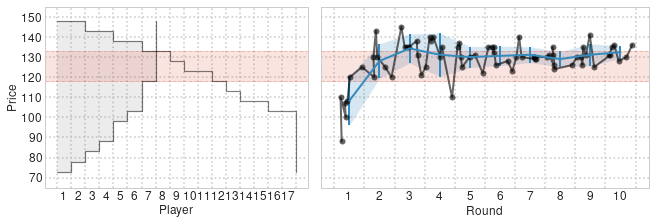

Private Information, First price, More buyers 4


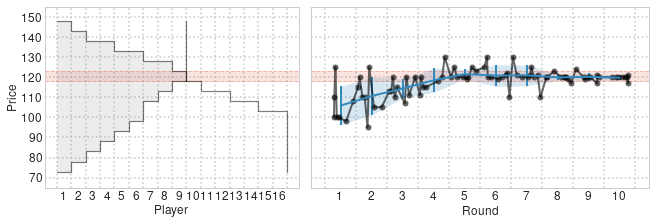

Private Information, First price, More buyers 5


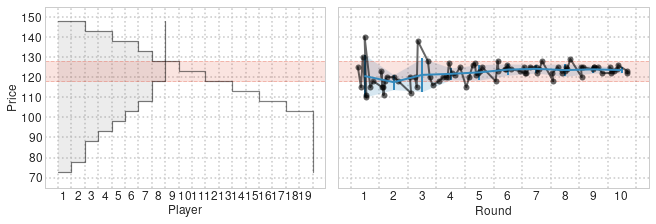

Private Information, First price, More sellers 1


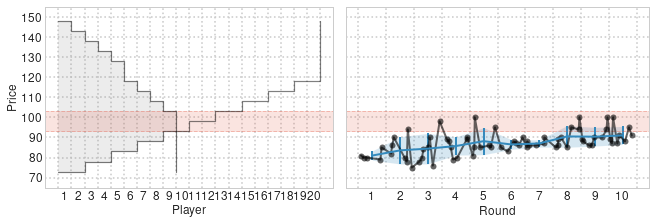

Private Information, First price, More sellers 2


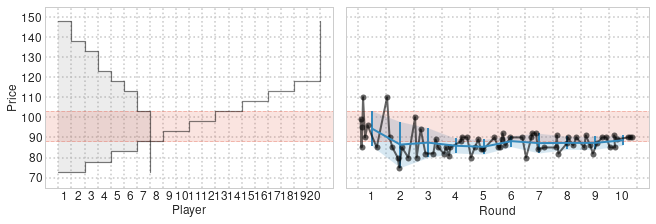

Private Information, First price, More sellers 3


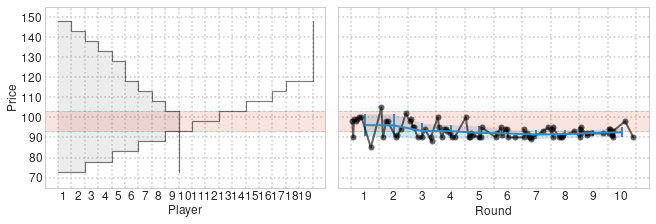

Private Information, First price, More sellers 4


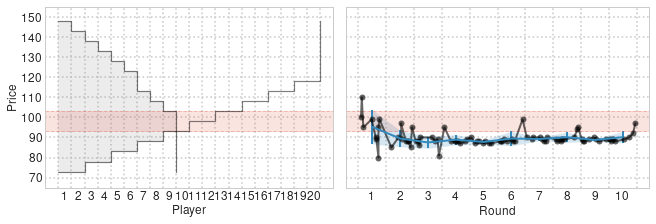

Private Information, First price, More sellers 5


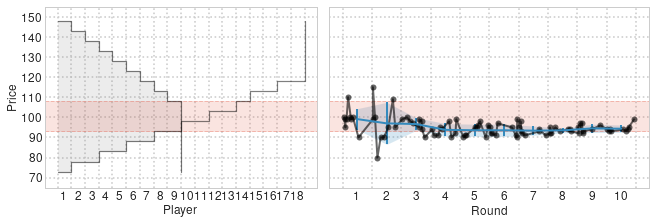

Private Information, First price, Seller shift 1


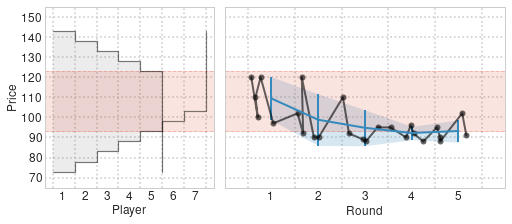

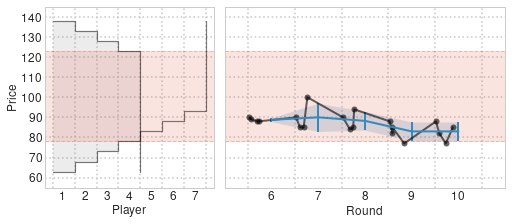

Private Information, First price, Seller shift 2


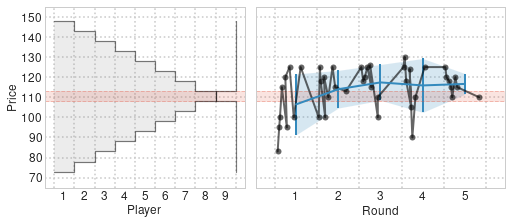

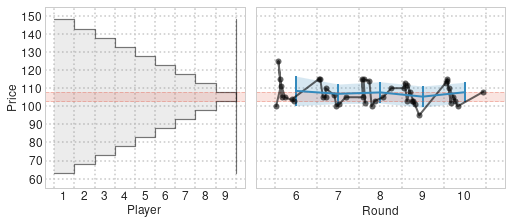

Private Information, First price, Seller shift 3


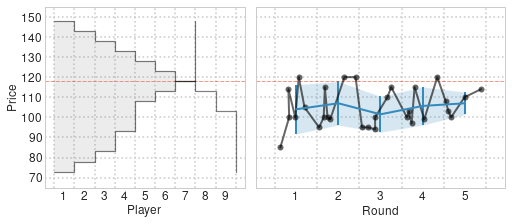

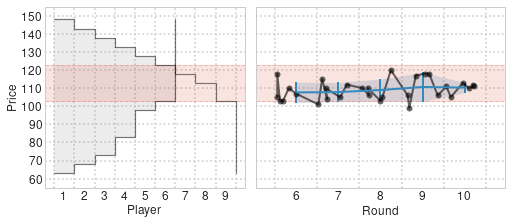

Private Information, First price, Seller shift 4


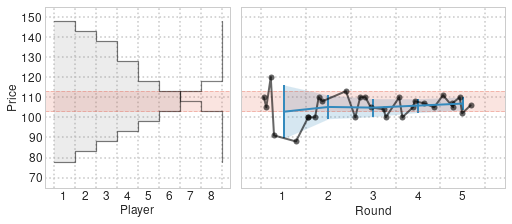

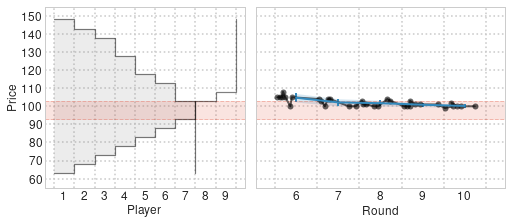

Private Information, First price, Seller shift 5


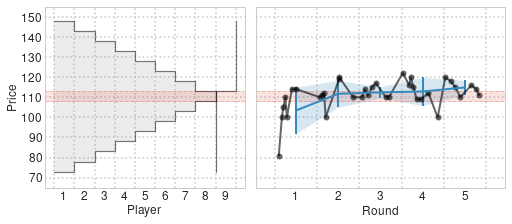

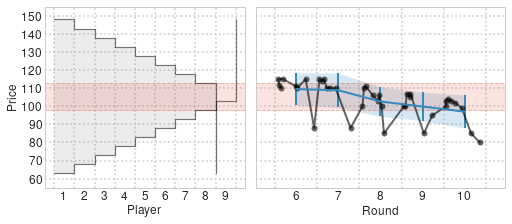

Other-side, First price, Regular 1


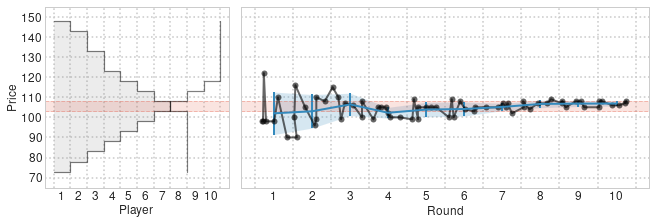

Other-side, First price, Regular 2


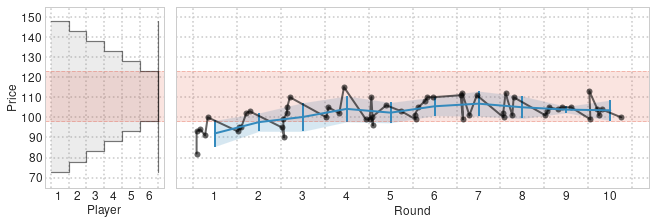

Other-side, First price, Regular 3


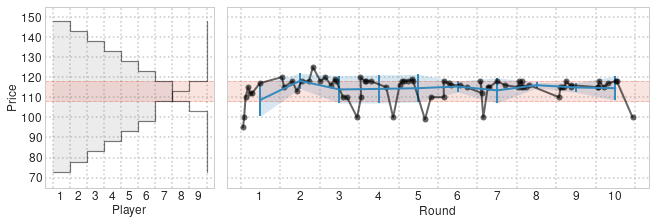

Other-side, First price, Regular 4


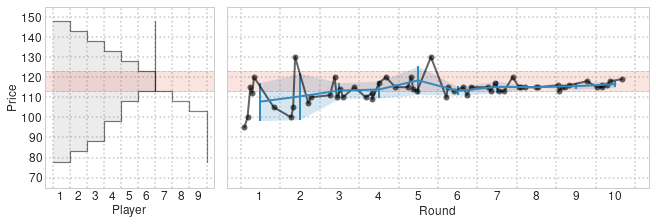

Other-side, First price, Regular 5


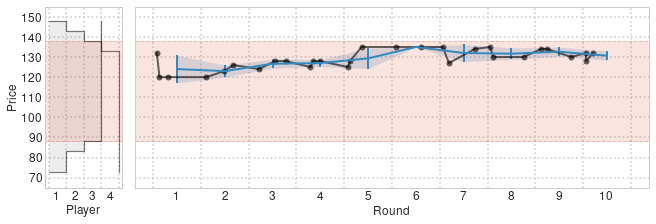

Same-side, First price, Regular 1


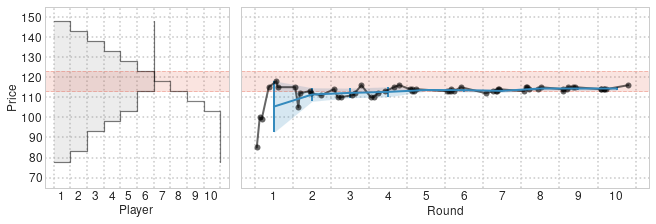

Same-side, First price, Regular 2


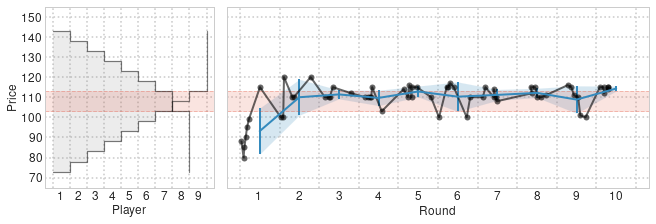

Same-side, First price, Regular 3


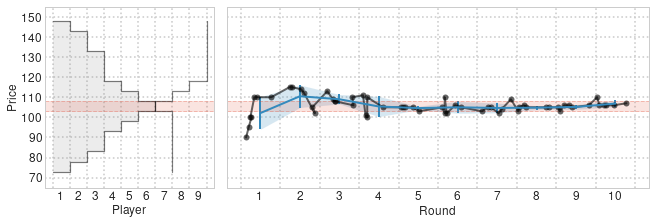

Same-side, First price, Regular 4


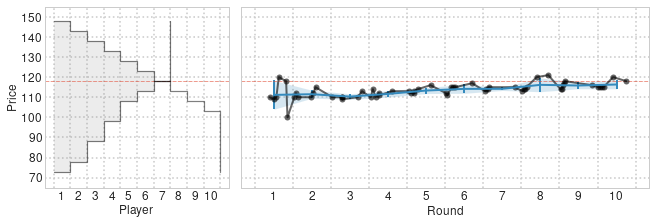

Same-side, First price, Regular 5


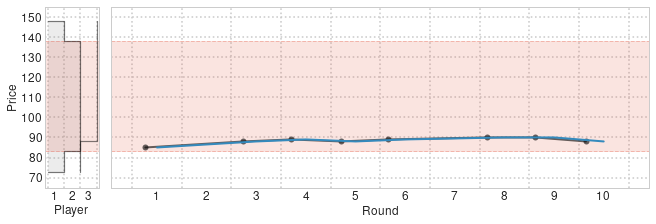

Same-side, Matchmaker keeps, Regular 1


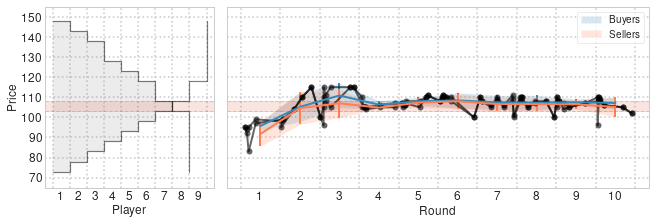

Same-side, Matchmaker keeps, Regular 2


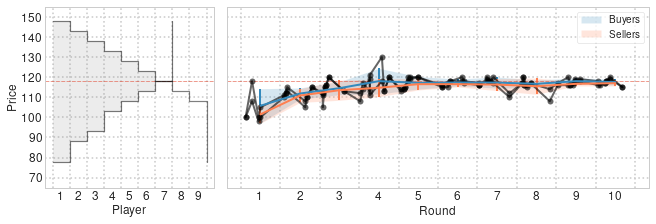

Same-side, Matchmaker keeps, Regular 3


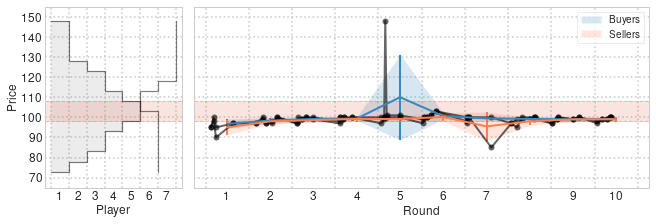

Same-side, Matchmaker keeps, Regular 4


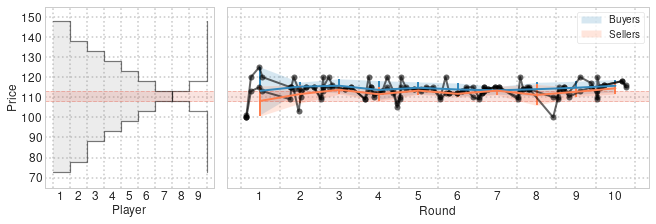

In [19]:
for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    print(treatment_names[treatment], game)
    figures = plot_session(treatment, game)
    _ = plt.show()

#### Black Box versus non-Black Box

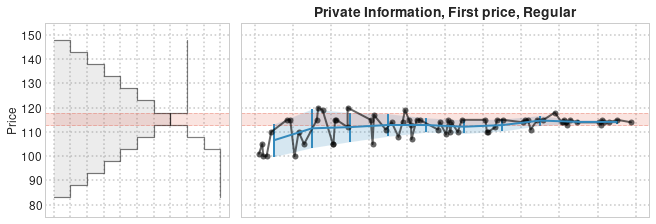

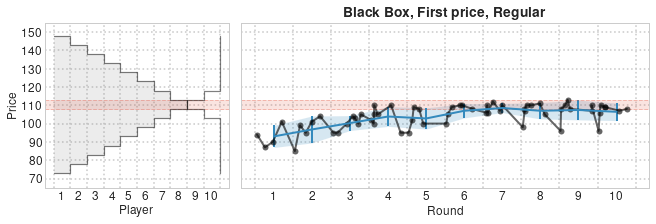

In [20]:
plot_session('Full', 1)
fig = session_plots[0]
for ax in fig.axes:
    _ = ax.get_xaxis().set_ticks([])
    _ = ax.set_xlabel('')
_ = fig.axes[1].set_title(bold_text(treatment_names['Full']))
_ = plt.savefig('Figures/Paper/ExampleSession_PI_G1.pdf', bbox_inches='tight')

plot_session('BB', 4)
_ = plt.title(bold_text(treatment_names['BB']))
_ = plt.savefig('Figures/Paper/ExampleSession_BB_G4.pdf', bbox_inches='tight')

### Comparison across treatments

_Convergence to CE_: signed distance between realised prices and closest equilibrium. The panels show the realised price averages with a one-standard-deviation interval around the average per round.

_Allocative efficiency_: allocative efficiency, i.e., the realised gains of trade as the percentage of the maximum attained by competitive equilibrium. The panels show the average realised efficiency with an interval indicating the least and the most efficient markets around it.

**Note**: all market sessions subject to the treatment under consideration and _per-round_ CE ranges are taken into account

In [21]:
def distances_to_EPR(df, treatment, game, rnd):
    [epr1, epr2] = EPR_rounds[treatment, game, rnd]
    prices = df['price'].dropna()

    distances = []
    
    for price in prices:    
        if price > epr2:
            distances.append(price - epr2)
        elif price < epr1:
            distances.append(price - epr1)
        else:
            distances.append(0)
    
    return distances

def allocative_efficiency(df, treatment, game, rnd):
    GOT = GOT_rounds[treatment, game, rnd]
    realised_vals = get_valuations(df[df['price'].notna()])
    
    return (sum(realised_vals.get('Buyer', [])) - sum(realised_vals.get('Seller', [])))/GOT

def mean_evolution(ax, df, fun, errorbar_type, alpha=0.2, **kwargs):
    means = []
    kwargs_fun = kwargs.get('extra_params', {})
    
    if errorbar_type == 'sdev':
        sdevs = []
    elif errorbar_type == 'minmax':
        lower_bounds = []
        upper_bounds = []
    
    for rnd, df_round in df.groupby(['round']):
        yvals = []
        
        for (treatment, game), df_game in df_round.groupby(['treatment', 'game']):
            yvals.append(fun(df_game, treatment, game, rnd, **kwargs_fun))
    
        yvals = list(flatten_list(yvals))
        means.append(np.nanmean(yvals))

        if errorbar_type == 'sdev':
            sdevs.append(np.nanstd(yvals))
        elif errorbar_type == 'minmax':
            lower_bounds.append(np.nanmean(yvals) - min(yvals))
            upper_bounds.append(max(yvals) - np.nanmean(yvals))
    
    if errorbar_type == 'sdev':
        bars = sdevs
    elif errorbar_type == 'minmax':
        bars = np.vstack((lower_bounds, upper_bounds))
    
    colour = ecolor = facecolor = kwargs.get('colour')
    label = kwargs.get('label')
    
    rounds = range(1, len(means)+1)
    out = ax.errorbar(rounds, means, bars, 
                      color=colour, fmt='-o', ms=8, capsize=1, 
                      ecolor=colour, label='{}'.format(label))
    _ = ax.fill_between(rounds, out[1][0].get_data()[1], out[1][1].get_data()[1], 
                        alpha=alpha, facecolor=colour)

def treatment_subplot(ax, treatment, fun, errorbar_type):
    df_treatment = df[df['treatment'] == treatment]
    
    # Dynamic markets change after round 5
    if treatment in dynamic_treatments:
        _ = ax.axvline(x=5.5, linestyle='dashed', linewidth=2.0, color='darkgrey', alpha=0.8)

    # Distances to equilibrium price range
    if fun == distances_to_EPR:
        df_side = df_treatment[df_treatment['side'] == 'Buyer']   
        mean_evolution(ax, df_side, fun, errorbar_type, **{'colour': '#348ABD', 'label': 'Buyers'})

        # Equilibrium price ranges collapse to the line through the origin
        _ = ax.axhline(y=0, linestyle='solid', linewidth=5.0, color='darkgrey', alpha=0.8)
        
        if 'MMK' in treatment:
            df_side = df_treatment[df_treatment['side'] == 'Seller']
            mean_evolution(ax, df_side, fun, errorbar_type, **{'colour': 'darkmagenta', 'label': 'Seller'})
            _ = ax.legend(loc='lower right', fontsize=10)
        
        yticks = np.arange(-30,20,10)
        _ = ax.set_ylim(min(yticks)-5,max(yticks)+5)
    
    # Allocative efficiency
    elif fun == allocative_efficiency:
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': '#E24A33'})
        
        yticks = np.arange(0,1.1,0.2).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
        
    # Selten index
    elif fun == Selten_index:
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'aquamarine', 'label': 'CE area', 'extra_params': {'output': 'area'}})
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'turquoise', 'label': 'Hit rate', 'extra_params': {'output': 'hitRate'}})
        mean_evolution(ax, df_treatment, fun, errorbar_type, **{'colour': 'teal', 'label': 'Selten index', 'extra_params': {'output': 'SI'}})
    
        yticks = np.arange(-1,1.1,0.5).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
        _ = ax.legend(loc='lower right', fontsize=10)
    
    # Subplot layout
    if 'MoreRounds' in treatment:
        xticks = range(0,60,10)
    else:
        xticks = range(1,11)
        
    _ = ax.set_xticks(xticks)
    _ = ax.set_xticklabels(xticks, size=12)

    _ = ax.set_yticks(yticks)
    _ = ax.set_yticklabels(yticks, size=12)          

def emphasise_text(string, separator, part):
    new_string = string.split(separator)
    new_string[part] = bold_text(new_string[part])
    new_string = separator.join(new_string)
    return new_string
    
def treatment_grid(treatments, suptitle, bold_title_part, functions, **kwargs):
    factor = len(functions)
    (rows, columns) = np.shape(treatments)
    fig, ax = plt.subplots(rows*factor, columns, figsize=(14,2.5*rows*factor), 
                           sharex='col', sharey='row', constrained_layout=True, **kwargs)
    ax = ax.flatten()
    
    for idx, treatment in enumerate(flatten_list(treatments)):
        if idx >= 4:
            idx = idx+(factor-1)*columns
        
        for j, (fun, errorbar_type) in enumerate(functions):
            treatment_subplot(ax[idx+j*columns], treatment, fun, errorbar_type)
        
        title = emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part)
        title = title.replace('Private Information', 'Private Info')
        title = title.replace('From buyers to sellers', 'From B to S')
        title = title.replace('From sellers to buyers', 'From S to B')
        _ = ax[idx].set_title(title, fontsize=14)

    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
    
    return fig, ax

_Top_: convergence to CE\
_Bottom_: allocative efficiency

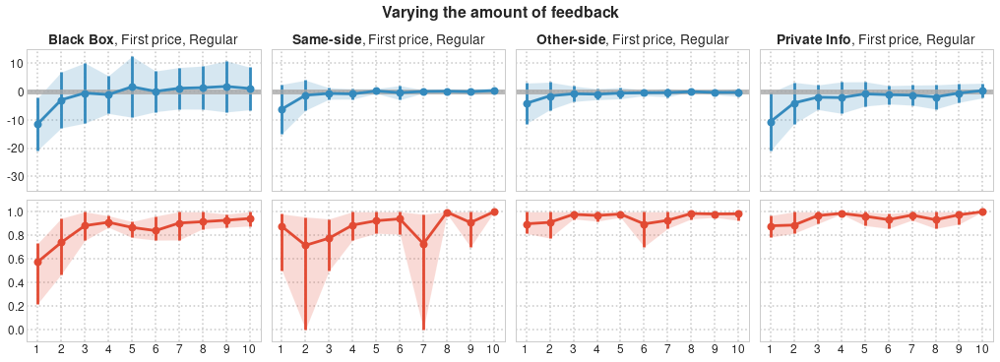

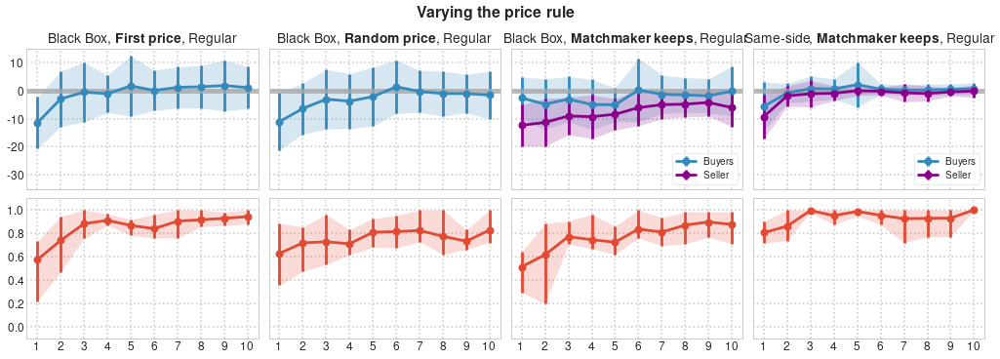

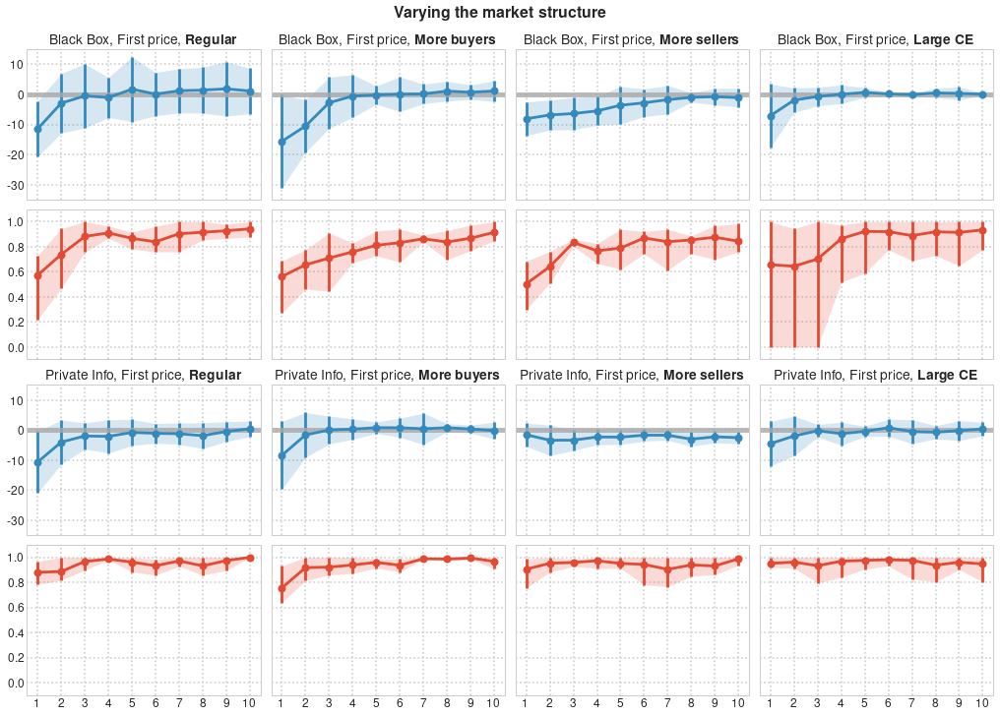

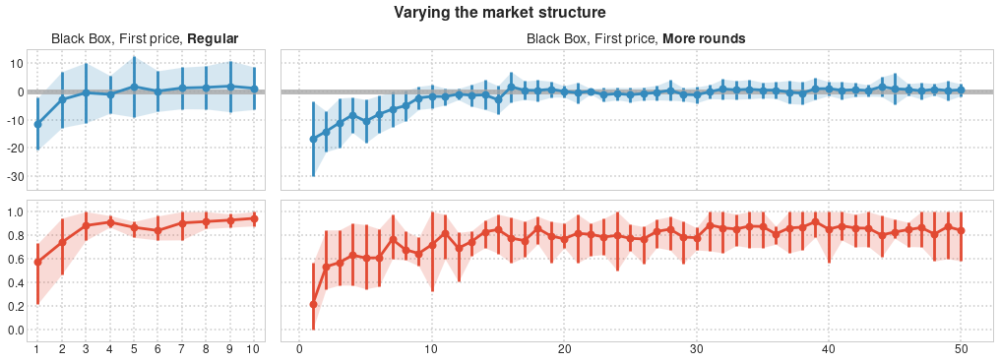

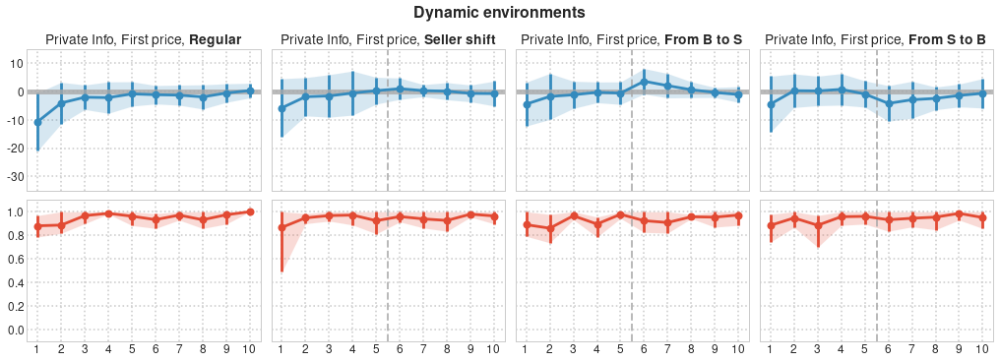

In [22]:
treatment_grid_arrangement = {'feedback': [['BB', 'Same', 'Other', 'Full']],
                              'price': [['BB', 'BBRandom', 'BBMMK', 'SameMMK']],
                              'structure_1': [['BB', 'BBMoreB', 'BBMoreS', 'BBLargeCE'], ['Full', 'FullMoreB', 'FullMoreS', 'FullLargeCE']],
                              'structure_2': [['BB', 'BBMoreRounds']],
                              'dynamics': [['Full', 'FullSShift', 'FullFromBtoS', 'FullFromStoB']]}

for key, treatments in treatment_grid_arrangement.items():
    dim = key.split('_')[0]
    
    suptitle = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
        
    if 'MoreRounds' in ' '.join(flatten_list(treatments)):
        kwargs = {'gridspec_kw': {'width_ratios': [1, 3]}} # reserve more space for the treatment with more periods
    else:
        kwargs = {}
    
    fig, ax = treatment_grid(treatments=treatments, suptitle=suptitle, bold_title_part=bold_title_part, functions=[(distances_to_EPR, 'sdev'), (allocative_efficiency, 'minmax')], **kwargs)

    _ = plt.savefig('Figures/EPR_AllEff_{}.pdf'.format(key), bbox_inches='tight')

#### Comparison across groups of treatments

In [23]:
def grid_layout(ax, fun):
    xticks = range(1,11)
    _ = ax.set_xticks(xticks)
    _ = ax.set_xticklabels(xticks, size=12)

    if fun == distances_to_EPR:
        # Equilibrium price ranges collapse to the line through the origin
        _ = ax.axhline(y=0, linestyle='solid', linewidth=5.0, color='darkgrey', alpha=0.8)

        yticks = np.arange(-30,20,10)
        _ = ax.set_ylim(min(yticks)-5,max(yticks)+5)

    elif fun == allocative_efficiency:
        yticks = np.arange(0,1.1,0.2).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)
    
    elif (fun == Selten_index) or (fun == Selten_eps3):
        yticks = np.arange(-1,1.1,0.5).round(1)
        _ = ax.set_ylim(min(yticks)-0.1,max(yticks)+0.1)        
    
    _ = ax.set_yticks(yticks)
    _ = ax.set_yticklabels(yticks, size=12)

def treatment_grid_combined(treatments, fun, errorbar_type, colours):
    def treatment_subplot(ax):
        df_treatment = df[df['treatment'] == treatment].copy()
        label = treatment_names[treatment]

        if 'MoreRounds' in treatment:
            ax2 = ax.twiny() # add an additional x-axis on top
            ax.set_zorder(1)
            ax.patch.set_visible(False)
            
            mean_evolution(ax2, df_treatment, fun, errorbar_type, alpha=0.1,
                           **{'colour': colours[j], 'label': label})

            xticks = np.arange(0,51,10)
            _ = ax2.set_xticks(xticks)
            _ = ax2.set_xticklabels(xticks, fontsize=12)
            _ = ax2.tick_params(axis='x', colors=colours[j])
                        
            handles, labels = ax.get_legend_handles_labels()
            handles2, labels2 = ax2.get_legend_handles_labels()
            handles.extend(handles2)
            labels.extend(labels2)
            
            _ = ax2.legend(handles, labels, loc='lower right', fontsize=10)
        else:
            mean_evolution(ax, df_treatment, fun, errorbar_type, alpha=0.1,
                           **{'colour': colours[j], 'label': label})

            if idx != 5:
                _ = ax.legend(loc='lower right', fontsize=10)
            else:
                _ = ax.tick_params(axis='x', colors=colours[j])
        
        grid_layout(ax, fun)
 
    fig, ax = plt.subplots(2,3, figsize=(14,2.5*2), 
                           sharey='row', constrained_layout=True)
    ax = ax.flatten()
    
    for idx, ((title, ylabel), treatment_list) in enumerate(treatments.items()):
        for j, treatment in enumerate(treatment_list): # j iterates through colours
            treatment_subplot(ax[idx])
            _ = ax[idx].set_title(bold_text(title), fontsize=14)
            _ = ax[idx].set_ylabel(bold_text(ylabel), fontsize=14)

**Convergence to CE**

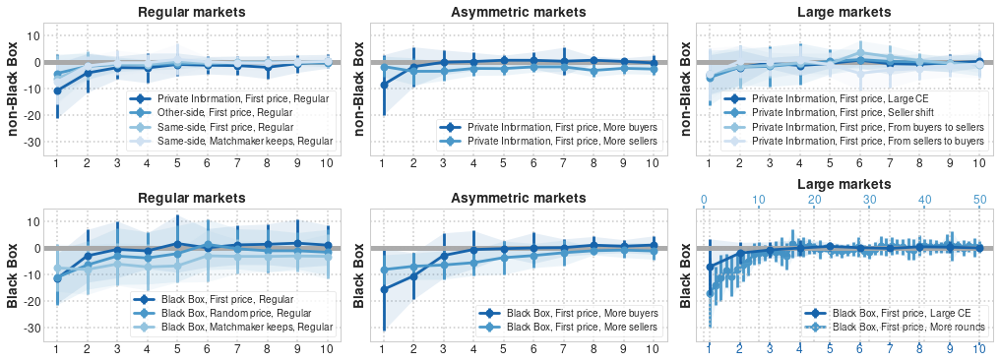

In [24]:
treatment_grid_combined(treatment_groups, distances_to_EPR, 'sdev', blue_palette)
_ = plt.savefig('Figures/Paper/CE_convergence.pdf', bbox_inches='tight')

**Allocative efficiency**

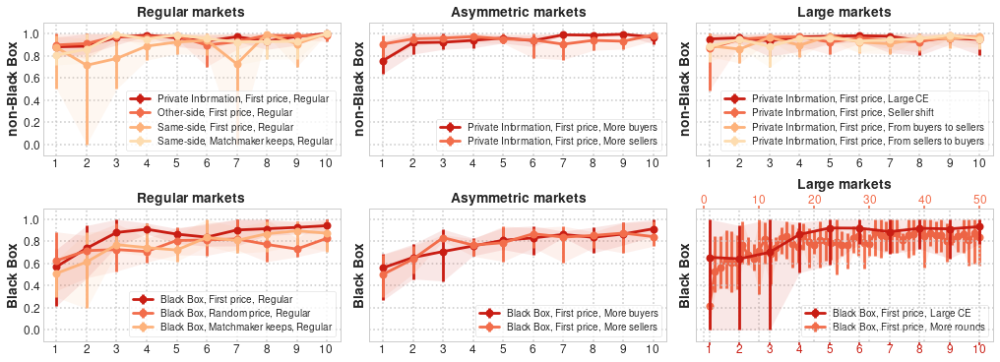

In [25]:
treatment_grid_combined(treatment_groups, allocative_efficiency, 'minmax', red_palette)
_ = plt.savefig('Figures/Paper/Allocative_efficiency.pdf', bbox_inches='tight')

#### Black Box versus non-Black Box

_Left_: convergence to CE\
_Right_: allocative efficiency

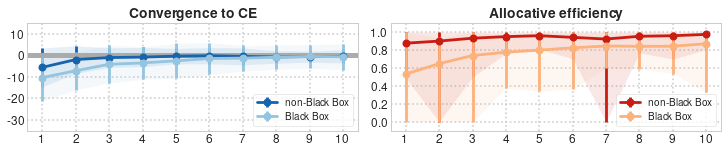

In [26]:
fig, ax = plt.subplots(1,2, figsize=(10,2), sharex=True, constrained_layout=True)

df10 = df[df['round'] <= 10].copy()

df10_BB = df10[df10['treatment'].isin(BB_treatments)]
df10_nonBB = df10[~df10['treatment'].isin(BB_treatments)]

rows = [('non-Black Box', df10_nonBB, 0), ('Black Box', df10_BB, 2)]
cols = [(0, distances_to_EPR, 'sdev', blue_palette, 'Convergence to CE'),
        (1, allocative_efficiency, 'minmax', red_palette, 'Allocative efficiency')]

for (label, data, colour_id) in rows:
    for (col, fun, errorbar_type, palette, title) in cols:
        mean_evolution(ax[col], data, fun, errorbar_type, alpha=0.1,
                       **{'colour': palette[colour_id], 'label': label})
        grid_layout(ax[col], fun) 
        _ = ax[col].legend(loc='lower right', fontsize=10)
        _ = ax[col].set_title(bold_text(title), fontsize=14)

_ = plt.savefig('Figures/Paper/AllMarkets_CE_AE.pdf', bbox_inches='tight')

### Statistical tests

Aggregate the (mean/first) per-round <span style='color:#DB5461'>signed distances to CE</span> and the per-round <span style='color:#DB5461'>allocative efficiency</span> over all experimental sessions (for rounds 1 to 10)

In [27]:
all_distances = dict()
first_distances = dict()
mean_distances = dict()
allocative_efficiencies = dict()

for rnd in range(1, 11):
    all_distances[rnd] = []
    first_distances[rnd] = []
    mean_distances[rnd] = []
    allocative_efficiencies[rnd] = []
    
    for (treatment, game), df_game in df[df['round'] == rnd].groupby(['treatment', 'game']):
        distances = distances_to_EPR(df_game, treatment, game, rnd)
        all_distances[rnd].extend(distances)
        
        if len(distances) > 0:
            first_distances[rnd].append(distances[0])
            mean_distances[rnd].append(np.nanmean(distances))
        
        allocative_efficiencies[rnd].append(allocative_efficiency(df_game, treatment, game, rnd))
        
convergence_metrics = {'All distances': all_distances,
                       'First distances': first_distances,
                       'Mean per-treatment distances': mean_distances,
                       'Allocative efficiency': allocative_efficiencies}

Inspect the (mean/first) distance distribution and the distribution of the allocative efficiency over time

Skewness,All distances,First distances,Mean per-treatment distances,Allocative efficiency
Round,,,,
1,-0.694307,-0.326645,-0.757264,-1.12326
2,-0.629402,-0.143177,-0.6192,-1.65902
3,-0.252718,0.00253314,-0.520361,-1.94979
4,-0.628395,-0.365746,-1.23557,-1.2938
5,0.180166,1.09254,-0.851677,-1.63087
6,0.321839,-1.17263,-0.903071,-1.68327
7,-0.110732,-0.199361,0.955042,-3.22152
8,-0.74124,-1.33185,-0.0755104,-1.2624
9,0.0503907,1.44245,0.726681,-1.44623


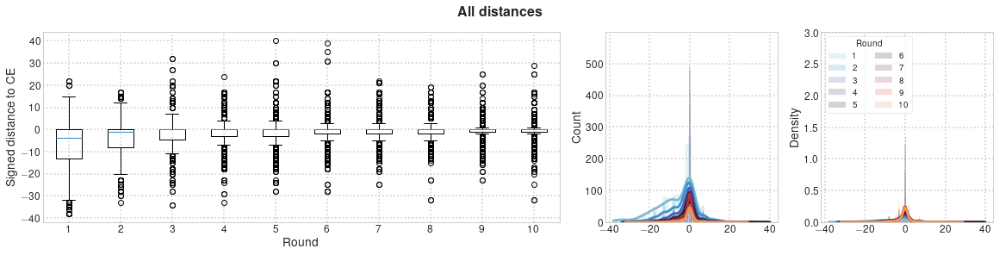

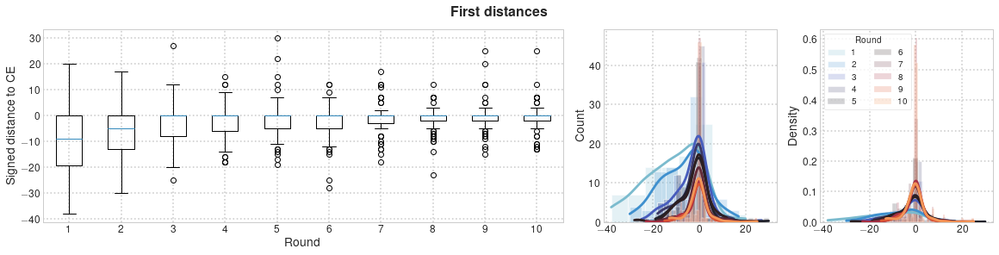

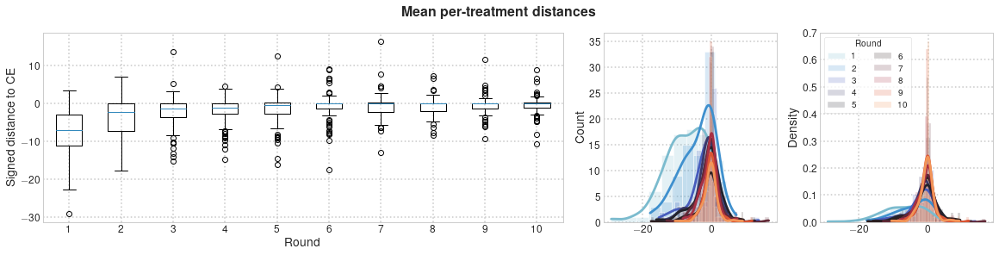

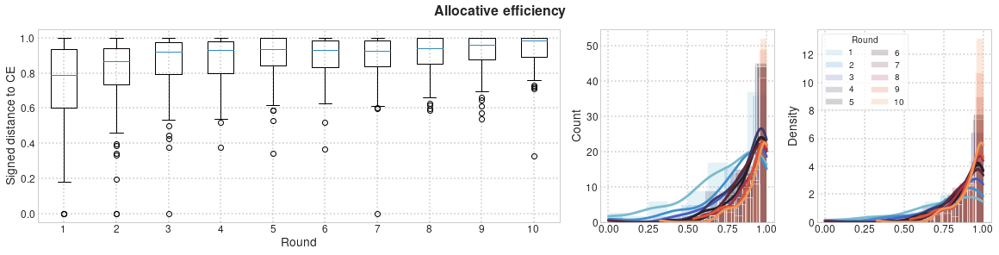

In [28]:
# Skewness
index = pd.Index(range(1,11), name='Round')
columns = pd.Index(convergence_metrics.keys(), name='Skewness')
skewness = pd.DataFrame(index=index, columns=columns)

# Boxplots, histograms, and kernel density estimates
for idx, vals in enumerate(convergence_metrics.values()):
    fig, ax = plt.subplots(1,3, figsize=(16,4), constrained_layout=True, gridspec_kw={'width_ratios':[3,1,1]})
    _ = plt.suptitle(bold_text(columns[idx]))
    palette = itertools.cycle(sns.color_palette('icefire', 10))
    
    _ = ax[0].boxplot(list(vals.values()), positions=list(vals.keys()))
    _ = ax[0].set_xlabel('Round')
    _ = ax[0].set_ylabel('Signed distance to CE')
 
    for rnd in range(1,11):
        colour = next(palette)
        _ = sns.histplot(vals[rnd], kde=True, stat='count', ax=ax[1], alpha=0.2, color=colour, label=rnd)
        _ = sns.histplot(vals[rnd], kde=True, stat='density', ax=ax[2], alpha=0.2, color=colour, label=rnd)

        skewness.loc[rnd, columns[idx]] = stats.skew(vals[rnd])
        
    _ = ax[2].legend(title='Round', ncol=2, loc='upper left')

skewness

**Wilcoxon signed-rank test** ([```Scipy``` documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.wilcoxon.html))
- Applies to _symmetric_ continuous distributions (when the distribution is symmetric, the median and the mean are equal)
- The null hypothesis is that the data is symmetrically distributed around the hypothesised median. A small $p$-value means that the null hypothesis is rejected, i.e., that there is evidence against this, which may be because the distribution is not centered at the median, or because it is asymmetric (see [discussion](https://stats.stackexchange.com/questions/332469/symmetry-assumption-in-wilcoxons-signed-rank-test)).

In [29]:
def Wilcoxon_rounds(agg_level, alternative, mu0):
    index = pd.Index(range(1,11), name='Round')
    metrics = ['Mean', 'Median', 'Sample size', r'$p$-value']
    columns = pd.MultiIndex.from_product([agg_level, metrics])
    results = pd.DataFrame(index=index, columns=columns)

    for idx, vals_dict in enumerate([convergence_metrics[l] for l in agg_level]):
        for rnd, vals in vals_dict.items():
            results.loc[rnd, (agg_level[idx], 'Mean')] = np.mean(vals)
            results.loc[rnd, (agg_level[idx], 'Median')] = np.median(vals)
            results.loc[rnd, (agg_level[idx], 'Sample size')] = len(vals)
            
            vals = [v-mu0 for v in vals]
            w, p = stats.wilcoxon(vals, alternative=alternative, zero_method='pratt')
            results.loc[rnd, (agg_level[idx], r'$p$-value')] = p
    
    return results

Below, the distribution of the (mean) per-session signed distance to the CE range is considered for each round $r \in [1, 10]$ separately.

One-sided tests are used to test:
- $H_0: \mu \geq 0$ against $H_1 : \mu < 0$ (```alternative == 'less'```);
- $H_0: \mu \leq - \varepsilon$ against $H_1 : \mu > -\varepsilon$ for $\varepsilon > 0$ (```alternative == 'greater'```).

In [30]:
printmd(r'**Test 1**: $\mu$ bounded from above by 0')

agg_level = ['All distances', 'First distances', 'Mean per-treatment distances']
Wilcoxon_rounds(agg_level, 'less', 0)

**Test 1**: $\mu$ bounded from above by 0

All distances                                 First distances         \
               Mean Median Sample size    $p$-value            Mean Median   
Round                                                                        
1          -6.82203     -4         826  2.09446e-68        -11.4651     -9   
2          -3.55066     -1         908  3.19914e-41        -6.85057     -5   
3          -2.10164      0         974  5.46659e-27        -3.19318      0   
4          -1.71283      0         982  1.03026e-24        -2.57303      0   
5          -1.12298      0         992  4.01579e-13        -1.80899      0   
6         -0.601815      0         992  0.000680999        -2.17978      0   
7         -0.750501      0         998  5.21581e-08       -0.772727      0   
8          -0.75502      0         996  1.04053e-11        -1.14607      0   
9          -0.49498      0         996  3.68195e-08       -0.382022      0   
10        -0.513834      0        1012  9.44348e-05       -0.659091      0   

                               Mean per-treatment distances            \
      Sample size    $p$-value                         Mean    Median   
Round                                                                   
1              86  4.91207e-12                     -7.38481  -6.92857   
2              87  7.78303e-09                     -3.91682      -2.2   
3              88  4.59583e-05                     -2.23216  -1.41667   
4              89  5.45582e-05                     -1.91391  -1.16667   
5              89  0.000592718                     -1.40659 -0.333333   
6              89   0.00238155                    -0.730877         0   
7              88    0.0516842                     -0.74279         0   
8              89    0.0311806                    -0.765628         0   
9              89    0.0669988                    -0.477617         0   
10             88    0.0307243                    -0.466333         0   

                                
      Sample size    $p$-value  
Round                           
1              86  4.21026e-15  
2              87  1.26906e-09  
3              88   4.3022e-07  
4              89  2.79991e-07  
5              89   0.00106321  
6              89    0.0118261  
7              88    0.0032072  
8              89   0.00396243  
9              89   0.00696637  
10             88    0.0131829

**Test 2**: $\mu$ bounded from below by $-\varepsilon$ ($\iff \mu + \varepsilon > 0$)

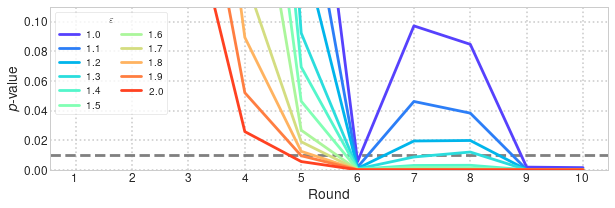

In [31]:
printmd(r'**Test 2**: $\mu$ bounded from below by $-\varepsilon$ ($\iff \mu + \varepsilon > 0$)')

_ = plt.figure(figsize=(10,3))
_ = plt.axhline(0.01, linestyle='dashed', color='gray')
palette = itertools.cycle(sns.color_palette('rainbow', 11))

for eps in np.linspace(1,2,11).round(1):
    pvals = []
    
    for rnd, vals in mean_distances.items():
        vals = [v + eps for v in vals]
        w, p = stats.wilcoxon(vals, alternative='greater', zero_method='pratt')
        pvals.append(p)
        
    _ = plt.plot(range(1,11), pvals, label=eps, color=next(palette))

_ = plt.xticks(range(1,11))
_ = plt.xlabel('Round')
_ = plt.ylabel('$p$-value')
_ = plt.ylim((0,0.11))
_ = plt.legend(title=r'$\varepsilon$', ncol=2)

In [32]:
eps = 1.5
printmd(r'**Test 2 ($\varepsilon = {}$)**: $\mu$ bounded from below by $-\varepsilon$ ($\iff \mu + \varepsilon > 0$)'.format(eps))

agg_level = ['All distances', 'First distances', 'Mean per-treatment distances']
Wilcoxon_rounds(agg_level, 'greater', -eps)

**Test 2 ($\varepsilon = 1.5$)**: $\mu$ bounded from below by $-\varepsilon$ ($\iff \mu + \varepsilon > 0$)

All distances                                 First distances         \
               Mean Median Sample size    $p$-value            Mean Median   
Round                                                                        
1          -6.82203     -4         826            1        -11.4651     -9   
2          -3.55066     -1         908            1        -6.85057     -5   
3          -2.10164      0         974     0.508237        -3.19318      0   
4          -1.71283      0         982     0.011956        -2.57303      0   
5          -1.12298      0         992  2.07543e-13        -1.80899      0   
6         -0.601815      0         992  5.01614e-24        -2.17978      0   
7         -0.750501      0         998  1.31255e-24       -0.772727      0   
8          -0.75502      0         996   1.7133e-22        -1.14607      0   
9          -0.49498      0         996  1.18388e-40       -0.382022      0   
10        -0.513834      0        1012  3.09462e-40       -0.659091      0   

                              Mean per-treatment distances            \
      Sample size   $p$-value                         Mean    Median   
Round                                                                  
1              86           1                     -7.38481  -6.92857   
2              87    0.999989                     -3.91682      -2.2   
3              88    0.867749                     -2.23216  -1.41667   
4              89    0.701034                     -1.91391  -1.16667   
5              89    0.519923                     -1.40659 -0.333333   
6              89     0.32629                    -0.730877         0   
7              88  0.00198196                     -0.74279         0   
8              89   0.0134281                    -0.765628         0   
9              89  0.00120509                    -0.477617         0   
10             88  0.00250407                    -0.466333         0   

                                
      Sample size    $p$-value  
Round                           
1              86            1  
2              87     0.999697  
3              88     0.763044  
4              89     0.335887  
5              89    0.0462977  
6              89  0.000201927  
7              88   0.00166422  
8              89   0.00126539  
9              89  7.31838e-07  
10             88  1.87272e-06

Below, the distribution of allocative efficiency is considered for each round $r \in [1, 10]$ separately.

One-sided test is used to test:
- $H_0: \mu \leq \mu_0$ against $H_1 : \mu > \mu_0$ (```alternative == 'greater'```).

**Test**: $\mu$ bounded from below by $\mu_0$ ($\iff \mu - \mu_0 > 0$)

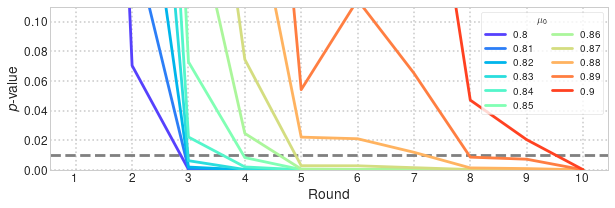

In [33]:
printmd(r'**Test**: $\mu$ bounded from below by $\mu_0$ ($\iff \mu - \mu_0 > 0$)')

_ = plt.figure(figsize=(10,3))
_ = plt.axhline(0.01, linestyle='dashed', color='gray')
palette = itertools.cycle(sns.color_palette('rainbow', 11))

for mu0 in np.linspace(0.8,0.9,11).round(2):
    pvals = []
    
    for rnd, vals in allocative_efficiencies.items():
        vals = [v - mu0 for v in vals]
        w, p = stats.wilcoxon(vals, alternative='greater', zero_method='pratt')
        pvals.append(p)
        
    _ = plt.plot(range(1,11), pvals, label=mu0, color=next(palette))

_ = plt.xticks(range(1,11))
_ = plt.xlabel('Round')
_ = plt.ylabel('$p$-value')
_ = plt.ylim((0,0.11))
_ = plt.legend(title=r'$\mu_0$', ncol=2)

In [34]:
printmd(r'**Test**: $\mu$ bounded from below by $\mu_0$ ($\iff \mu - \mu_0 > 0$)')

agg_level = ['Allocative efficiency']
results1 = Wilcoxon_rounds(agg_level, 'greater', 0.85)
results1.rename({r'$p$-value': r'$p$-value (0.85)'}, level=1, axis=1, inplace=True)
results2 = Wilcoxon_rounds(agg_level, 'greater', 0.9)
results1[agg_level[0], r'$p$-value (0.9)'] = results2[agg_level[0], r'$p$-value']
results1

**Test**: $\mu$ bounded from below by $\mu_0$ ($\iff \mu - \mu_0 > 0$)

Allocative efficiency                                         \
                       Mean    Median Sample size $p$-value (0.85)   
Round                                                                
1                  0.729581  0.790698          89         0.999775   
2                  0.792739  0.866667          89         0.802671   
3                  0.849605      0.92          89        0.0728119   
4                  0.875847  0.931034          89       0.00825302   
5                  0.891715   0.93617          89      0.000185328   
6                  0.891856  0.930556          89      2.69966e-05   
7                  0.889797  0.928571          89        2.169e-05   
8                  0.905811  0.942857          89      2.02621e-06   
9                  0.909814  0.960784          89      3.12474e-06   
10                 0.929816  0.983046          88      4.88917e-11   

                       
      $p$-value (0.9)  
Round                  
1                   1  
2            0.999831  
3            0.884801  
4              0.7091  
5            0.135253  
6             0.32759  
7            0.292772  
8            0.047027  
9           0.0203498  
10        0.000104137

**Mann-Kendall trend test** ([```pyMannKendall``` documentation](https://pypi.org/project/pymannkendall/))
- The [Mann-Kendall trend test](https://www.statisticshowto.com/mann-kendall-trend-test/) is used to analyse data collected over time for consistently increasing or decreasing trends. It is a non-parametric test (and hence works for all distributions), but there should be no serial correlation.
- The test can be used to find trends for as few as four samples. However, with only a few data points, the test has a high probability of not finding a trend when one would be present if more points were provided. The more data points you have the more likely the test is going to find a true trend (as opposed to one found by chance). The minimum number of recommended measurements is therefore at least 8 to 10.
- If there are multiple points per time period, the median value should be used.

Mann-Kendall test applied to <span style='color:#00cc66'>**individual sessions**</span> (_all_ rounds taken into account)

In [35]:
eps = 1.5
mu0 = 0.85

n_total = 0
n_increasing = {'Median distance': 0, 'Allocative efficiency': 0}
n_decreasing = {'Median distance': 0, 'Allocative efficiency': 0}

dist_noTrend_means = []
dist_noTrend_nearCE = 0
allEff_noTrend_near1 = 0

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    metrics = {'Median distance': [], 'Allocative efficiency': []}
    game_distances = []
    
    for rnd, df_round in df_game.groupby(['round']):   
        distances = distances_to_EPR(df_round, treatment, game, rnd)
        
        if len(distances) > 0:
            metrics['Median distance'].append(np.median(distances))
            game_distances.extend(distances)
            
        metrics['Allocative efficiency'].append(allocative_efficiency(df_round, treatment, game, rnd))
    
    for metric, vals in metrics.items():
        result = mk.original_test(vals)

        if result.trend == 'increasing':
            n_increasing[metric] += 1
        elif result.trend == 'decreasing':
            n_decreasing[metric] += 1
        else:
            if metric == 'Median distance':
                dist_noTrend_means.append(np.mean(metrics['Median distance']))

                w, p1 = stats.wilcoxon([d + eps for d in game_distances], alternative='greater')
                w, p2 = stats.wilcoxon([d - eps for d in game_distances], alternative='less')

                if (p1 <= 0.01) and (p2 <= 0.01):
                    dist_noTrend_nearCE += 1
            elif metric == 'Allocative efficiency':
                w, p = stats.wilcoxon([a - mu0 for a in vals], alternative='greater')
                
                if (p <= 0.01):
                    allEff_noTrend_near1 += 1                

    n_total += 1

All sessions: 89

<span style="color:#DB5461">**Median distance**</span>

Increasing trend: **30**, decreasing trend: 0, no trend: 59

Sessions with no trend:

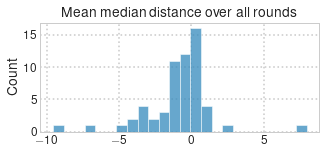

DescribeResult(nobs=59, minmax=(-9.55, 7.95), mean=-0.9692467043314502, variance=5.23927715796841, skewness=-0.3853869132583688, kurtosis=5.969749644626489)

In **36** sessions, no trend was observed due to $\mu \in (-\varepsilon, \varepsilon)$ for the overall $\mu$ ($\varepsilon = 1.5$).

<span style="color:#DB5461">**Allocative efficiency**</span>

Increasing trend: **24**, decreasing trend: 0, no trend: 65

Sessions with no trend:

In **35** sessions, no trend was observed due to $\mu > \mu_0$ for the overall $\mu$ ($\mu_0 = 0.85$).

In [36]:
printmd(r'All sessions: {}'.format(n_total)) 

for metric in metrics.keys():
    printmd('<span style="color:#DB5461">**{}**</span>'.format(metric))
    printmd('Increasing trend: **{}**, decreasing trend: {}, no trend: {}'.format(n_increasing[metric], n_decreasing[metric], n_total - n_increasing[metric] - n_decreasing[metric]))

    printmd('Sessions with no trend:')

    if metric == 'Median distance':
        _ = plt.figure(figsize=(5,2))
        _ = plt.title('Mean median distance over all rounds')
        _ = sns.histplot(dist_noTrend_means)
        _ = plt.show()

        stats.describe(dist_noTrend_means)

        printmd(r'In **{}** sessions, no trend was observed due to $\mu \in (-\varepsilon, \varepsilon)$ for the overall $\mu$ ($\varepsilon = {}$).'.format(dist_noTrend_nearCE, eps))
        
    elif metric == 'Allocative efficiency':
        printmd(r'In **{}** sessions, no trend was observed due to $\mu > \mu_0$ for the overall $\mu$ ($\mu_0 = {}$).'.format(allEff_noTrend_near1, mu0))

Mann-Kendall test applied to <span style='color:#00cc66'>**individual treatments**</span> (_all_ rounds taken into account)

In [37]:
eps = 1.5
mu0 = 0.85

index = [treatment_names[treatment] for treatment in df['treatment'].unique()]
index = pd.Index(index, name='Treatment')
columns = pd.MultiIndex.from_product([['Median distance', 'Standard deviation'], ['Trend', r'$p$-value']])
results = pd.DataFrame(index=index, columns=columns)

dist_noTrend_nearCE_list = []
allEff_noTrend_near1_list = []

for treatment, df_treatment in df.groupby(['treatment']):
    metrics = {'Median distance': [], 'Standard deviation': [], 'Allocative efficiency': []}
    treatment_distances = []

    for rnd, df_round in df_treatment.groupby(['round']):
        round_distances = []
        
        for game, df_game in df_round.groupby(['game']):
            distances = distances_to_EPR(df_game, treatment, game, rnd)
            round_distances.extend(distances)
            treatment_distances.extend(distances)
            
            metrics['Allocative efficiency'].append(allocative_efficiency(df_game, treatment, game, rnd))

        metrics['Median distance'].append(np.nanmedian(round_distances))
        metrics['Standard deviation'].append(np.nanstd(round_distances))
    
    for metric, vals in metrics.items():
        result = mk.original_test(vals)
        results.loc[treatment_names[treatment], (metric, 'Trend')] = result.trend
        results.loc[treatment_names[treatment], (metric, r'$p$-value')] = result.p
    
        if result.trend == 'no trend':
            if metric == 'Median distance':
                w, p1 = stats.wilcoxon([d + eps for d in treatment_distances], alternative='greater')
                w, p2 = stats.wilcoxon([d - eps for d in treatment_distances], alternative='less')

                if (p1 <= 0.01) and (p2 <= 0.01):
                    dist_noTrend_nearCE_list.append(treatment_names[treatment])
            
            elif metric == 'Allocative efficiency':
                w, p = stats.wilcoxon([a - mu0 for a in vals], alternative='greater')
                
                if (p <= 0.01):
                    allEff_noTrend_near1_list.append(treatment_names[treatment])

In [38]:
results

printmd('<span style="color:#DB5461">**Median distance**</span>')
printmd(r'No trend, but $\mu \in (-\varepsilon, \varepsilon)$ for the overall $\mu$ ($\varepsilon = {}$):'.format(eps))

for treatment in dist_noTrend_nearCE_list:
     printmd('- {}'.format(treatment))

printmd('')
printmd(r'Note that if e.g. $\varepsilon \geq 3.5$, $\mu \in (-\varepsilon, \varepsilon)$ holds for all treatments for which no trend was observed.')

printmd('')
printmd('<span style="color:#DB5461">**Allocative efficiency**</span>')

printmd(r'No trend, but $\mu > \mu_0$ for the overall $\mu$ ($\mu_0 = {}$):'.format(mu0))

for treatment in allEff_noTrend_near1_list:
     printmd('- {}'.format(treatment))

Median distance  \
                                                             Trend   
Treatment                                                            
Private Information, First price, Regular               increasing   
Other-side, First price, Regular                          no trend   
Same-side, First price, Regular                         increasing   
Same-side, Matchmaker keeps, Regular                      no trend   
Black Box, Random price, Regular                          no trend   
Black Box, Matchmaker keeps, Regular                    increasing   
Black Box, First price, Regular                         increasing   
Private Information, First price, More sellers            no trend   
Black Box, First price, More sellers                    increasing   
Private Information, First price, More buyers             no trend   
Black Box, First price, More buyers                     increasing   
Private Information, First price, From buyers t...        no trend   
Private Information, First price, From sellers ...        no trend   
Private Information, First price, Large CE                no trend   
Black Box, First price, Large CE                          no trend   
Private Information, First price, Seller shift          increasing   
Black Box, First price, More rounds                     increasing   

                                                                 \
                                                      $p$-value   
Treatment                                                         
Private Information, First price, Regular             0.0302458   
Other-side, First price, Regular                       0.163734   
Same-side, First price, Regular                       0.0383258   
Same-side, Matchmaker keeps, Regular                   0.163734   
Black Box, Random price, Regular                      0.0853999   
Black Box, Matchmaker keeps, Regular                 0.00111787   
Black Box, First price, Regular                       0.0193795   
Private Information, First price, More sellers         0.396493   
Black Box, First price, More sellers                0.000844676   
Private Information, First price, More buyers          0.163734   
Black Box, First price, More buyers                   0.0383258   
Private Information, First price, From buyers t...     0.147778   
Private Information, First price, From sellers ...            1   
Private Information, First price, Large CE                    1   
Black Box, First price, Large CE                       0.163734   
Private Information, First price, Seller shift        0.0383258   
Black Box, First price, More rounds                 7.14672e-09   

                                                   Standard deviation  \
                                                                Trend   
Treatment                                                               
Private Information, First price, Regular                  decreasing   
Other-side, First price, Regular                           decreasing   
Same-side, First price, Regular                            decreasing   
Same-side, Matchmaker keeps, Regular                       decreasing   
Black Box, Random price, Regular                           decreasing   
Black Box, Matchmaker keeps, Regular                         no trend   
Black Box, First price, Regular                              no trend   
Private Information, First price, More sellers             decreasing   
Black Box, First price, More sellers                       decreasing   
Private Information, First price, More buyers              decreasing   
Black Box, First price, More buyers                        decreasing   
Private Information, First price, From buyers t...         decreasing   
Private Information, First price, From sellers ...           no trend   
Private Information, First price, Large CE                   no trend   
Black Box, First price, Large CE                           decreasin

<span style="color:#DB5461">**Median distance**</span>

No trend, but $\mu \in (-\varepsilon, \varepsilon)$ for the overall $\mu$ ($\varepsilon = 1.5$):

- Black Box, First price, Large CE

- Private Information, First price, From buyers to sellers

- Private Information, First price, Large CE

- Private Information, First price, More buyers

- Other-side, First price, Regular

- Same-side, Matchmaker keeps, Regular

Note that if e.g. $\varepsilon \geq 3.5$, $\mu \in (-\varepsilon, \varepsilon)$ holds for all treatments for which no trend was observed.

<span style="color:#DB5461">**Allocative efficiency**</span>

No trend, but $\mu > \mu_0$ for the overall $\mu$ ($\mu_0 = 0.85$):

- Private Information, First price, From sellers to buyers

- Private Information, First price, Large CE

- Private Information, First price, More sellers

- Private Information, First price, Seller shift

- Other-side, First price, Regular

## Selten's index of predictive success

[R. Selten: Properties of a measure of predictive success (1991)](https://www.sciencedirect.com/science/article/pii/0165489691900764) 
  
Measure of predictive success: $m = h - a$ where
- $r \in [0, 1]$: _hit rate_, the relative frequency of correct predictions
- $a \in [0, 1]$: _the area_, the relative size of the predicted subset compared with the set of all possible outcomes

Notes:
1. How should the area of a heterogeneous sample be defined? In applications the convention is used that the area of a heterogeneous sample is the _arithmetic mean of all areas_, computed on the basis of the parameter combinations underlying the observations; every observation has the same weight in this arithmetic mean.

2. Notice that a high ‘hit rate’ means high accuracy, whereas a small ‘area’ means high precision. Observe that $-1 < m < 1$, _with $m = 0$ indicating a rule which predicts just as well as uniform random behaviour over output levels_ (as the expected hit rate $r$ equals the area $a$ when play was in fact uniform random). In other words, $m$ will be positive only if actual behaviour is better described by a given rule than by uniform random behaviour. [A. Bosch‐Domènech, N. J. Vriend : Imitation of successful behaviour in cournot markets (2003)](https://academic.oup.com/ej/article-abstract/113/487/495/5061009)

3. <font color='#DB5461'>The _random simulations also allow us to calculate the Predictive Success Index_ (PSI, Selten (1991)), a measure that adjusts the frequency of successful predictions by the power of the test (the area of the core region in the present case). The values of PSI for the three treatments can be obtained by subtracting values for simulated power tests in Table III from actual results for human subjects in Table IX.</font> [A. Dolgopolov, D. Houser, C. Martinelli, T. Stratmann: Assignment Markets: Theory and Experiments (2019)](https://ideas.repec.org/p/gms/wpaper/1075.html)

The implementation below assumes that all compatible buyer-seller pairs are equally likely to strike a deal, whereby the resulting deal price may assume any value between the respective valuations.

In [39]:
def Selten_index(dfr, treatment, game, rnd, output='SI', eps1=0, eps2=0):
    [epr1, epr2] = EPR_rounds[treatment, game, rnd]
    prices = dfr['price'].dropna()
    
    epr1 -= eps1
    epr2 += eps2
    
    if len(prices) > 0:
        EPR_prices = sum((epr1 <= prices) & (prices <= epr2)) # realised prices in EPR
        all_prices = prices.count() # all realised prices

        r = EPR_prices/all_prices

        width_EPR = epr2 - epr1 + 1

        valuations = get_valuations(dfr)
        possible_trade_pairs = [(vals, valb) for (vals, valb) in itertools.product(valuations['Seller'], valuations['Buyer']) if vals <= valb]

        nOutcomes = [valb - vals + 1 for (vals, valb) in possible_trade_pairs]
        nOutcomes = np.mean(nOutcomes)

#         # Alternative approach: span of treatment-wise realised prices
#         minTreatmentPrice = min(df[df['treatment'] == treatment]['price'].dropna())
#         maxTreatmentPrice = max(df[df['treatment'] == treatment]['price'].dropna())
#         nOutcomes = maxTreatmentPrice - minTreatmentPrice + 1
        
        if width_EPR < nOutcomes:
            a = width_EPR/nOutcomes
        else:
            a = 1
        
        m = r-a

    else:
        m = np.nan
        r = np.nan
        a = np.nan
    
    if output == 'SI':
        out = m
    elif output == 'hitRate':
        out = r
    elif output == 'area':
        out = a
    elif output == 'all':
        out = m, r, a
        
    return out

### Evolution over time

_Top_: convergence to CE\
_Middle_: allocative efficiency\
_Bottom_: Selten index $m$, hit rate $r$, CE area $a$

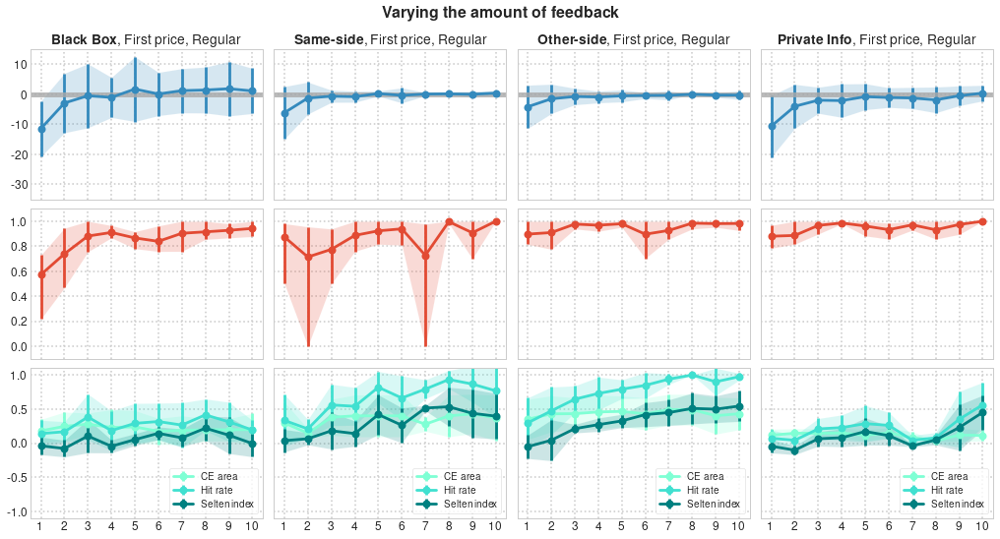

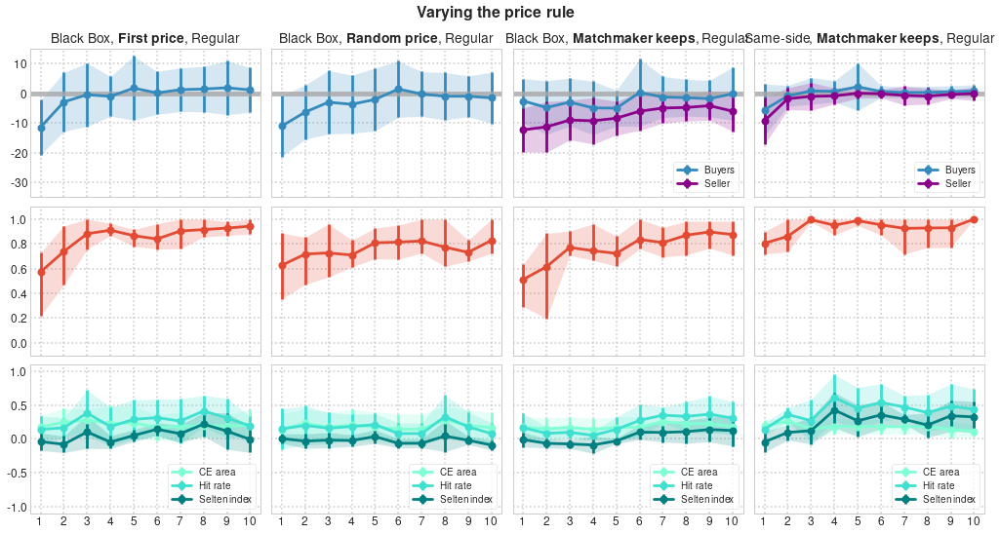

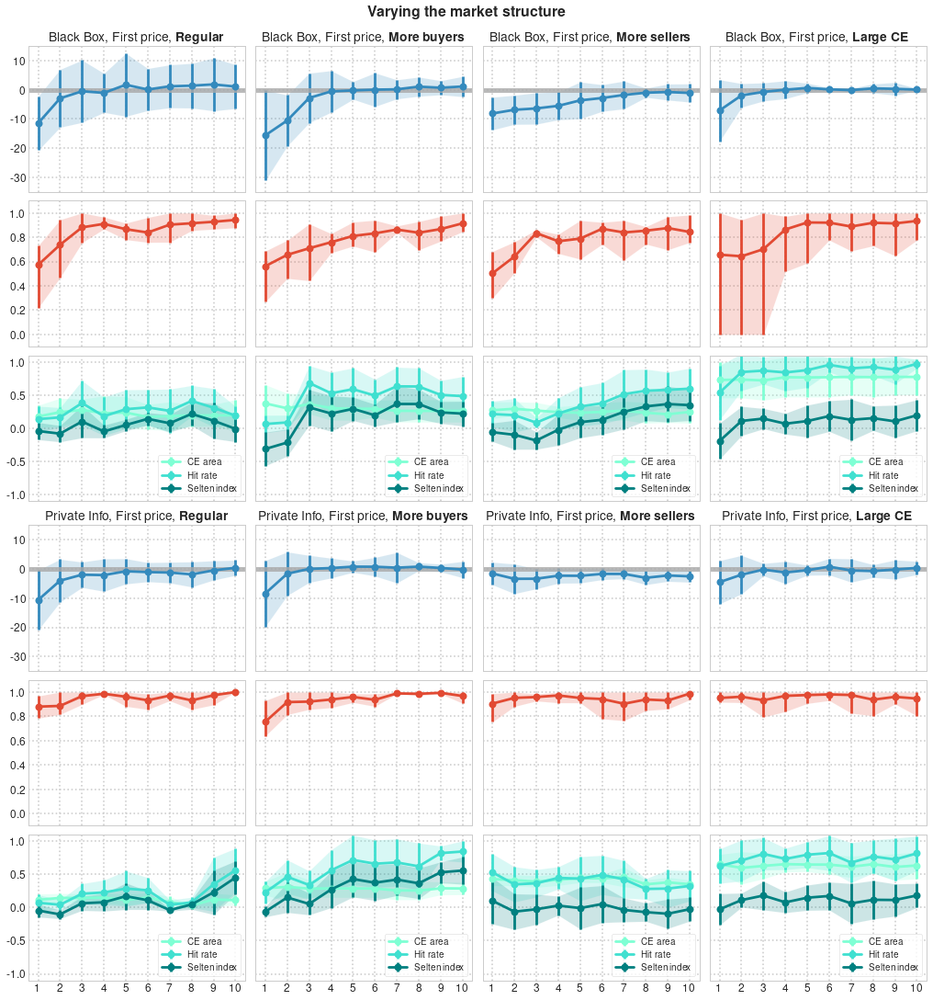

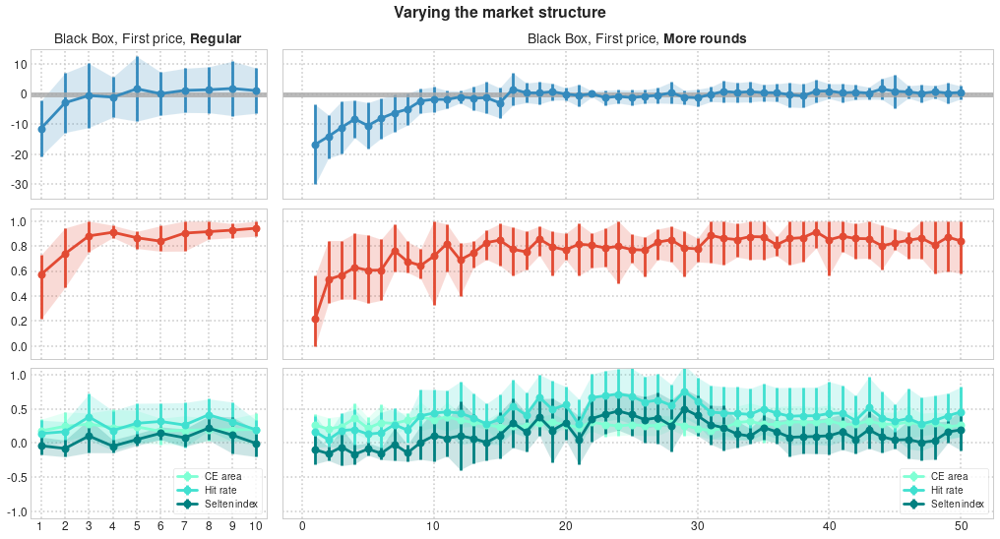

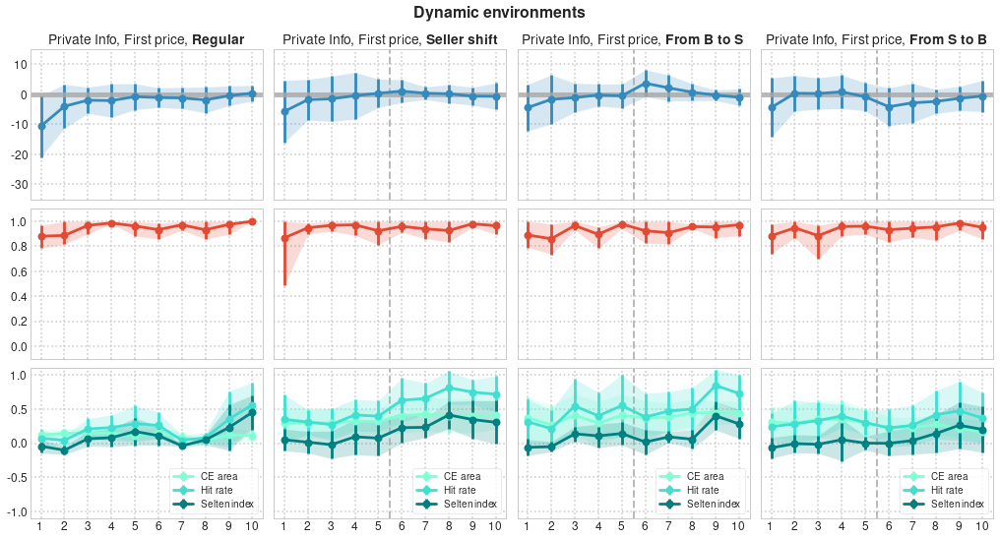

In [40]:
treatment_grid_arrangement = {'feedback': [['BB', 'Same', 'Other', 'Full']],
                              'price': [['BB', 'BBRandom', 'BBMMK', 'SameMMK']],
                              'structure_1': [['BB', 'BBMoreB', 'BBMoreS', 'BBLargeCE'], ['Full', 'FullMoreB', 'FullMoreS', 'FullLargeCE']],
                              'structure_2': [['BB', 'BBMoreRounds']],
                              'dynamics': [['Full', 'FullSShift', 'FullFromBtoS', 'FullFromStoB']]}

for key, treatments in treatment_grid_arrangement.items():
    dim = key.split('_')[0]
    
    suptitle = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
        
    if 'MoreRounds' in ' '.join(flatten_list(treatments)):
        kwargs = {'gridspec_kw': {'width_ratios': [1, 3]}} # reserve more space for the treatment with more periods
    else:
        kwargs = {}
    
    fig, ax = treatment_grid(treatments=treatments, suptitle=suptitle, bold_title_part=bold_title_part,
                             functions=[(distances_to_EPR, 'sdev'), (allocative_efficiency, 'minmax'), (Selten_index, 'sdev')], **kwargs)

    _ = plt.savefig('Figures/EPR_AllEff_SI_{}.pdf'.format(key), bbox_inches='tight')

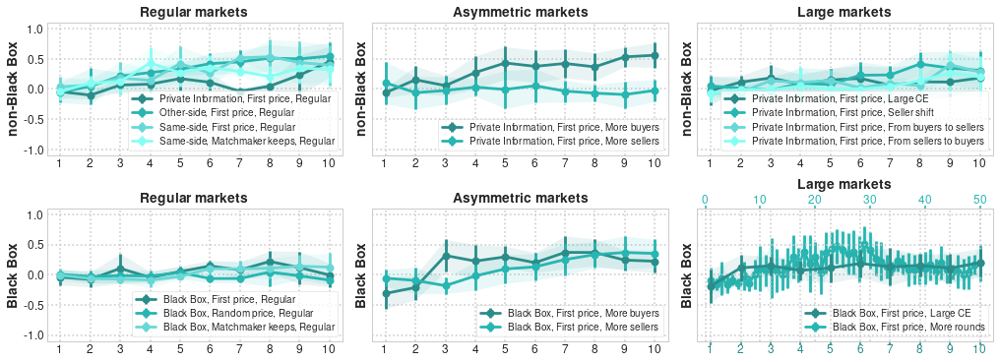

In [41]:
treatment_grid_combined(treatment_groups, Selten_index, 'sdev', teal_palette)

### Comparison across treatments

In [42]:
def Selten_index_treatments(eps1=0, eps2=0):
    index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()], name='Treatment')
    columns = pd.MultiIndex.from_product([['All', 'Last five'], ['Predictive success index', 'Hit rate', 'Area']], names=['Rounds', 'Metrics'])
    df_SeltenIndex = pd.DataFrame(index=index, columns=columns, dtype=float)

    for treatment, df_treatment in df.groupby(['treatment']):
        metrics = {(rounds, metric): [] for (rounds, metric) in columns}

        maxRound = df_treatment['round'].max()
        n_lastFive = df_treatment[df_treatment['round'] > maxRound-5]['price'].count()
        n_all = df_treatment['price'].count()

        for (game, rnd), dfr in df_treatment.groupby(['game', 'round']):
            m, r, a = Selten_index(dfr, treatment, game, rnd, output='all', eps1=eps1, eps2=eps2)
            n = dfr['price'].count()

            metrics['All', 'Predictive success index'].append(m*n/n_all)
            metrics['All', 'Hit rate'].append(r*n/n_all)
            metrics['All', 'Area'].append(a*n/n_all)

            if rnd > maxRound-5:
                metrics['Last five', 'Predictive success index'].append(m*n/n_lastFive)
                metrics['Last five', 'Hit rate'].append(r*n/n_lastFive)
                metrics['Last five', 'Area'].append(a*n/n_lastFive)

        metrics = {key: np.nansum(values) for (key, values) in metrics.items()}

        df_SeltenIndex.loc[treatment_names[treatment]] = metrics
    
    return df_SeltenIndex

In [43]:
df_SeltenIndex = Selten_index_treatments()
df_SeltenIndex.round(2)
# print(df_SeltenIndex.round(2).to_latex())

Rounds                                                                  All  \
Metrics                                            Predictive success index   
Treatment                                                                     
Private Information, First price, Regular                              0.10   
Other-side, First price, Regular                                       0.35   
Same-side, First price, Regular                                        0.33   
Same-side, Matchmaker keeps, Regular                                   0.24   
Black Box, Random price, Regular                                      -0.02   
Black Box, Matchmaker keeps, Regular                                   0.04   
Black Box, First price, Regular                                        0.07   
Private Information, First price, More sellers                        -0.00   
Black Box, First price, More sellers                                   0.14   
Private Information, First price, More buyers                          0.32   
Black Box, First price, More buyers                                    0.20   
Private Information, First price, From buyers t...                     0.11   
Private Information, First price, From sellers ...                     0.06   
Private Information, First price, Large CE                             0.14   
Black Box, First price, Large CE                                       0.21   
Private Information, First price, Seller shift                         0.19   
Black Box, First price, More rounds                                    0.16   

Rounds                                                             \
Metrics                                            Hit rate  Area   
Treatment                                                           
Private Information, First price, Regular              0.21  0.11   
Other-side, First price, Regular                       0.73  0.38   
Same-side, First price, Regular                        0.59  0.25   
Same-side, Matchmaker keeps, Regular                   0.40  0.17   
Black Box, Random price, Regular                       0.17  0.18   
Black Box, Matchmaker keeps, Regular                   0.22  0.18   
Black Box, First price, Regular                        0.25  0.18   
Private Information, First price, More sellers         0.39  0.40   
Black Box, First price, More sellers                   0.39  0.25   
Private Information, First price, More buyers          0.59  0.27   
Black Box, First price, More buyers                    0.48  0.28   
Private Information, First price, From buyers t...     0.44  0.33   
Private Information, First price, From sellers ...     0.31  0.25   
Private Information, First price, Large CE             0.74  0.59   
Black Box, First price, Large CE                       0.80  0.59   
Private Information, First price, Seller shift         0.50  0.31   
Black Box, First price, More rounds                    0.43  0.27   

Rounds                                                            Last five  \
Metrics                                            Predictive success index   
Treatment                                                                     
Private Information, First price, Regular                              0.16   
Other-side, First price, Regular                                       0.53   
Same-side, First price, Regular                                        0.49   
Same-side, Matchmaker keeps, Regular                                   0.29   
Black Box, Random price, Regular                                      -0.04   
Black Box, Matchmaker keeps, Regular                                   0.12   
Black Box, First price, Regular                                        0.13   
Private Information, First price, More sellers                        -0.04   
Black Box, First price, More sellers                                   0.29   
Private Information, First price, More buyers                          0.45   
Black Box, 

In [44]:
def Selten_index_groups(eps1=0, eps2=0):
    feedback_type = list(set([key[1] for key in treatment_groups.keys()]))
    market_type = list(set([key[0].split()[0] for key in treatment_groups.keys()]))

    index = pd.MultiIndex.from_product([feedback_type, market_type], names=['Feedback', 'Market type'])
    columns = pd.MultiIndex.from_product([['All', 'Last five'], ['Predictive success index', 'Hit rate', 'Area']], names=['Rounds', 'Metrics'])
    df_SeltenIndex = pd.DataFrame(index=index, columns=columns, dtype=float)
    
    for group_name, group in treatment_groups.items():
        feedback = group_name[1]
        market = group_name[0].split()[0]
        
        metrics = {(rounds, metric): [] for (rounds, metric) in columns} # store the metrics for each of the market groups separately
    
        df_group = df[df['treatment'].isin(group)]
    
        n_lastFive = df_group.groupby(['treatment']).apply(lambda g: g[g['round'] > max(g['round']-5)])['price'].count()
        n_all = df_group['price'].count()
    
        for treatment, df_treatment in df_group.groupby(['treatment']):
            maxRound = df_treatment['round'].max()

            for (game, rnd), dfr in df_treatment.groupby(['game', 'round']):
                m, r, a = Selten_index(dfr, treatment, game, rnd, output='all', eps1=eps1, eps2=eps2)
                n = dfr['price'].count()

                metrics['All', 'Predictive success index'].append(m*n/n_all)
                metrics['All', 'Hit rate'].append(r*n/n_all)
                metrics['All', 'Area'].append(a*n/n_all)

                if rnd > maxRound-5:
                    metrics['Last five', 'Predictive success index'].append(m*n/n_lastFive)
                    metrics['Last five', 'Hit rate'].append(r*n/n_lastFive)
                    metrics['Last five', 'Area'].append(a*n/n_lastFive)

        metrics = {key: np.nansum(values) for (key, values) in metrics.items()}

        df_SeltenIndex.loc[feedback, market] = metrics
    
    return df_SeltenIndex

In [45]:
df_SeltenIndex_groups = Selten_index_groups(eps1=0, eps2=0)
df_SeltenIndex_groups.round(2)
# print(df_SeltenIndex_groups.round(2).to_latex())

Rounds                                         All                 \
Metrics                   Predictive success index Hit rate  Area   
Feedback      Market type                                           
non-Black Box Large                           0.13     0.53  0.40   
              Regular                         0.25     0.48  0.23   
              Asymmetric                      0.16     0.49  0.34   
Black Box     Large                           0.17     0.50  0.33   
              Regular                         0.03     0.22  0.18   
              Asymmetric                      0.17     0.43  0.26   

Rounds                                   Last five                 
Metrics                   Predictive success index Hit rate  Area  
Feedback      Market type                                          
non-Black Box Large                           0.20     0.61  0.41  
              Regular                         0.37     0.60  0.23  
              Asymmetric                      0.21     0.53  0.33  
Black Box     Large                           0.19     0.62  0.43  
              Regular                         0.08     0.26  0.19  
              Asymmetric                      0.28     0.54  0.26

### Black Box versus non-Black Box

In [46]:
def Selten_index_BB_nonBB(eps1=0, eps2=0, rounds='All'):
    index = pd.Index(['non-Black Box', 'Black Box', 'All'], name='Treatments')
    columns = ['Predictive success index', 'Hit rate', 'Area']
    df_results = pd.DataFrame(index=index, columns=columns, dtype=float)

    df_SeltenIndex = Selten_index_treatments(eps1=eps1, eps2=eps2)
    
    for idx in index:
        if idx == 'Black Box':
            metrics = df_SeltenIndex[df_SeltenIndex.index.str.contains('Black Box')]
            data = df[df['treatment'].isin(BB_treatments)]
        elif idx == 'non-Black Box':
            metrics = df_SeltenIndex[~df_SeltenIndex.index.str.contains('Black Box')]
            data = df[~df['treatment'].isin(BB_treatments)]
        else:
            metrics = df_SeltenIndex
            data = df

        m = []
        r = []
        a = []
        
        if rounds == 'All':
            n_all = data['price'].count()
        elif rounds == 'Last five':
            n_all = data.groupby(['treatment']).apply(lambda g: g[g['round'] > max(g['round']-5)])['price'].count()

        for treatment, df_treatment in data.groupby(['treatment']):
            if rounds == 'All':
                n = df_treatment['price'].count()
            elif rounds == 'Last five':
                n = df_treatment[df_treatment['round'] > max(df_treatment['round']-5)]['price'].count()

            m.append(metrics.loc[treatment_names[treatment], (rounds, 'Predictive success index')]*n/n_all)
            r.append(metrics.loc[treatment_names[treatment], (rounds, 'Hit rate')]*n/n_all)
            a.append(metrics.loc[treatment_names[treatment], (rounds, 'Area')]*n/n_all)

        df_results.loc[idx, 'Predictive success index'] = np.nansum(m)
        df_results.loc[idx, 'Hit rate'] = np.nansum(r)
        df_results.loc[idx, 'Area'] = np.nansum(a)
    
    return df_results

In [47]:
printmd(r'**$\pi \in \epr{}{}$, all rounds**')
df_SeltenIndex_BBnonBB = Selten_index_BB_nonBB(eps1=0, eps2=0, rounds='All')
df_SeltenIndex_BBnonBB.round(2)
print(df_SeltenIndex_BBnonBB.round(2).to_latex())

printmd(r'**$\pi \in \epr{}{}$, last five rounds**')
df_results = Selten_index_BB_nonBB(eps1=0, eps2=0, rounds='Last five')
df_results.round(2)
# print(df_results.round(2).to_latex())

**$\pi \in \epr{}{}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
non-Black Box,0.18,0.50,0.33
Black Box,0.13,0.40,0.27
All,0.16,0.46,0.30


\begin{tabular}{lrrr}
\toprule
{} &  Predictive success index &  Hit rate &  Area \\
Treatments    &                           &           &       \\
\midrule
non-Black Box &                      0.18 &      0.50 &  0.33 \\
Black Box     &                      0.13 &      0.40 &  0.27 \\
All           &                      0.16 &      0.46 &  0.30 \\
\bottomrule
\end{tabular}



**$\pi \in \epr{}{}$, last five rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
non-Black Box,0.26,0.58,0.33
Black Box,0.17,0.44,0.27
All,0.23,0.53,0.30


### Widening the CE range

In [48]:
rounds = df.groupby(['treatment', 'game', 'round'])
rounds_woDeal = rounds.filter(lambda g: g['price'].count() == 0)[['treatment', 'game', 'round']].drop_duplicates()

In [49]:
printmd('Rounds with no deal struck: {}'.format(len(rounds_woDeal)))
rounds_woDeal

printmd('All rounds: {}'.format(len(rounds)))

Rounds with no deal struck: 7

,treatment,game,round
12984,Same,5,2
13062,Same,5,7
67532,BBLargeCE,7,1
67550,BBLargeCE,7,2
67564,BBLargeCE,7,3
70226,BBMoreRounds,1,1
71772,BBMoreRounds,2,1


All rounds: 1088

Check for rounds with no bids submitted

In [50]:
for treatment, df_treatment in df.groupby(['treatment']):
    max_round = max(df_treatment['round'])
    
    for rnd in range(1, max_round+1):
        for game, df_game in df_treatment.groupby(['game']):
            if len(df_game[df_game['round'] == rnd]) == 0:
                print('Round {} of game {} under treatment {} is missing'.format(rnd, game, treatment))

Round 25 of game 1 under treatment BBMoreRounds is missing
Round 10 of game 4 under treatment FullLargeCE is missing


**Problem 1**: The absence of some players may reduce the CE price range to a single point, resulting in a low value of PSI (despite convergence)

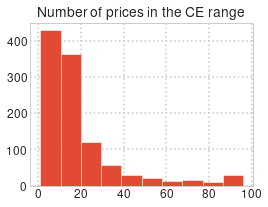

Fraction of rounds with a singleton CE range

0.18933823529411764

Summary statistics

count    1088.000000
mean       17.107537
std        20.511859
min         1.000000
25%         6.000000
50%        11.000000
75%        21.000000
max        96.000000
dtype: float64

In [51]:
nEPR = []
_ = plt.figure(figsize=(4,3))

for key, EPR in EPR_rounds.items():
    nEPR.append(EPR[1] - EPR[0] + 1)

_ = plt.title('Number of prices in the CE range')
_ = plt.hist(nEPR)
_ = plt.show()

printmd('Fraction of rounds with a singleton CE range')
len([n for n in nEPR if n == 1])/len(nEPR)

printmd('Summary statistics')
pd.Series(nEPR).describe()

**Problem 2**: The absence of some players may lead to an excessively wide CE price range, resulting in a low value of PSI (despite the existence of a much narrower range of attraction)

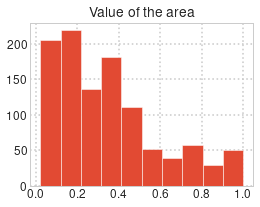

Fraction of rounds with an area of 1

0.030527289546716005

Summary statistics

count    1081.000000
mean        0.343370
std         0.258536
min         0.022801
25%         0.175911
50%         0.309324
75%         0.483627
max         1.000000
dtype: float64

In [52]:
_ = plt.figure(figsize=(4,3))
areas = []

for (treatment, game, rnd), dfr in df.groupby(['treatment', 'game', 'round']):
    prices = dfr[dfr['price'].notna()]
    
    if len(prices) > 0:
        valuations = get_valuations(dfr)
        possible_trade_pairs = [(vals, valb) for (vals, valb) in itertools.product(valuations['Seller'], valuations['Buyer']) if vals <= valb]

        nOutcomes = [valb - vals + 1 for (vals, valb) in possible_trade_pairs]
        nOutcomes = np.mean(nOutcomes)

        EPR = EPR_rounds[treatment, game, rnd]

        area = (EPR[1] - EPR[0] + 1)/nOutcomes
        
        if area > 1:
            area = 1
            
        areas.append(area)

_ = plt.title('Value of the area')
_ = plt.hist(areas)
_ = plt.show()

printmd('Fraction of rounds with an area of 1')
len([a for a in areas if a >= 1])/len(areas)

printmd('Summary statistics')
pd.Series(areas).describe()

Max PSI at eps=3


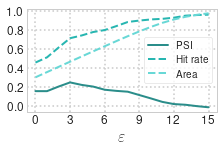

In [53]:
fig, ax = plt.subplots(1,1, figsize=(3,2), sharex=True, sharey=True, constrained_layout=True)

#_ = ax.set_title(bold_text(r'Predictive success index of $\epr{-\varepsilon}{+\varepsilon}$'), fontsize=14)
metrics = {metric: [] for metric in ['Predictive success index', 'Hit rate', 'Area']}

eps_range = np.arange(0,16,1)

for eps in eps_range:
    df_results = Selten_index_BB_nonBB(eps1=eps, eps2=eps)

    for col in df_results.columns:
        metrics[col].append(df_results.loc['All', col])

colours = {'$\mathrm{PSI}$': teal_palette[0], 'Hit rate': teal_palette[1], 'Area': teal_palette[2]}
legend_elements = []

for metric, values in metrics.items():
    if metric == 'Predictive success index':
        metric = '$\mathrm{PSI}$'
        linestyle = 'solid'
    else:
        linestyle = 'dashed'
        
    _ = ax.plot(eps_range, values, color=colours[metric],
                linestyle=linestyle, linewidth=2)        
    legend_elements.append(Line2D([0], [0], color=colours[metric], lw=2,
                                  linestyle=linestyle, label=metric))

xticks = np.arange(0,16,3)
_ = ax.set_xticks(xticks)
_ = ax.set_xticklabels(xticks, fontsize=12)
_ = ax.set_xlabel(r'$\varepsilon$', fontsize=16)

yticks = np.arange(0,1.1,0.2).round(1)
_ = ax.set_yticks(yticks)
_ = ax.set_yticklabels(yticks, fontsize=12)
    
_ = ax.legend(handles=legend_elements, fontsize=10, loc='center right')

index_max = metrics['Predictive success index'].index(max(metrics['Predictive success index']))
print('Max PSI at eps={}'.format(eps_range[index_max]))

_ = plt.savefig('Figures/Paper/Selten_index_extendedCE.pdf', bbox_inches='tight')

non-Black Box: max PSI at eps=3
Black Box: max PSI at eps=3


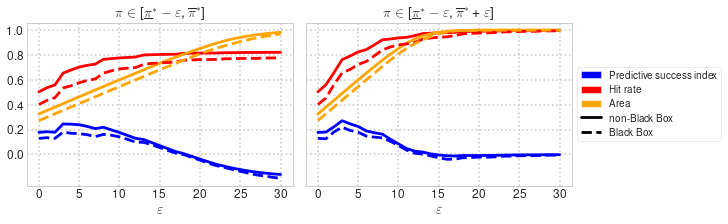

In [54]:
fig, ax = plt.subplots(1,2, figsize=(10,3), sharex=True, sharey=True, constrained_layout=True)

for j in range(2):
    if j == 0:
        title = r'$\pi \in \epr{-\varepsilon}{}$'
    else:
        title = r'$\pi \in \epr{-\varepsilon}{+\varepsilon}$'
        
    metrics = {(idx, metric): [] for (idx, metric) in itertools.product(['non-Black Box', 'Black Box'], ['Predictive success index', 'Hit rate', 'Area'])}
    eps_range = range(0,31,1)

    for eps1 in eps_range:
        if j == 0:
            eps2 = 0
        else:
            eps2 = eps1
            
        df_results = Selten_index_BB_nonBB(eps1=eps1, eps2=eps2)

        for idx in ['non-Black Box', 'Black Box']:
            for col in df_results.columns:
                metrics[(idx, col)].append(df_results.loc[idx, col])

    colours = {'Predictive success index': 'blue', 'Hit rate': 'red', 'Area': 'orange'}
    styles = {'Black Box': 'dashed', 'non-Black Box': 'solid'}

    for (idx, metric), values in metrics.items():
        _ = ax[j].plot(eps_range, values, color=colours[metric], linestyle=styles[idx])
    
    xticks = np.arange(0,31,5)
    _ = ax[j].set_xticks(xticks)
    _ = ax[j].set_xticklabels(xticks, fontsize=12)
    _ = ax[j].set_xlabel(r'$\varepsilon$', fontsize=14)
    
    yticks = np.arange(0,1.1,0.2).round(1)
    _ = ax[j].set_yticks(yticks)
    _ = ax[j].set_yticklabels(yticks, fontsize=12)

    _ = ax[j].set_title(title, fontsize=14)
    
legend_elements = [Patch(facecolor='blue', label='Predictive success index'),
                   Patch(facecolor='red', label='Hit rate'),
                   Patch(facecolor='orange', label='Area'),
                   Line2D([0], [0], color='black', label='non-Black Box'),
                   Line2D([0], [0], color='black', linestyle='dashed', label='Black Box')]
    
_ = ax[1].legend(handles=legend_elements, fontsize=10, loc='center left', bbox_to_anchor=(1, 0.5))

for idx in ['non-Black Box', 'Black Box']:
    index_max = metrics[(idx, 'Predictive success index')].index(max(metrics[(idx, 'Predictive success index')]))
    print('{}: max PSI at eps={}'.format(idx, eps_range[index_max]))

In [55]:
printmd(r'**$\pi \in \epr{-3}{}$, all rounds**')
df_results = Selten_index_BB_nonBB(eps1=3, eps2=0)
df_results.round(2)
# print(df_results.round(2).to_latex())

printmd(r'**$\pi \in \epr{-3}{+3}$, all rounds**')
df_results = Selten_index_BB_nonBB(eps1=3, eps2=3)
df_results.round(2)
# print(df_results.round(2).to_latex())

**$\pi \in \epr{-3}{}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
non-Black Box,0.25,0.65,0.41
Black Box,0.18,0.53,0.35
All,0.22,0.60,0.38


**$\pi \in \epr{-3}{+3}$, all rounds**

,Predictive success index,Hit rate,Area
Treatments,,,
non-Black Box,0.27,0.76,0.49
Black Box,0.22,0.66,0.44
All,0.25,0.71,0.47


In [56]:
def Selten_eps3(dfr, treatment, game, rnd, eps1=3, eps2=3):
    return Selten_index(dfr, treatment, game, rnd, output='SI', eps1=eps1, eps2=eps2)

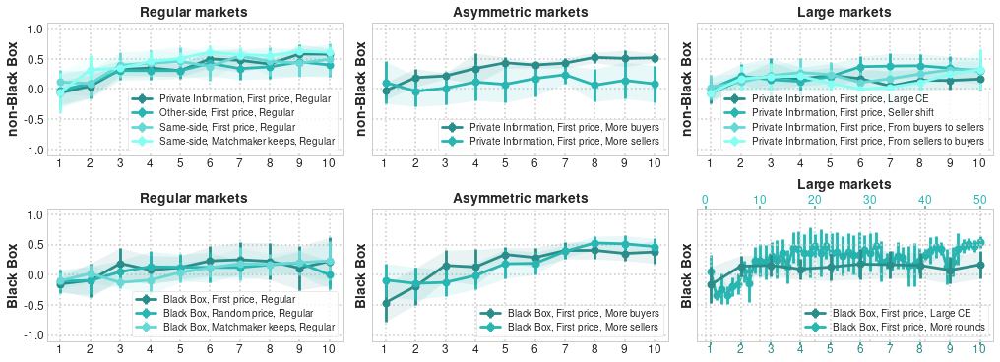

In [57]:
treatment_grid_combined(treatment_groups, Selten_eps3, 'sdev', teal_palette)
_ = plt.savefig('Figures/Paper/Selten_index.pdf', bbox_inches='tight')

In [58]:
df_SeltenIndex_groups3 = Selten_index_groups(eps1=3, eps2=3)
df_SeltenIndex_groups3.round(2)
#print(df_SeltenIndex_groups3.round(2).to_latex())

Rounds                                         All                 \
Metrics                   Predictive success index Hit rate  Area   
Feedback      Market type                                           
non-Black Box Large                           0.19     0.74  0.55   
              Regular                         0.39     0.80  0.40   
              Asymmetric                      0.23     0.75  0.51   
Black Box     Large                           0.28     0.76  0.48   
              Regular                         0.11     0.45  0.35   
              Asymmetric                      0.23     0.68  0.45   

Rounds                                   Last five                 
Metrics                   Predictive success index Hit rate  Area  
Feedback      Market type                                          
non-Black Box Large                           0.23     0.79  0.55  
              Regular                         0.52     0.92  0.40  
              Asymmetric                      0.31     0.81  0.50  
Black Box     Large                           0.39     0.94  0.56  
              Regular                         0.19     0.53  0.35  
              Asymmetric                      0.40     0.84  0.44

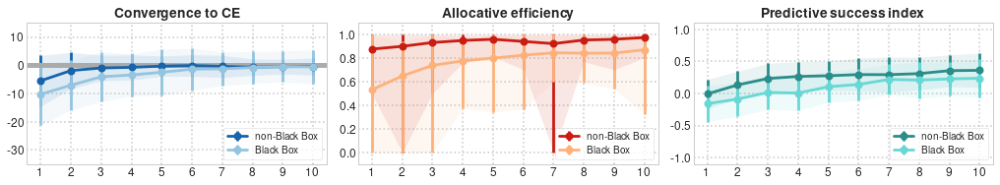

In [59]:
fig, ax = plt.subplots(1,3, figsize=(14,2.5), sharex=True, constrained_layout=True)

df10 = df[df['round'] <= 10].copy()

df10_BB = df10[df10['treatment'].isin(BB_treatments)]
df10_nonBB = df10[~df10['treatment'].isin(BB_treatments)]

rows = [('non-Black Box', df10_nonBB, 0), ('Black Box', df10_BB, 2)]
cols = [(0, distances_to_EPR, 'sdev', blue_palette, 'Convergence to CE'),
        (1, allocative_efficiency, 'minmax', red_palette, 'Allocative efficiency'),
        (2, Selten_eps3, 'sdev', teal_palette, 'Predictive success index')]

for (label, data, colour_id) in rows:
    for (col, fun, errorbar_type, palette, title) in cols:
        mean_evolution(ax[col], data, fun, errorbar_type, alpha=0.1,
                       **{'colour': palette[colour_id], 'label': label})
        grid_layout(ax[col], fun) 
        _ = ax[col].legend(loc='lower right', fontsize=10)
        _ = ax[col].set_title(bold_text(title), fontsize=14)

_ = plt.savefig('Figures/Paper/AllMarkets_CE_AE_SI.pdf', bbox_inches='tight')

In [60]:
df_SeltenIndex_BBnonBB3 = Selten_index_BB_nonBB(eps1=3, eps2=3).round(2)
df_SeltenIndex_BBnonBB3
print(df_SeltenIndex_BBnonBB3.round(2).to_latex())

,Predictive success index,Hit rate,Area
Treatments,,,
non-Black Box,0.27,0.76,0.49
Black Box,0.22,0.66,0.44
All,0.25,0.71,0.47


\begin{tabular}{lrrr}
\toprule
{} &  Predictive success index &  Hit rate &  Area \\
Treatments    &                           &           &       \\
\midrule
non-Black Box &                      0.27 &      0.76 &  0.49 \\
Black Box     &                      0.22 &      0.66 &  0.44 \\
All           &                      0.25 &      0.71 &  0.47 \\
\bottomrule
\end{tabular}



## Initial demands

In [61]:
df['demand'] = abs(df['valuation'] - df['bid'])
df['reldemand'] = df['demand']/df['valuation']

**Initial bid** = a bid submitted before receiving any feedback whatsoever, i.e.,
- **BlackBox**: each player's first bid
- **Full**: bids submitted (simultaneously) at the very first time step
- **Same**: first (simultaneous) sell-side bids and first (simultaneous) buy-side bids
- **Other**: first bids submitted by players from the side to bid first which precede the other side's first bid

In [62]:
df['initial_bid'] = False

def player_first_bids(df_subset):
    for idx, dfi in df_subset.groupby(['id']):
        first_bid = dfi.nsmallest(1, ['round','time'])
        df.loc[first_bid.index, 'initial_bid'] = True    

for (treatment, game), df_game in df.groupby(['treatment', 'game']):
    if 'BB' in treatment:
        player_first_bids(df_game)
    
    elif 'Full' in treatment:
        game_first_bids = df_game.nsmallest(1, ['round', 'time'], keep='all')
        player_first_bids(game_first_bids)
        
    elif 'Same' in treatment:
        for side, df_side in df_game.groupby(['side']):
            side_first_bids = df_side.nsmallest(1, ['round', 'time'], keep='all')
            player_first_bids(side_first_bids)
            
    elif 'Other' in treatment:
        first_side = df_game.nsmallest(1, ['round', 'time'])['side'].iloc[0]
        other_first_bid = df_game[df_game['side'] != first_side].nsmallest(1, ['round', 'time']).iloc[0]

        df_first_side = df_game[df_game['side'] == first_side]
        other_preceding_bids = df_first_side[(df_first_side['round'] < other_first_bid['round']) | 
                                       ((df_first_side['round'] == other_first_bid['round']) & (df_first_side['time'] <= other_first_bid['time']))]
        player_first_bids(other_preceding_bids)

### Comparison across treatments

Notes:
1. Non-Black Box treatments are not plotted separately due to the small numbers of initial bids.
2. Linear (resp. symmetrical logarithmic) scale is used to plot relative (resp. absolute) demands.
3. To make figures with a linear scale more visually appealing, sellers' asks that exceed the value of 250 are not plotted (this applies to 3% of the data, that is, 2,322 observations out of a total of 77,618 observations – see ``df_truncated`` below).
4. To avoid $\log{0}$, a symmetrical logarithmic scale with ```linthresh``` set to 3* is used (i.e., the plot is linear within ```(-linthresh, linthresh)``` and logarithmic elsewhere). 

<sub>[*] 3 was chosen at a later stage to always use a linear scale when plotting nonoutlier sellers' asks.</sub>

In [63]:
bid_q97 = df['bid'].quantile(.97)
print('97th quantile:', bid_q97)
df_truncated = df[df['bid'] <= bid_q97].copy()

print('Total number of samples:', len(df))
print('Samples in the truncated dataset:', len(df_truncated))

97th quantile: 250.0
Total number of samples: 77618
Samples in the truncated dataset: 75296


```symlog``` below manually computes symmetrical log and as such handles a broader range of use cases than [matplotlib's symlog scale](https://matplotlib.org/3.1.1/api/scale_api.html#matplotlib.scale.SymmetricalLogScale)

In [64]:
def symlog(x, linthresh=3):
    if x <= linthresh:
        return x
    else:
        return np.log10(x)

In [65]:
def initial_demand_subplot(ax, df, scale, title, bins=None):    
    df_initial_demands = df[df['initial_bid']]

    # Relative demands are bounded below by zero
    if scale in ['relative', 'midpointCE']:
        _ = ax.axvline(x=0, linestyle='solid', linewidth=5.0,
                       color='darkgrey', alpha=0.8, zorder=0)
    
    initial_demands = {}
    
    for side, df_side in df_initial_demands.groupby(['side']):
        if scale == 'relative':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['reldemand']
        elif scale == 'log':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['demand'].apply(symlog)
        elif scale == 'midpointCE':
            initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side]['rescaledBid']
            
    if bins is None:
        bins = np.histogram(np.hstack(list(initial_demands.values())), bins=8)[1]
    
    for side, vals in initial_demands.items():
        _ = sns.histplot(vals, label = '{}s'.format(side), stat='density',
                         ax=ax, bins=bins, color=side_colours[side], kde=True, kde_kws={'cut': 3})

    if scale == 'log':
        xticks = ax.get_xticks()
        _ = ax.set_xticks(xticks)
        _ = ax.set_xticklabels([r'$10^{{{}}}$'.format(int(x)) for x in xticks])
    
    _ = ax.set_xlabel('')
    _ = ax.set_ylabel('')

    _ = ax.set_title(title, fontsize=14)
    
def initial_demand_grid(rows, columns, treatments, suptitle, scale):
    (rows, columns) = np.shape(treatments)
    fig, ax = plt.subplots(rows, columns, figsize=(14,2.5*rows), 
                           sharex=True, sharey=True, constrained_layout=True)
    ax = ax.flatten()

    if scale == 'relative':
        data = df_truncated
        var = 'reldemand'
    elif scale == 'midpointCE':
        data = df_truncated
        var = 'rescaledBid'
    elif scale == 'log':
        data = df
        var = 'demand'
    
    # Same bins across all histograms
    all_initial_demands = {}
    df_initial_demands = data[data['initial_bid']]
    
    for side, df_side in df_initial_demands.groupby(['side']):
        all_initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side][var]
        
        if scale == 'log':
            all_initial_demands[side] = all_initial_demands[side].apply(symlog)
    
    bins = np.histogram(np.hstack(list(all_initial_demands.values())), bins=12)[1]
    
    for idx, treatment in enumerate(flatten_list(treatments)):
        if not treatment is None:
            initial_demand_subplot(ax[idx], data[data['treatment'] == treatment], scale=scale,
                                   title=treatment_names[treatment], bins=bins)
        
    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
            
    return fig, ax, bins

#### Initial relative demands

Histograms and Gaussian kernel density estimates of the initial demands for payoff relative to the valuations, as expressed by $(\bval{i} - \bbid{i}{1})/\bval{i}$ and $(\sbid{j}{1} - \sval{j})/\sval{j}$ for buyers $b_i \in B$ and sellers $s_j \in S$, respectively. Note that bids/asks that would result in negative payoffs are not permitted.

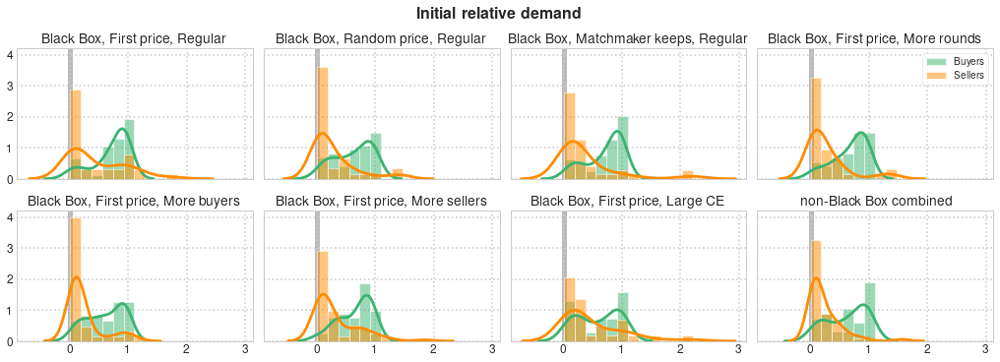

In [66]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', None]]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial relative demand', scale='relative')
ax = ax.flatten()

initial_demand_subplot(ax[7], df_truncated[df_truncated['treatment'].isin(all_treatments.difference(BB_treatments))],
                      scale='relative', title='non-Black Box combined', bins=bins)

_ = ax[3].legend(loc='upper right', fontsize=10)    
    
_ = plt.savefig('Figures/InitialRelDemands_treatmets.pdf', bbox_inches='tight')

#### Initial log demands versus initial relative demands

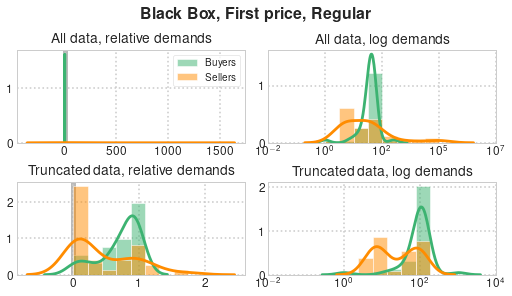

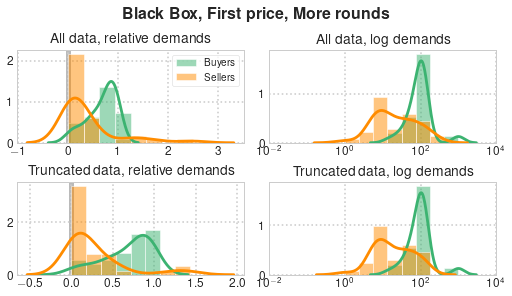

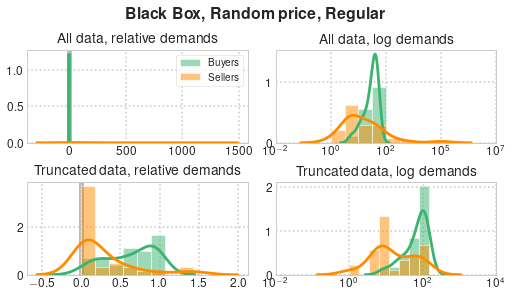

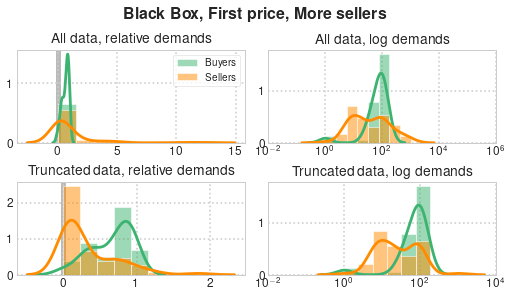

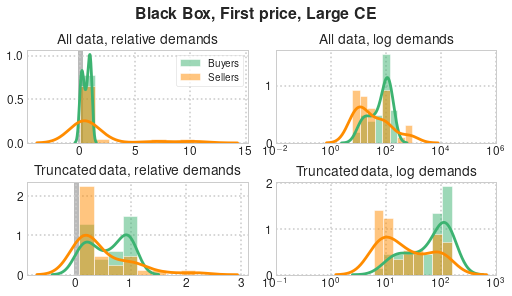

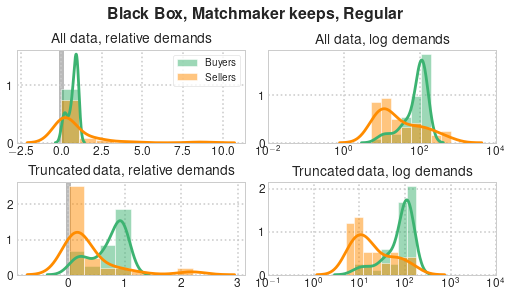

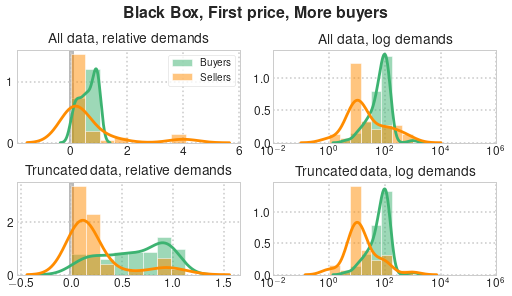

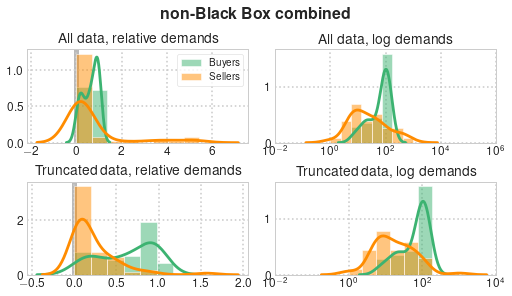

In [67]:
def initial_demand_scale_comparison(treatment, suptitle):
    data = {'all': df, 'truncated': df_truncated}

    fig, ax = plt.subplots(2,2, figsize=(7,4), constrained_layout=True)
    ax = ax.flatten()
    
    for idx, (data_filter, scale) in enumerate(itertools.product(['all', 'truncated'], ['relative', 'log'])): 
        df_treatment = data[data_filter]
        df_treatment = df_treatment[df_treatment['treatment'].isin(treatment)]
        initial_demand_subplot(ax[idx], df_treatment, scale=scale,
                               title='{} data, {} demands'.format(data_filter.capitalize(), scale))
         
    _ = ax[0].legend(fontsize=10)
    _ = plt.suptitle(bold_text(suptitle), fontsize=16)
    _ = plt.show()   

for treatment in BB_treatments:
    initial_demand_scale_comparison([treatment], treatment_names[treatment])
    
initial_demand_scale_comparison(all_treatments.difference(BB_treatments), 'non-Black Box combined')

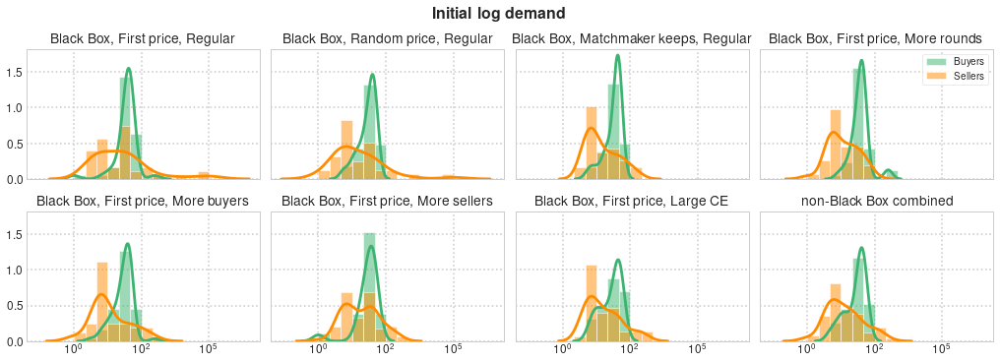

In [68]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', None]]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial log demand', scale='log')
ax = ax.flatten()

initial_demand_subplot(ax[7], df[df['treatment'].isin(all_treatments.difference(BB_treatments))],
                      scale='log', title='non-Black Box combined', bins=bins)
_ = plt.setp(ax[7], xlim=ax[0].get_xlim())

_ = ax[3].legend(loc='upper right', fontsize=10)

#### Initial bids/asks shifted and scaled by the CE midpoint

Histograms and Gaussian kernel density estimates of the first bids/asks submitted by the market participants shifted and scaled by the midpoint $\pi_M^* := (\underline \pi^* + \overline \pi^*)/2$ of the CE price range $\epr{}{}$. That is, $(\bbid{i}{1} - \pi_M^*)/\pi_M^*$ and $(\sbid{j}{1} - \pi_M^*)/\pi_M^*$ are reported for buyers $b_i \in B$ and sellers $s_j \in S$, respectively.

Note: again, sellers' asks that exceed the value of 250 are not plotted

In [69]:
def rescale_CErange(x, a, b):
    avg = (a+b)/2
    return (x - avg)/avg

In [70]:
for (treatment, game, rnd), dfr in df_truncated.groupby(['treatment', 'game', 'round']):
    [epr1,epr2] = EPR_rounds[treatment, game, rnd]

    df_truncated.loc[dfr.index, 'rescaledBid'] = dfr['bid'].apply(rescale_CErange, args=(epr1, epr2))

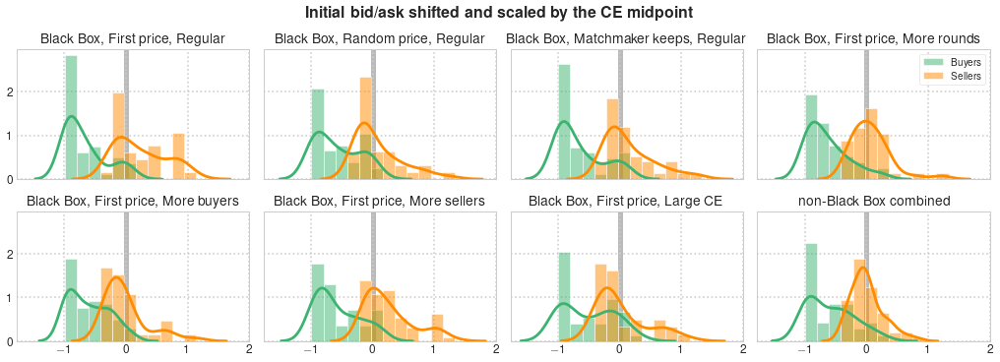

In [71]:
treatments = [['BB', 'BBRandom', 'BBMMK', 'BBMoreRounds'], ['BBMoreB', 'BBMoreS', 'BBLargeCE', None]]

fig, ax, bins = initial_demand_grid(2, 4, treatments, 'Initial bid/ask shifted and scaled by the CE midpoint', 
                                    scale='midpointCE')
ax = ax.flatten()

initial_demand_subplot(ax[7], df_truncated[df_truncated['treatment'].isin(all_treatments.difference(BB_treatments))],
                      scale='midpointCE', title='non-Black Box combined', bins=bins)
_ = ax[7].set_xlabel('')

_ = ax[3].legend(loc='upper right', fontsize=10)    

#### Median initial relative demands

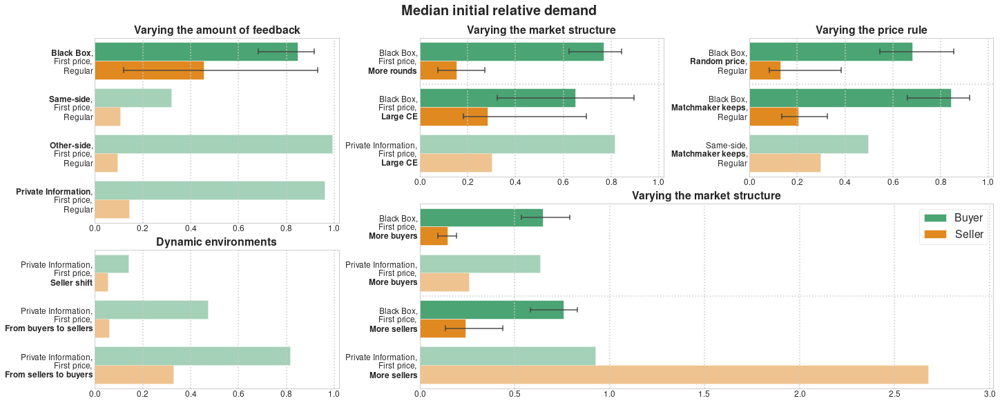

In [72]:
fig = plt.figure(constrained_layout=True, figsize=(20,8))
gs = fig.add_gridspec(7,9)

ax = []
ax.append(fig.add_subplot(gs[0:4, 0:3]))
ax.append(fig.add_subplot(gs[0:3, 6:9], sharex=ax[0]))
ax.append(fig.add_subplot(gs[0:3, 3:6], sharex=ax[0]))
ax.append(fig.add_subplot(gs[3:7, 3:9]))
ax.append(fig.add_subplot(gs[4:7, 0:3], sharex=ax[0]))

treatment_grid_arrangement = {'feedback': ['BB', 'Same', 'Other', 'Full'],
                              'price': ['BBRandom', 'BBMMK', 'SameMMK'],
                              'structure_1': ['BBMoreRounds', 'BBLargeCE','FullLargeCE'],
                              'structure_2': ['BBMoreB','FullMoreB','BBMoreS','FullMoreS'],
                              'dynamics': ['FullSShift', 'FullFromBtoS', 'FullFromStoB']}

for idx, (key, treatments) in enumerate(treatment_grid_arrangement.items()):
    dim = key.split('_')[0]
    title = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]

    data = df[(df['initial_bid']) & (df['treatment'].isin(treatments))]

    sfig = sns.barplot(y='treatment', x='reldemand', hue='side', data=data, ax=ax[idx],
                       zorder=-100, palette=side_colours, hue_order=['Buyer', 'Seller'],
                       order=treatments, ci=95, estimator=np.median, **{'capsize':0.1})
 
    # Subplot layout
    _ = ax[idx].set_xlabel('')
    
    if 'FullMoreS' in treatments:
        _ = ax[idx].set_xlim((0,3.02))
        _ = ax[idx].legend(title=None, fontsize=16)
    else:
        _ = ax[idx].set_xlim((0,1.02))
        _ = ax[idx].legend_.remove()
    
    _ = ax[idx].set_ylabel('') 
    _ = ax[idx].set_yticks(ax[idx].get_yticks().tolist())
    _ = ax[idx].set_yticklabels([emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part).replace(',', ',\n') for treatment in treatments])
    
    _ = ax[idx].set_title(bold_text(title), fontsize=16)
    
    # Remove error bars and change transparency when there is only a small number of initial bids
    kept_lines = []
    wrap_lines = int(len(ax[idx].lines)/2)
    wrap_patches = int(len(ax[idx].patches)/2)
    
    for (j, treatment) in enumerate(ax[idx].get_ymajorticklabels()):
        if 'Black Box' in treatment.get_text():
            kept_lines.extend(ax[idx].lines[3*j:3*j+3]) # buyer error bars
            kept_lines.extend(ax[idx].lines[3*j+wrap_lines:3*j+wrap_lines+3]) # seller error bars
        else:
            ax[idx].patches[j].set_alpha(0.5)
            ax[idx].patches[j+wrap_patches].set_alpha(0.5)
            
    ax[idx].lines = kept_lines
    
    for line in ax[idx].lines:
        line.set_alpha(0.7)
        line.set_linewidth(2)

# Add separators to group related treatments
for idx, yticks in zip([1,2,3],[[0.5],[0.5],[1.5]]):
    _ = ax[idx].yaxis.grid(True, which='minor')
    _ = ax[idx].set_yticks(yticks, minor=True)

_ = fig.suptitle(bold_text('Median initial relative demand'), fontsize=20)

_ = plt.savefig('Figures/MedianInitialRelDemands.pdf', bbox_inches='tight')

Mann–Whitney–Wilcoxon rank-sum tests to compare differences between buyers and sellers

In [73]:
index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()],
                 name='Treatment')

dtypes = {('Median initial bid vs. ask', 'Buyers'): float, ('Median initial bid vs. ask', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int, ('MWW', '$p$-value'): float}
columns = pd.MultiIndex.from_tuples(dtypes.keys())

df_initial_reldemands = pd.DataFrame(index=index, columns=columns)

def initial_reldemands_add_row(idx, df, MWW=False):
    initial_reldemands = []
    
    for side, df_side in df.groupby(['side']):        
        df_initial_reldemands.loc[idx, ('Median initial bid vs. ask', '{}s'.format(side))] = df_side['reldemand'].median()
        df_initial_reldemands.loc[idx, ('Sample size', '{}s'.format(side))] = df_side['reldemand'].size
        initial_reldemands.append(df_side['reldemand'])
        
    if MWW:
        U, p = stats.mannwhitneyu(*initial_reldemands)
        df_initial_reldemands.loc[idx, ('MWW', '$p$-value')] = p        

initial_bids = df[df['initial_bid']]

for treatment, df_treatment in initial_bids.groupby(['treatment']):
    idx = treatment_names[treatment]

    if 'BB' in treatment:
        MWW = True
    else:
        MWW = False
    
    initial_reldemands_add_row(idx, df_treatment, MWW=MWW)

initial_reldemands_add_row('non-Black Box combined', initial_bids[~initial_bids['treatment'].isin(BB_treatments)], MWW=True)
initial_reldemands_add_row('Black Box combined', initial_bids[initial_bids['treatment'].isin(BB_treatments)], MWW=True)
initial_reldemands_add_row('All treatments', initial_bids, MWW=True)

df_initial_reldemands = df_initial_reldemands.astype(dtype=dtypes)

In [74]:
df_initial_reldemands.round(2)
# print(df_initial_reldemands.round(2).to_latex())

Median initial bid vs. ask  \
                                                                       Buyers   
Treatment                                                                       
Private Information, First price, Regular                                0.96   
Other-side, First price, Regular                                         0.99   
Same-side, First price, Regular                                          0.32   
Same-side, Matchmaker keeps, Regular                                     0.50   
Black Box, Random price, Regular                                         0.68   
Black Box, Matchmaker keeps, Regular                                     0.84   
Black Box, First price, Regular                                          0.85   
Private Information, First price, More sellers                           0.93   
Black Box, First price, More sellers                                     0.76   
Private Information, First price, More buyers                            0.63   
Black Box, First price, More buyers                                      0.65   
Private Information, First price, From buyers t...                       0.47   
Private Information, First price, From sellers ...                       0.82   
Private Information, First price, Large CE                               0.81   
Black Box, First price, Large CE                                         0.65   
Private Information, First price, Seller shift                           0.14   
Black Box, First price, More rounds                                      0.77   
non-Black Box combined                                                   0.67   
Black Box combined                                                       0.76   
All treatments                                                           0.76   

                                                           Sample size  \
                                                   Sellers      Buyers   
Treatment                                                                
Private Information, First price, Regular             0.14           3   
Other-side, First price, Regular                      0.09           3   
Same-side, First price, Regular                       0.11           7   
Same-side, Matchmaker keeps, Regular                  0.30           4   
Black Box, Random price, Regular                      0.13          40   
Black Box, Matchmaker keeps, Regular                  0.20          43   
Black Box, First price, Regular                       0.46          42   
Private Information, First price, More sellers        2.68           1   
Black Box, First price, More sellers                  0.24          44   
Private Information, First price, More buyers         0.26           6   
Black Box, First price, More buyers                   0.14          74   
Private Information, First price, From buyers t...    0.06           2   
Private Information, First price, From sellers ...    0.33           4   
Private Information, First price, Large CE            0.30           4   
Black Box, First price, Large CE                      0.28          38   
Private Information, First price, Seller shift        0.05           3   
Black Box, First price, More rounds                   0.15          40   
non-Black Box combined                                0.14          37   
Black Box combined                                    0.19         321   
All treatments                                        0.19         358   

                                                                 MWW  
                                                   Sellers $p$-value  
Treatment                                                             
Private Information, First price, Regular                5       NaN  
Other-side, First price, Regular                        10       NaN  
Same-side, First price, Regular                          6       NaN  
Same-side, Matchmaker keeps, Regular                     8

### Black Box versus non-Black Box

In [75]:
def initial_BB_nonBB(scale):
    fig, ax = plt.subplots(1,2, figsize=(8,2), sharex=True, sharey=True,
                           constrained_layout=True)

    if scale == 'relative':
        data = df_truncated
        var = 'reldemand'
    elif scale == 'midpointCE':
        data = df_truncated
        var = 'rescaledBid'
    elif scale == 'log':
        data = df
        var = 'demand'
    
    subplots = {'non-Black Box': data[~data['treatment'].isin(BB_treatments)],
                'Black Box': data[data['treatment'].isin(BB_treatments)]}

    # Same bins across all histograms
    all_initial_demands = {}
    df_initial_demands = data[data['initial_bid']]

    for side, df_side in df_initial_demands.groupby(['side']):
        all_initial_demands[side] = df_initial_demands[df_initial_demands['side'] == side][var]

        if scale == 'log':
            all_initial_demands[side] = all_initial_demands[side].apply(symlog)
            
    bins = np.histogram(np.hstack(list(all_initial_demands.values())), bins=12)[1]

    for idx, (title, data) in enumerate(subplots.items()):
        initial_demand_subplot(ax[idx], df=data, scale=scale, title=bold_text(title), bins=bins)

    for axi in ax:
        _ = axi.set_xlabel('')
        _ = axi.set_ylabel('')

    _ = ax[1].legend(fontsize=10)
    
    return fig, ax

#### Initial relative demands

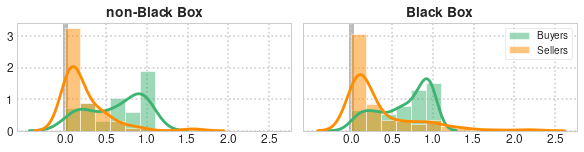

In [76]:
fig, ax = initial_BB_nonBB('relative')

for axi in ax:
    xticks = np.arange(0,2.6,0.5).round(1)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xticklabels(xticks, size=12)
    
_ = plt.savefig('Figures/Paper/InitialRelDemands.pdf', bbox_inches='tight')

In [77]:
df_initial_BB_nonBB = df_initial_reldemands.loc[df_initial_reldemands.index.str.contains('combined')].copy()
df_initial_BB_nonBB.index = df_initial_BB_nonBB.index.str.replace('combined', '')

df_initial_BB_nonBB.index.names = ['Treatments']
df_initial_BB_nonBB.round(2)
# print(df_initial_BB_nonBB.round(2).to_latex())

Median initial bid vs. ask         Sample size          \
                                   Buyers Sellers      Buyers Sellers   
Treatments                                                              
non-Black Box                        0.67    0.14          37      62   
Black Box                            0.76    0.19         321     317   

                     MWW  
               $p$-value  
Treatments                
non-Black Box        0.0  
Black Box            0.0

#### Initial log demands

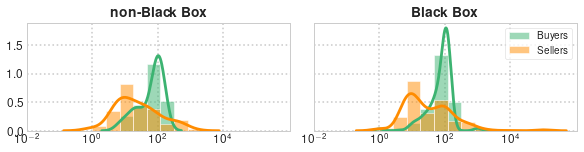

In [78]:
fig, ax = initial_BB_nonBB('log')

for axi in ax:
    xticks = np.arange(-2,5,2)
    _ = axi.set_xticks(xticks)
    _ = axi.set_xticklabels([r'$10^{{{}}}$'.format(int(x)) for x in xticks], size=12)

#### Initial bids/asks shifted and scaled by the CE midpoint

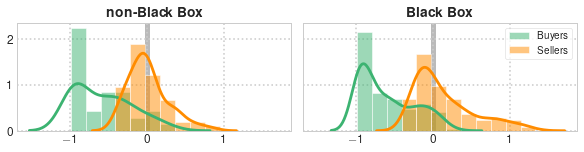

In [79]:
fig, ax = initial_BB_nonBB('midpointCE')

## Within-round demand adjustments

Relative-demand adjustment in round $T$:

Buyers:
\begin{equation*}
    \frac{\bval{i} - \bbid{i}{k, T}}{\bval{i}} - \frac{\bval{i} - \bbid{i}{k - 1, T}}{\bval{i}} = -\Delta \bbid{i}{k, T}/\bval{i},
\end{equation*}

Sellers:
\begin{equation*}
    \frac{\sbid{j}{k, T} - \sval{j}}{\sval{j}} - \frac{\sbid{j}{k - 1, T} - \sval{j}}{\sval{j}} = \Delta \sbid{j}{k, T}/\sval{j}
\end{equation*}

In [80]:
df['adjWithin'] = df.groupby(['treatment', 'game', 'round', 'id'])['reldemand'].diff()

### Comparison across treatments

In [81]:
index = pd.Index([treatment_names[treatment] for treatment in df['treatment'].unique()],
                 name='Treatment')

dtypes = {('Median within-round bid/ask adjustment', 'Buyers'): float, ('Median within-round bid/ask adjustment', 'Sellers'): float, ('MWW', '$p$-value'): float,
          ('Non-positive within-round bid/ask adjustment', 'Buyers'): float, ('Non-positive within-round bid/ask adjustment', 'Sellers'): float,
          ('Sample size', 'Buyers'): int, ('Sample size', 'Sellers'): int}
columns = pd.MultiIndex.from_tuples(dtypes.keys())

df_within_round_adjustments = pd.DataFrame(index=index, columns=columns)

def within_round_adjustments_add_row(idx, df):
    for side, df_side in df.groupby(['side']):
        df_within_round_adjustments.loc[idx, ('Median within-round bid/ask adjustment', '{}s'.format(side))] = df_side['adjWithin'].median()
        
        n_nonPositive = df_side[df_side['adjWithin'] <= 0]['adjWithin'].count()
        n_all = df_side['adjWithin'].count()
        df_within_round_adjustments.loc[idx, ('Non-positive within-round bid/ask adjustment', '{}s'.format(side))] = n_nonPositive/n_all*100
        df_within_round_adjustments.loc[idx, ('Sample size', '{}s'.format(side))] = n_all
    
    U, p = stats.mannwhitneyu(df[df['side'] == 'Buyer']['adjWithin'], df[df['side'] == 'Seller']['adjWithin'])
    df_within_round_adjustments.loc[idx, ('MWW', '$p$-value')] = p
    
for treatment, df_treatment in df.groupby(['treatment']):
    idx = treatment_names[treatment]
    within_round_adjustments_add_row(idx, df_treatment)

within_round_adjustments_add_row('non-Black Box combined', df[~df['treatment'].isin(BB_treatments)])
within_round_adjustments_add_row('Black Box combined', df[df['treatment'].isin(BB_treatments)])

df_within_round_adjustments = df_within_round_adjustments.astype(dtype=dtypes)

In [82]:
columns_round = {('Median within-round bid/ask adjustment', 'Buyers'): 2, ('Median within-round bid/ask adjustment', 'Sellers'): 2, ('MWW', '$p$-value'): 2,
                 ('Non-positive within-round bid/ask adjustment', 'Buyers'): 0, ('Non-positive within-round bid/ask adjustment', 'Sellers'): 0}
dtypes = {('Non-positive within-round bid/ask adjustment', 'Buyers'): int, ('Non-positive within-round bid/ask adjustment', 'Sellers'): int}
add_percentage = lambda col: col.astype(str) + '%' if 'Non-positive' in col.name[0] else col

df_within_round_adjustments.round(columns_round).astype(dtypes).apply(add_percentage)
# df_within_round_adjustments.round(columns_round).astype(dtypes).apply(add_percentage).to_latex()

Median within-round bid/ask adjustment  \
                                                                                   Buyers   
Treatment                                                                                   
Private Information, First price, Regular                                            0.00   
Other-side, First price, Regular                                                     0.00   
Same-side, First price, Regular                                                      0.00   
Same-side, Matchmaker keeps, Regular                                                 0.00   
Black Box, Random price, Regular                                                    -0.04   
Black Box, Matchmaker keeps, Regular                                                -0.02   
Black Box, First price, Regular                                                     -0.02   
Private Information, First price, More sellers                                      -0.01   
Black Box, First price, More sellers                                                -0.03   
Private Information, First price, More buyers                                        0.00   
Black Box, First price, More buyers                                                 -0.02   
Private Information, First price, From buyers t...                                  -0.01   
Private Information, First price, From sellers ...                                  -0.02   
Private Information, First price, Large CE                                          -0.02   
Black Box, First price, Large CE                                                    -0.02   
Private Information, First price, Seller shift                                      -0.01   
Black Box, First price, More rounds                                                 -0.03   
non-Black Box combined                                                               0.00   
Black Box combined                                                                  -0.02   

                                                                 MWW  \
                                                   Sellers $p$-value   
Treatment                                                              
Private Information, First price, Regular             0.00      0.03   
Other-side, First price, Regular                      0.00      0.01   
Same-side, First price, Regular                       0.00      0.09   
Same-side, Matchmaker keeps, Regular                  0.00      0.18   
Black Box, Random price, Regular                     -0.01      0.00   
Black Box, Matchmaker keeps, Regular                 -0.01      0.00   
Black Box, First price, Regular                      -0.02      0.23   
Private Information, First price, More sellers        0.00      0.00   
Black Box, First price, More sellers                 -0.01      0.00   
Private Information, First price, More buyers        -0.03      0.02   
Black Box, First price, More buyers                  -0.04      0.19   
Private Information, First price, From buyers t...   -0.01      0.15   
Private Information, First price, From sellers ...    0.00      0.01   
Private Information, First price, Large CE           -0.02      0.00   
Black Box, First price, Large CE                     -0.02      0.05   
Private Information, First price, Seller shift       -0.03      0.00   
Black Box, First price, More rounds                  -0.02      0.00   
non-Black Box combined                                0.00      0.13   
Black Box combined                                   -0.01      0.00   

                                                   Non-positive within-round bid/ask adjustment  \
                                                                                         Buyers   
Treatment                                                                                         
Private Information, First price, Regular                                                   87%   
Other-side, First price

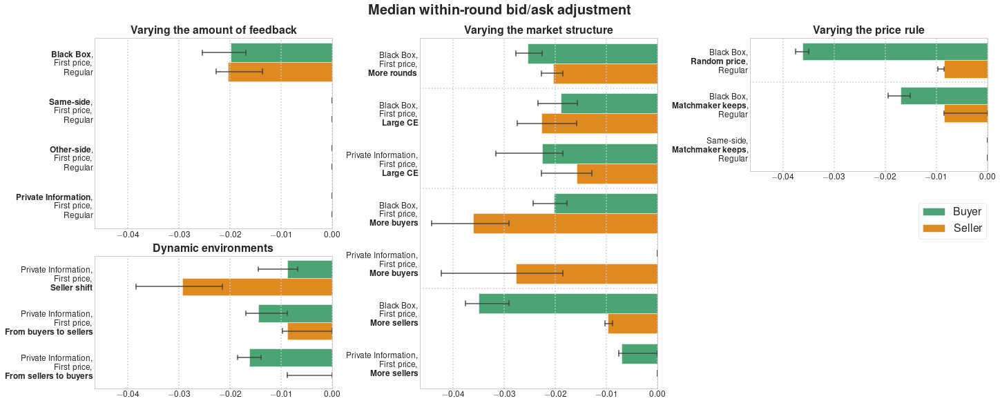

In [83]:
fig = plt.figure(constrained_layout=True, figsize=(20,8))
gs = fig.add_gridspec(7,9)

ax = []
ax.append(fig.add_subplot(gs[0:4, 0:3]))
ax.append(fig.add_subplot(gs[0:3, 6:9], sharex=ax[0]))
ax.append(fig.add_subplot(gs[0:7, 3:6], sharex=ax[0]))
ax.append(fig.add_subplot(gs[4:7, 0:3], sharex=ax[0]))

treatment_grid_arrangement = {'feedback': ['BB', 'Same', 'Other', 'Full'],
                              'price': ['BBRandom', 'BBMMK', 'SameMMK'],
                              'structure': ['BBMoreRounds', 'BBLargeCE', 'FullLargeCE', 'BBMoreB', 'FullMoreB', 'BBMoreS', 'FullMoreS'],
                              'dynamics': ['FullSShift', 'FullFromBtoS', 'FullFromStoB']}

for idx, (key, treatments) in enumerate(treatment_grid_arrangement.items()):
    dim = key.split('_')[0]
    title = treatment_dimensions[dim][1]
    bold_title_part = treatment_dimensions[dim][2]
    
    data = df[df['treatment'].isin(treatments)]

    sfig = sns.barplot(y='treatment', x='adjWithin', hue='side', data=data,
                       ax=ax[idx], zorder=-100,
                       palette=side_colours, hue_order=['Buyer', 'Seller'],
                       order=treatments, ci=95, estimator=np.median, **{'capsize':0.1})
 
    # Subplot layout
    _ = ax[idx].set_xlabel('')
    
    _ = ax[idx].set_ylabel('') 
    _ = ax[idx].set_yticks(ax[idx].get_yticks().tolist())
    _ = ax[idx].set_yticklabels([emphasise_text(treatment_names[treatment], separator=', ', part=bold_title_part).replace(',', ',\n') for treatment in treatments])
    
    _ = ax[idx].set_title(bold_text(title), fontsize=16)
    _ = ax[idx].legend_.remove()
    
    for line in ax[idx].lines:
        line.set_alpha(0.7)
        line.set_linewidth(2)

_ = ax[1].legend(title=None, fontsize=16,
                 loc='upper right', bbox_to_anchor=(1.02, -0.2))
      
# Add separators to group related treatments
for idx, yticks in zip([1,2],[[0.5],[0.5, 2.5, 4.5]]):
    _ = ax[idx].yaxis.grid(True, which='minor')
    _ = ax[idx].set_yticks(yticks, minor=True)

_ = fig.suptitle(bold_text('Median within-round bid/ask adjustment'), fontsize=20)

_ = plt.savefig('Figures/MedianWithinRoundAdjustments.pdf', bbox_inches='tight')

### Black Box versus non-Black Box

In [84]:
df_within_BB_nonBB = df_within_round_adjustments.loc[df_within_round_adjustments.index.str.contains('combined')].copy()
df_within_BB_nonBB.index = df_within_BB_nonBB.index.str.replace('combined', '')

df_within_BB_nonBB.index.names = ['Treatments']
df_within_BB_nonBB.round(columns_round).astype(dtypes).apply(add_percentage)
# print(df_within_BB_nonBB.round(columns_round).astype(dtypes).apply(add_percentage).to_latex())

Median within-round bid/ask adjustment               MWW  \
                                               Buyers Sellers $p$-value   
Treatments                                                                
non-Black Box                                    0.00    0.00      0.13   
Black Box                                       -0.02   -0.01      0.00   

               Non-positive within-round bid/ask adjustment          \
                                                     Buyers Sellers   
Treatments                                                            
non-Black Box                                           86%     87%   
Black Box                                               87%     84%   

               Sample size          
                    Buyers Sellers  
Treatments                          
non-Black Box        16416   18133  
Black Box            13107   13068

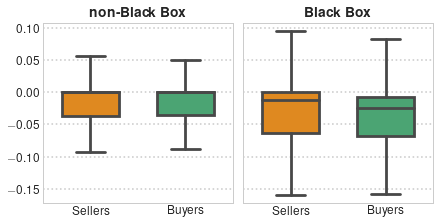

In [85]:
fig, ax = plt.subplots(1,2, figsize=(6,3), sharex=True, sharey=True,
                       constrained_layout=True)

for idx in range(2):
    if idx == 0:
        title = 'non-Black Box'
        data = df[~df['treatment'].isin(BB_treatments)]
    else:
        title = 'Black Box'
        data = df[df['treatment'].isin(BB_treatments)]

    xorder = ['Seller', 'Buyer']
    _ = sns.boxplot(x='side', y='adjWithin', data=data, ax=ax[idx], showfliers=False, 
                    palette=[side_colours[side] for side in xorder], order=xorder, width=0.6)
    
    _ = ax[idx].set_xticklabels(['{}s'.format(x.get_text()) for x in ax[idx].get_xticklabels()])
    _ = ax[idx].set_xlabel('')
    _ = ax[idx].set_ylabel('')
    _ = ax[idx].set_title(bold_text(title))

Comparison of market sides in Black Box versus non-Black Box treatments

In [86]:
df_within_BB_nonBB_pvals = df_within_BB_nonBB.loc[:, ['Median within-round bid/ask adjustment', 'MWW']].copy()
df_within_BB_nonBB_pvals.rename_axis(None, inplace=True)

for side, df_side in df.groupby(['side']):
    U, p = stats.mannwhitneyu(df_side[df_side['treatment'].isin(BB_treatments)]['adjWithin'],
                              df_side[~df_side['treatment'].isin(BB_treatments)]['adjWithin'])
    df_within_BB_nonBB_pvals.loc['$p$-value', ('Median within-round bid/ask adjustment', '{}s'.format(side))] = p

df_within_BB_nonBB_pvals.round(2)
# print(df_within_BB_nonBB_pvals.round(2).to_latex())

Median within-round bid/ask adjustment               MWW
                                               Buyers Sellers $p$-value
non-Black Box                                    0.00    0.00      0.13
Black Box                                       -0.02   -0.01      0.00
$p$-value                                        0.00    0.00       NaN

### Bid/demand as a function of lagged bid/demand

In [87]:
df_lags = df.copy()

# Create a mask to filter Black Box treatments
df_lags['BB'] = df_lags['treatment'].isin(BB_treatments)

# Lagged bids and lagged relative demands
for var in ['bid', 'reldemand']:
    df_lags['{}-1'.format(var)] = df_lags.groupby(['treatment', 'game', 'round', 'id'])[var].shift()

# Create a mask to filter out outlier seller (lagged) bids
df_lags['truncate'] = ~(df_lags[['bid', 'bid-1']] > bid_q97).any(axis=1)

Correlation between bids/asks and previous bids/asks

Overall correlation between bids/asks and previous bids/asks

,Buyers,Sellers
non-Black Box,0.748344,0.107074
Black Box,0.867862,0.797122


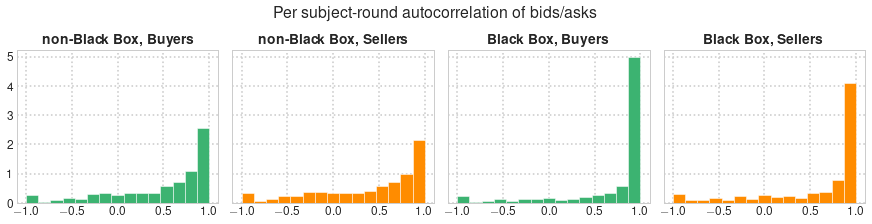

In [88]:
index = pd.Index(['non-Black Box', 'Black Box'])
columns = ['{}s'.format(side) for side in set(df_lags['side'])]
df_autocorr = pd.DataFrame(index=index, columns=columns)

fig, ax = plt.subplots(1,4, figsize=(12,3), sharex=True, sharey=True, constrained_layout=True)
idx = 0

for (BB_flag, side), df_side in df_lags.groupby(['BB', 'side']):
    treatments = 'Black Box' if BB_flag else 'non-Black Box'
    
    df_subjectRounds = df_side.groupby(['treatment','game','round','id'])
    # Only keep subject-rounds with more than two bids/asks submitted (for the correlation coefficient to be well-defined)
    df_subjectRounds = df_subjectRounds.filter(lambda g: len(g) > 2).groupby(['treatment','game','round','id'])
    
    autoCorrs = df_subjectRounds['bid'].apply(pd.Series.autocorr, lag=1)
    _ = ax[idx].hist(autoCorrs, bins=15, density=True, color=side_colours[side])
    _ = ax[idx].set_title(bold_text('{}, {}'.format(treatments, '{}s'.format(side))))

    df_autocorr.loc[treatments, '{}s'.format(side)] = df_side['bid'].corr(df_side['bid-1'])
    idx += 1
    
_ = plt.suptitle('Per subject-round autocorrelation of bids/asks')

printmd('Overall correlation between bids/asks and previous bids/asks')
df_autocorr

_ = plt.savefig('Figures/Paper/Autocorr_bids.pdf', bbox_inches='tight')

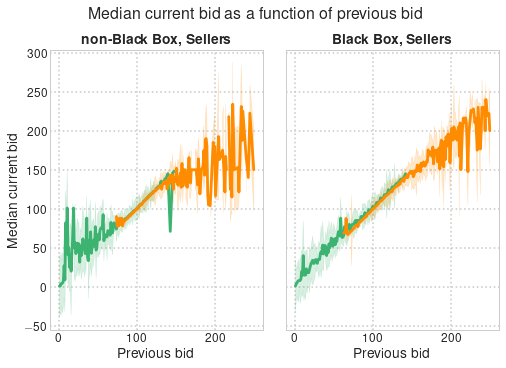

In [89]:
fig, ax = plt.subplots(1,2, figsize=(7,5), sharex=True, sharey=True, constrained_layout=True)
idx = 0

for (BB_flag, side), df_side in df_lags.groupby(['BB', 'side']):
    treatments = 'Black Box' if BB_flag else 'non-Black Box'
    
    _ = ax[idx//2].set_aspect('equal', adjustable='box')
    _ = sns.lineplot(x='bid-1', y='bid', data=df_side[(df_side[['bid', 'bid-1']] <= bid_q97)], 
                     estimator='median', ci='sd', ax=ax[idx//2], color=side_colours[side])
    _ = ax[idx//2].set_title(bold_text('{}, {}'.format(treatments, '{}s'.format(side))))

#     if side == 'Seller':
#         _ = ax[idx//2].set_xscale('log')
#         _ = ax[idx//2].set_yscale('log')
    
    _ = ax[idx//2].set_xlabel('Previous bid')
    _ = ax[idx//2].set_ylabel('Median current bid')
        
    idx += 1
    
_ = plt.suptitle('Median current bid as a function of previous bid')
_ = plt.savefig('Figures/Paper/Medians_bids.pdf', bbox_inches='tight')

**Quantile regression**

Median regression estimates the median of the dependent variable conditional on the values of the independent variable. 

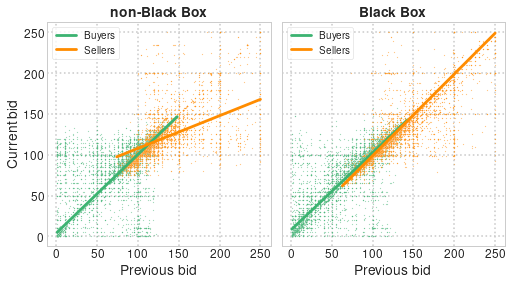

In [90]:
fig, axes = plt.subplots(1,2, figsize=(7,5), sharex=True, sharey=True, constrained_layout=True)

for (BB_flag, side), data in df_lags.rename({'bid-1': 'pbid'}, axis=1).groupby(['BB', 'side']):
    mod = smf.quantreg('bid ~ pbid', data=data)
    res = mod.fit(q=0.5, max_iter=2000)

    a = res.params['Intercept']
    b = res.params['pbid']
    
    ax = axes[int(BB_flag)]
    _ = ax.set_aspect('equal', adjustable='box')
    _ = ax.set_title(bold_text('{}'.format('Black Box' if BB_flag else 'non-Black Box')))
    _ = sns.scatterplot(x='pbid', y='bid', data=data[data[['bid', 'pbid']] <= 250], ax=ax,
                        s=1.5, alpha=0.5, color=side_colours[side])
    
    xvals = np.arange(min(data[data['pbid'] <= 250]['pbid'].dropna()), max(data[data['pbid'] <= 250]['pbid'].dropna())+1)
    _ = ax.plot(xvals, [a + b*x for x in xvals], label='{}s'.format(side), color=side_colours[side])

    _ = ax.set_xlabel('Previous bid')
    _ = ax.set_ylabel('Current bid')
    
    _ = ax.legend()

[Scatter plots](https://seaborn.pydata.org/generated/seaborn.scatterplot.html) with [kernel density estimates](https://seaborn.pydata.org/generated/seaborn.kdeplot.html)

In [91]:
def scatter_lagged(var, scale, truncate=False, sharexy=False):
    def logTicks(x, pos):
        if x == 0: return '$0$'

        exponent = int(np.log10(abs(x)))
        coeff = x/(10**exponent)

        return r'${:2.1f} \times 10^{{ {:2d} }}$'.format(coeff,exponent)
    
    fig, axes = plt.subplots(2,2, figsize=(15,15), sharex=sharexy, sharey=sharexy,
                             constrained_layout=True)
    
    lagged_var = '{}-1'.format(var)
    
    if truncate:
        data = df_lags[df_lags['truncate']].dropna(subset=[lagged_var, var])
    else:
        data = df_lags.dropna(subset=[lagged_var, var])
            
    for (BB_mask, side), df_side in data.groupby(['BB', 'side']):
        i = int(BB_mask)
        j = int(0 if side == 'Buyer' else 1)     
        ax = axes[i][j]
        
        if scale == 'linear':
            x = lagged_var
            y = var
            log_scale = False
            _ = ax.set_xscale(scale)
            _ = ax.set_yscale(scale)
        elif scale == 'symlog':
            x = df_side[lagged_var].apply(symlog)
            y = df_side[var].apply(symlog)
            log_scale = False            
            _ = ax.set_xscale(scale, linthresh=3)
            _ = ax.set_yscale(scale, linthresh=3)
            _ = ax.xaxis.set_major_formatter(tick.FuncFormatter(logTicks))
            _ = ax.yaxis.set_major_formatter(tick.FuncFormatter(logTicks))
        elif scale == 'log':
            x = lagged_var
            y = var
            log_scale = True
            _ = ax.set_xscale(scale)
            _ = ax.set_yscale(scale)
        
        try:
            _ = sns.kdeplot(x=x, y=y, ax=ax, data=df_side, linewidths=2, log_scale=log_scale, levels=10, cmap=ListedColormap(gray_palette))
        except:
            pass
        
        _ = sns.scatterplot(x=x, y=y, ax=ax, data=df_side, alpha=0.3, hue='side', palette=side_colours, legend=False)
        
        axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid',
                       'reldemand': 'Relative demand', 'reldemand-1': 'Previous relative demand'}
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        except:
            pass
        
        _ = ax.set_title(bold_text('{}, {}s'.format('Black Box' if BB_mask else 'non-Black Box', side)))
        
    _ = plt.suptitle(r'\textbf{{{}s}}, {} scale (truncated data: {}, shared axes: {})'.format(axis_labels[var], scale, truncate, sharexy), y=1.02)

Comparison of different layouts

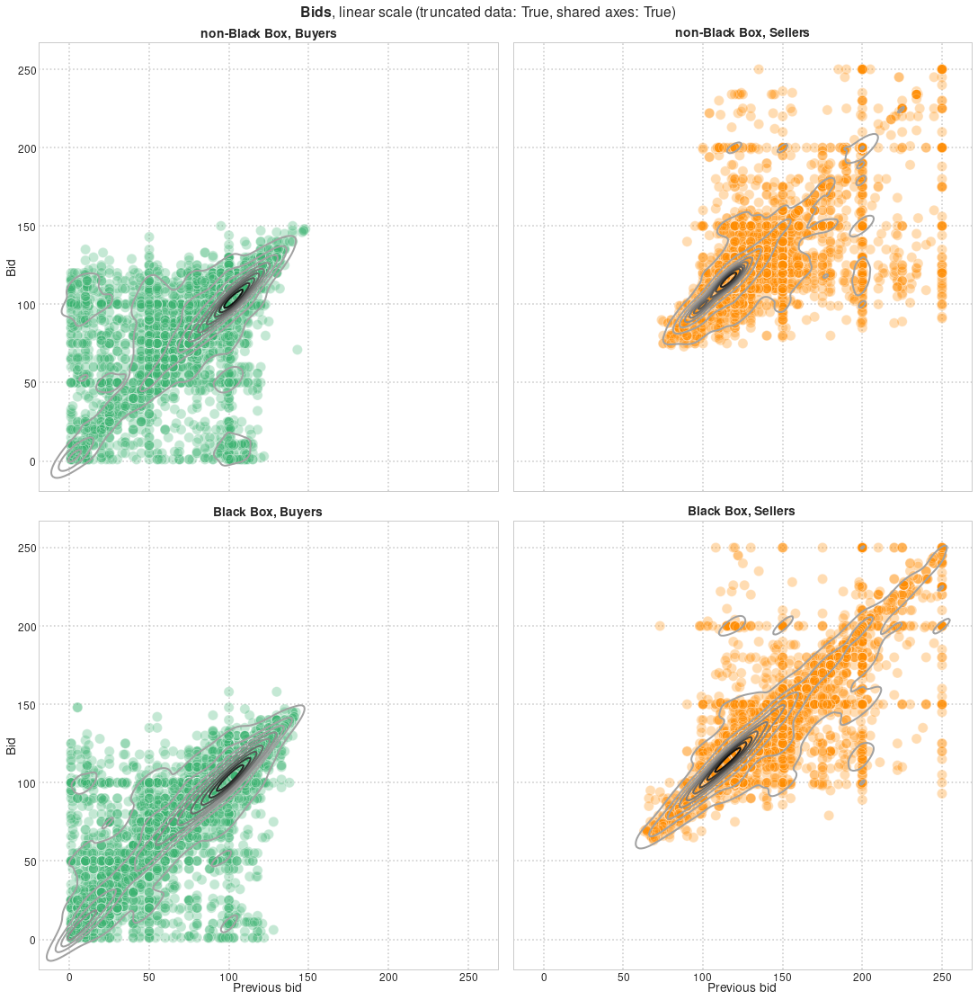

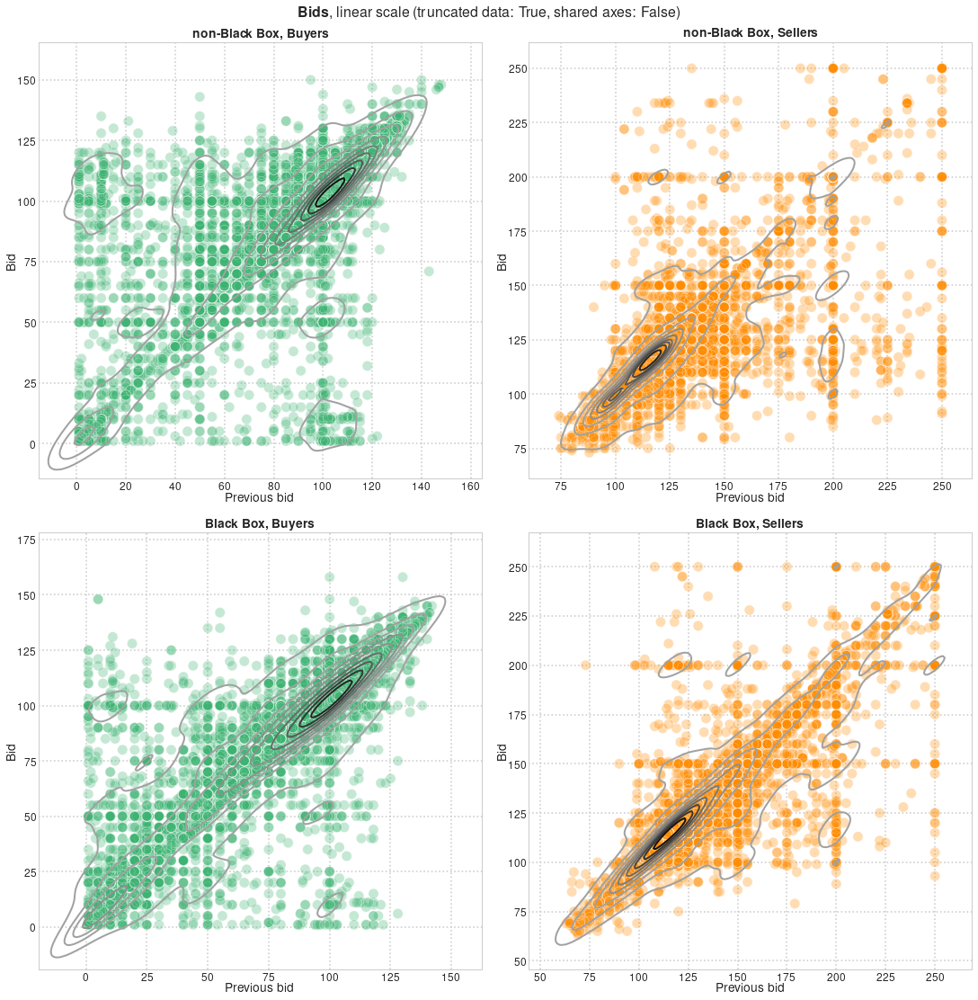

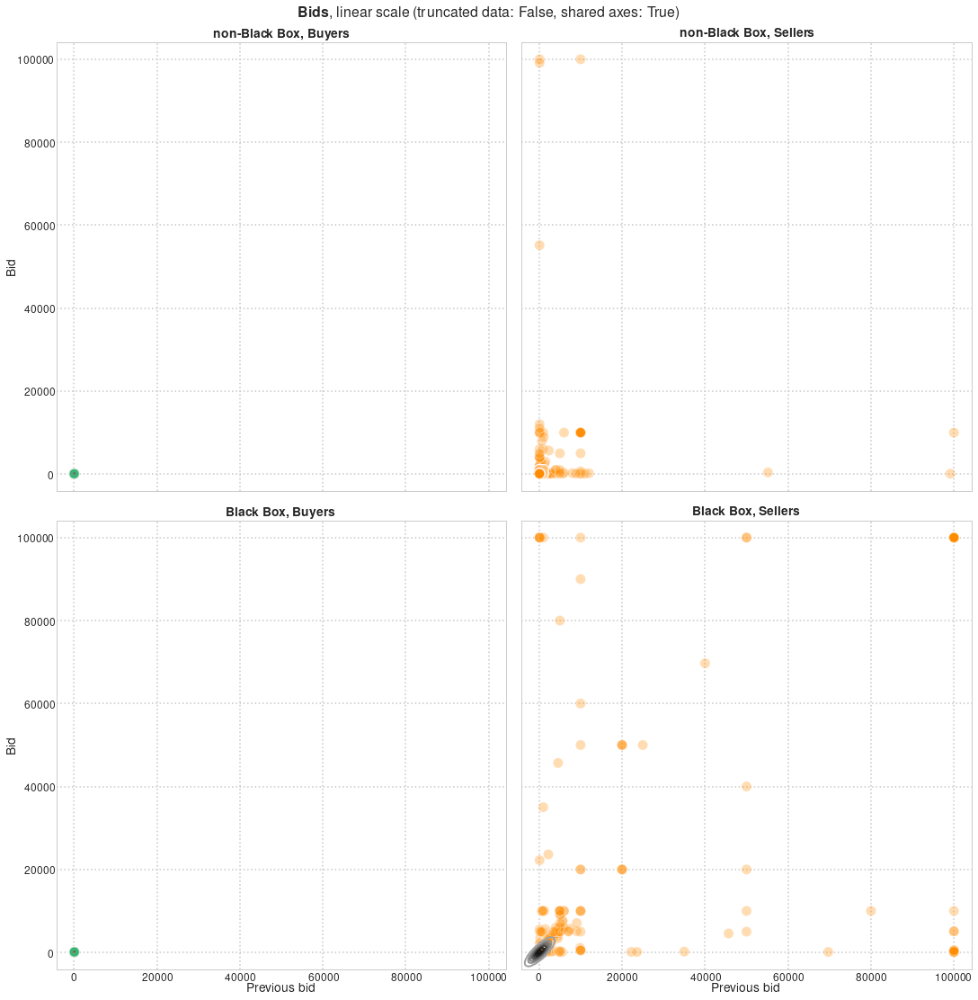

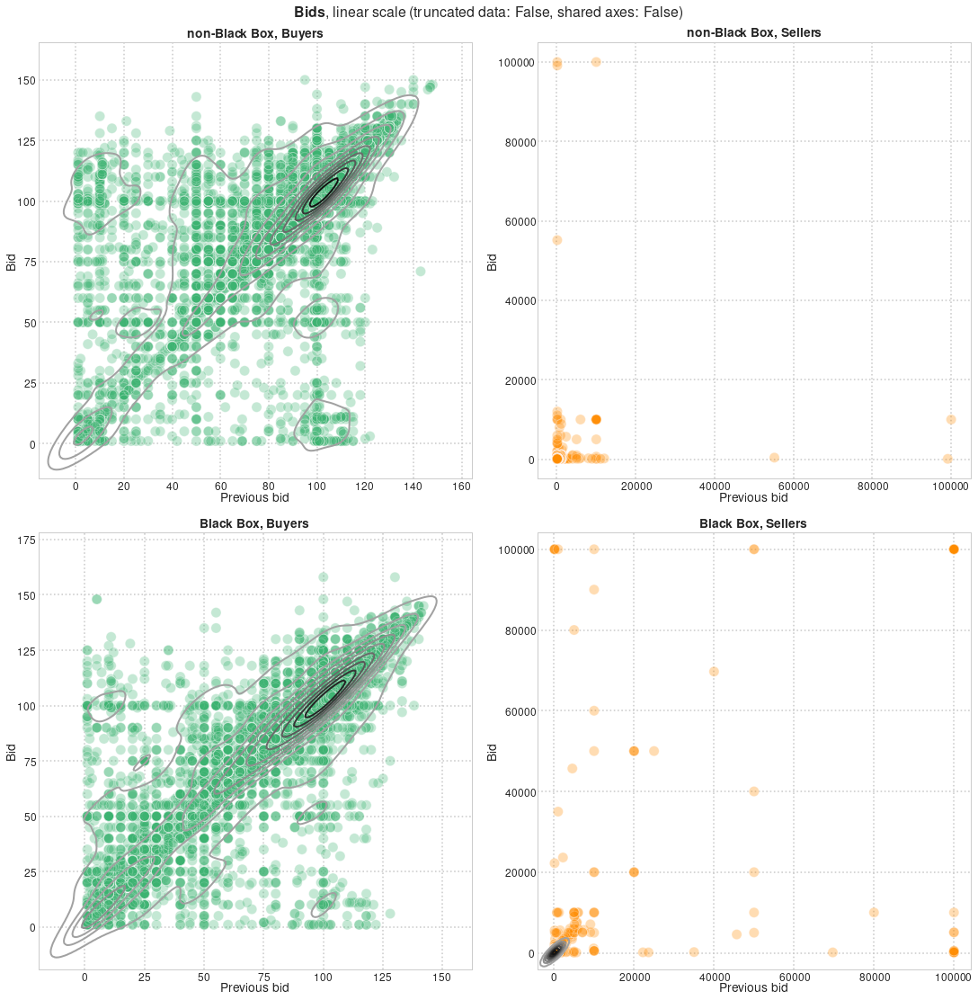

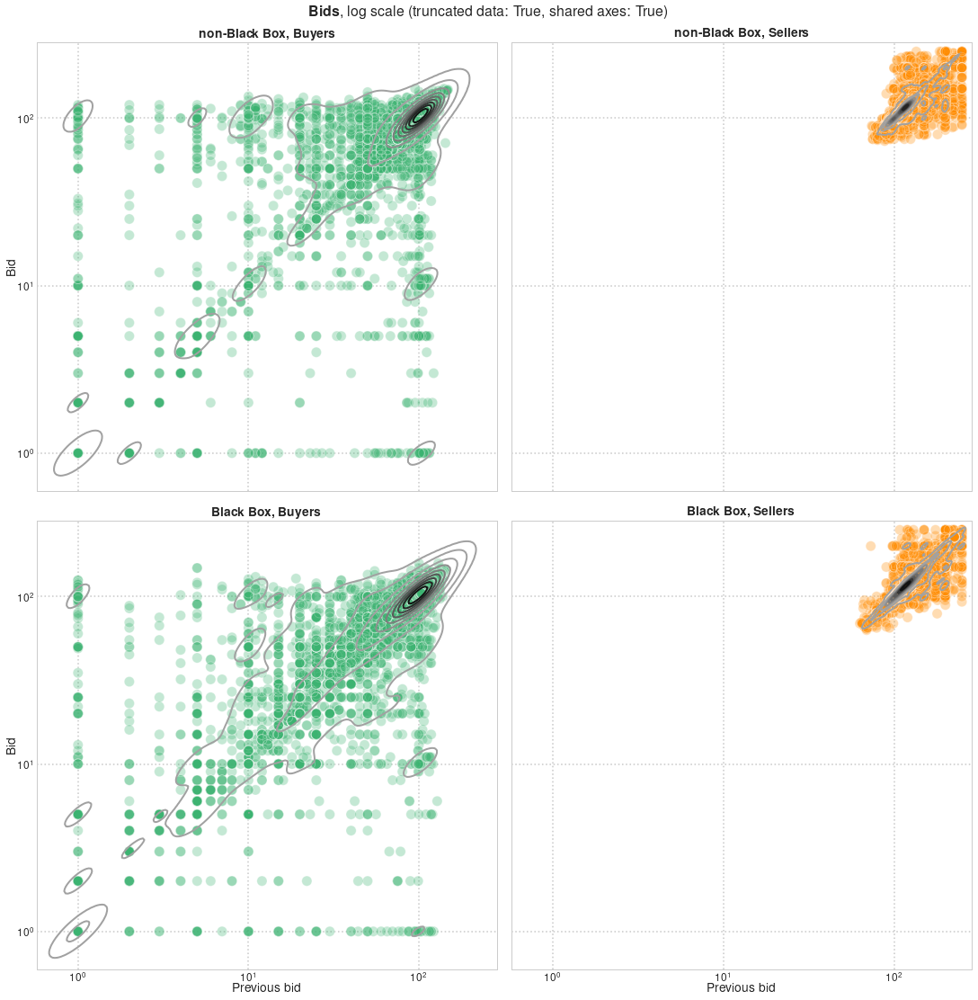

...

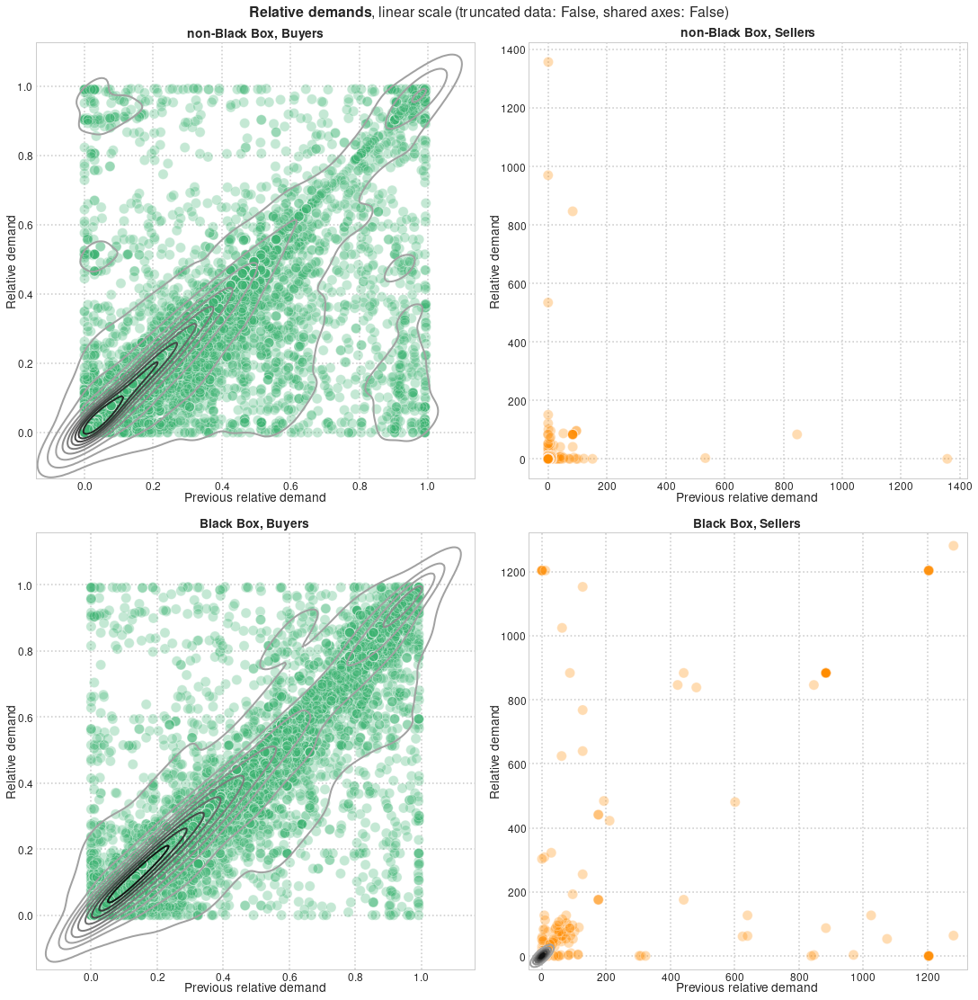

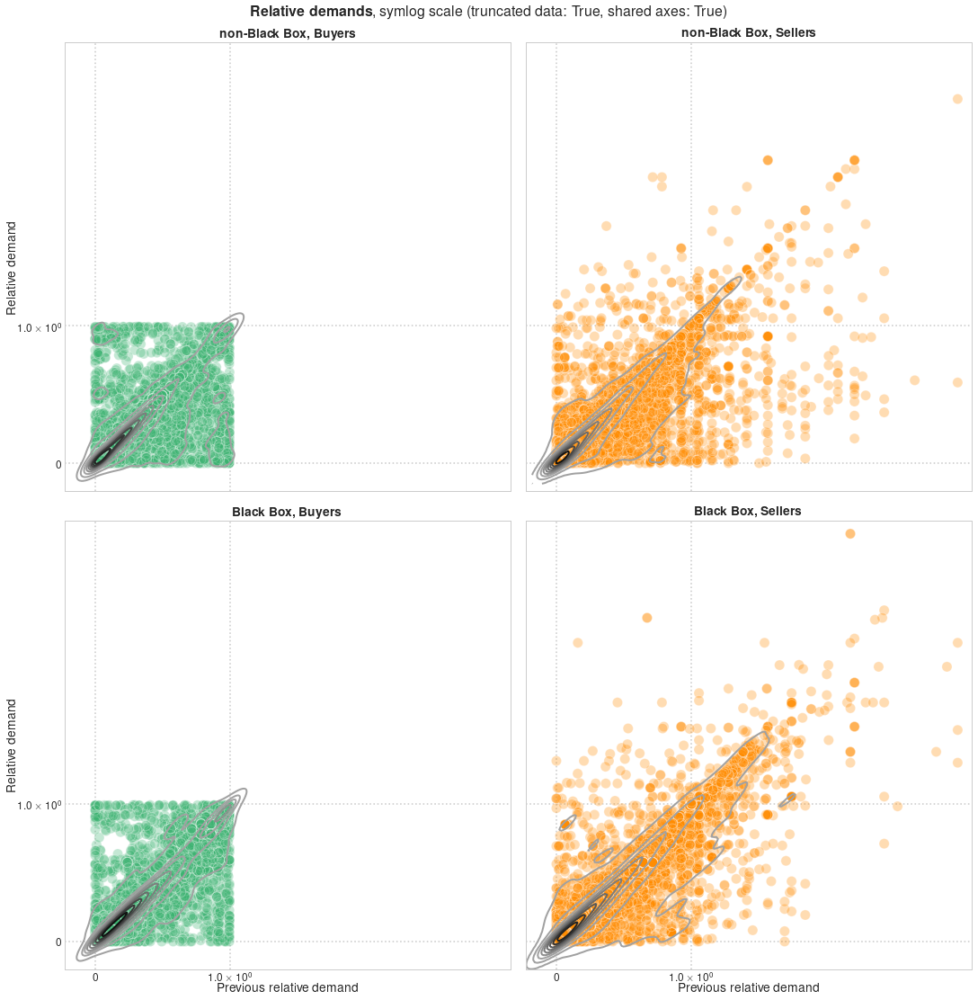

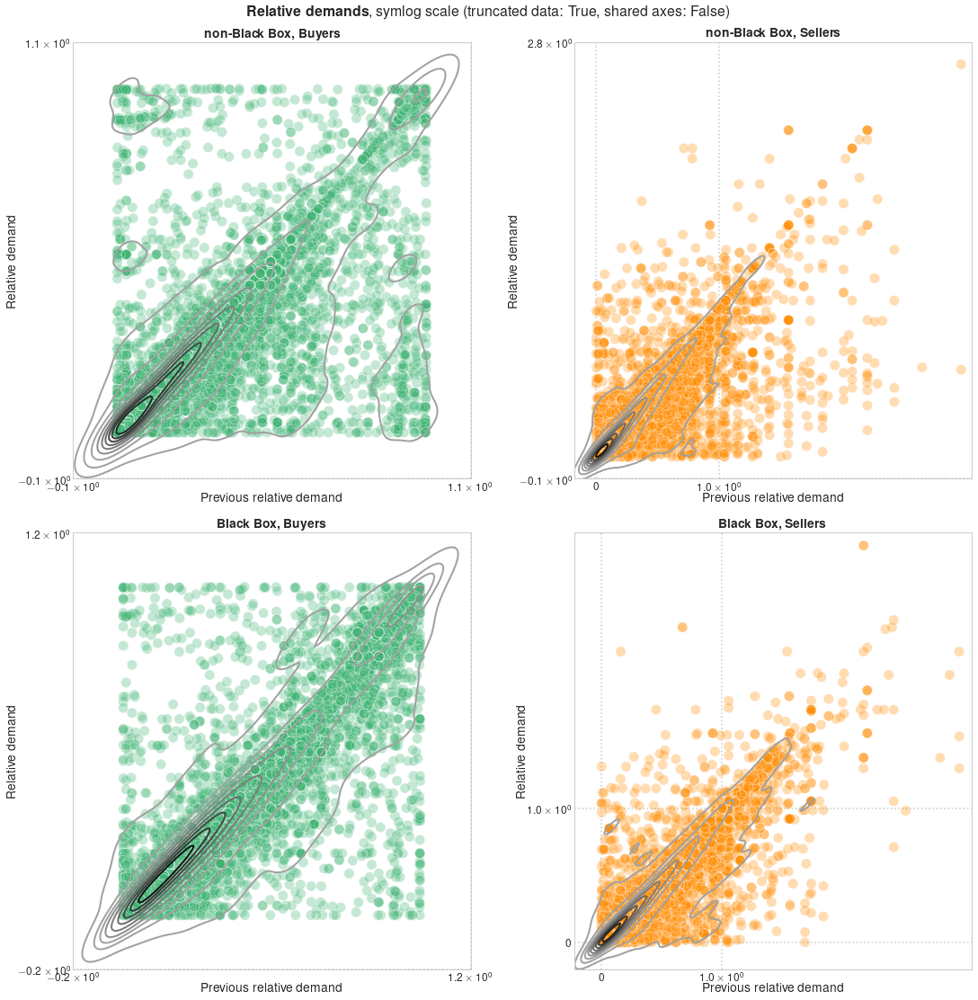

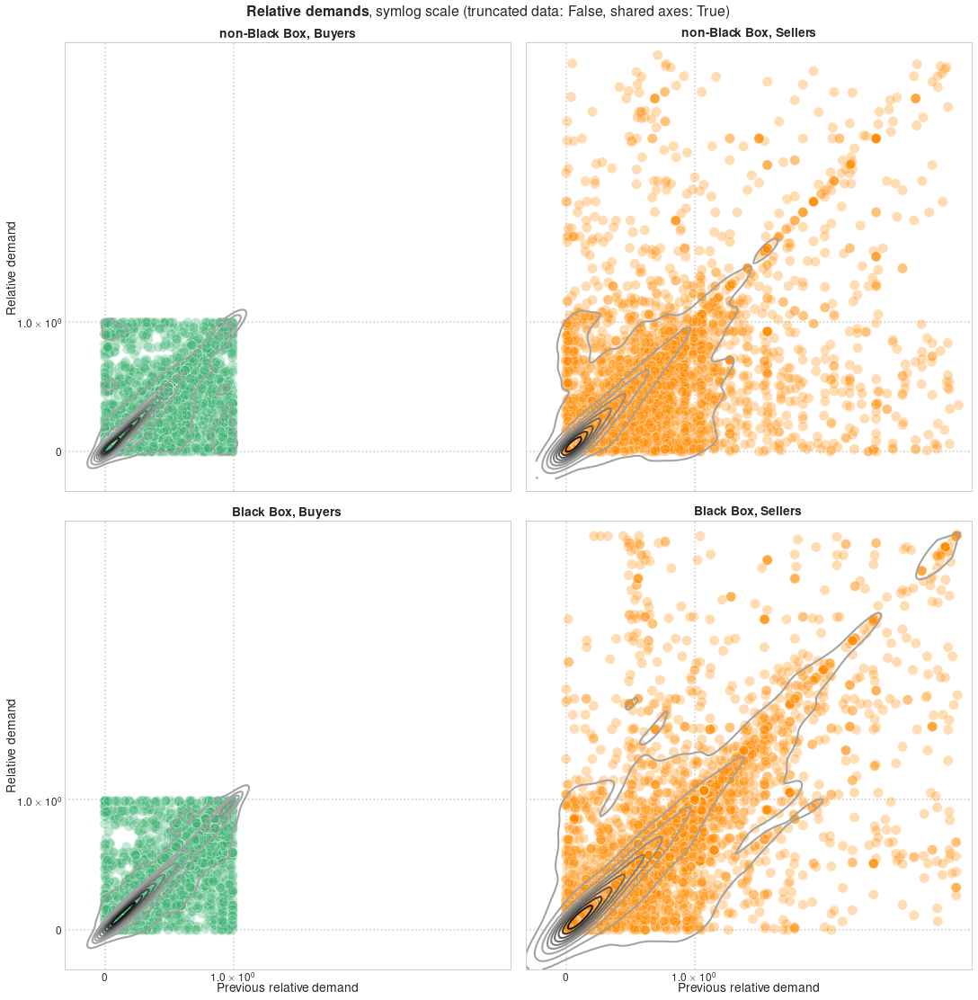

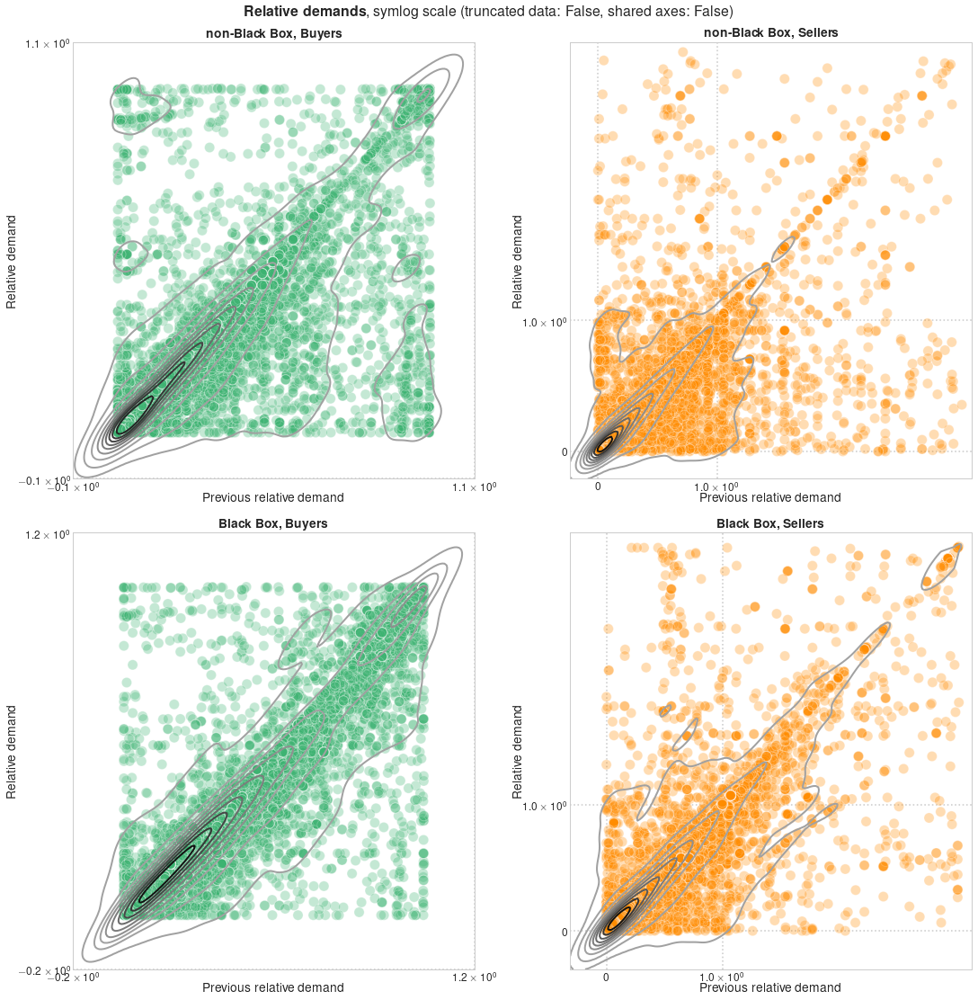

In [92]:
for var in ['bid', 'reldemand']:
    for scale in ['linear', 'log', 'symlog']:
        for truncate in [True, False]:
            for sharexy in [True, False]:
                # skip logarithmic scale for relative demands (since they mostly take values in [0,1])
                if (var == 'reldemand') & (scale == 'log'):
                    continue               
                scatter_lagged(var, scale, truncate, sharexy)
                #_ = plt.savefig('Figures/{}_{}_truncate_{}_sharexy_{}.pdf'.format(var.capitalize(), scale, truncate, sharexy), bbox_inches='tight')

Current bid as a response to previous bid (shared logarithmic scale, all data) – scatter plots, kernel density estimates, and robust regression as implemented by [```regplot```](https://seaborn.pydata.org/generated/seaborn.regplot.html) (confidence intervals are obtained using bootstrapping). Note that a manual implementation can be found further down below.

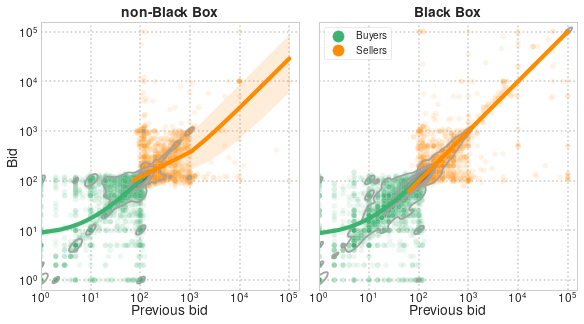

In [93]:
fig, axes = plt.subplots(1,2, figsize=(8,6), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')

    x = 'bid-1'
    y = 'bid'
    
    for side, df_side in data.groupby(['side']):  
        _ = sns.kdeplot(x=x, y=y, ax=ax, data=df_side, linewidths=1.8, log_scale=True, 
                        levels=8, cmap=ListedColormap(gray_palette))
        _ = sns.regplot(x=x, y=y, ax=ax, data=df_side, robust=True, scatter=False,
                        color=side_colours[side])
    
    splot = sns.scatterplot(x=x, y=y, ax=ax, data=data, alpha=0.1, s=30,
                            hue='side', hue_order=['Buyer', 'Seller'], palette=side_colours)
    _ = splot.set(xscale='log', yscale='log')

    axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
    except:
        pass

    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'non-Black Box'))

_ = axes[0].legend_.remove()    
_ = axes[1].legend(title=None)

for label in axes[1].legend_.get_texts():
    label.set_text('{}s'.format(label.get_text()))

Current bid as a response to previous bid (shared logarithmic scale, all data) – kernel density estimates

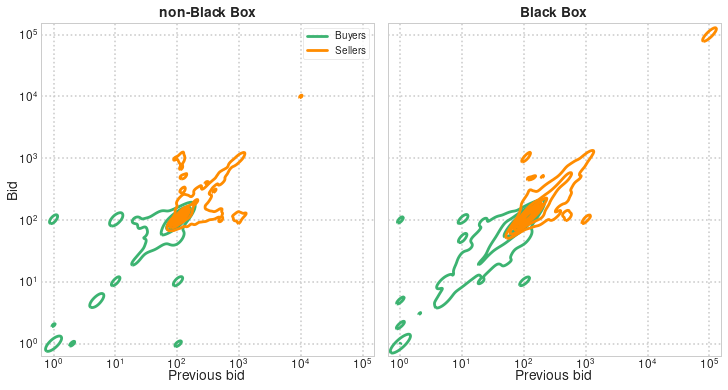

In [94]:
fig, axes = plt.subplots(1,2, figsize=(10,6), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_xscale('log')
    _ = ax.set_yscale('log')
    _ = ax.set_aspect('equal', adjustable='box')

    _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=data, log_scale=True, levels=10,
                    hue='side', palette=side_colours, hue_order=['Buyer', 'Seller'])
    
    axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
    except:
        pass

    legend = ax.get_legend()
    legend.set_title(None)

    for label in legend.get_texts():
        label.set_text('{}s'.format(label.get_text()))
        
    if i == 1:
        legend.set_visible(False)
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'non-Black Box'))

_ = plt.savefig('Figures/Bids_BB_nonBB_kde.pdf', bbox_inches='tight')

#### Robust linear regression

A [robust linear model](https://www.statsmodels.org/stable/generated/statsmodels.robust.robust_linear_model.RLM.html) is used to downweight outliers (sellers' bids at the extreme of the action space, i.e., $\sbid{j}{k} \gg 250$). It is estimated via iteratively reweighted least squares given a robust criterion estimator ([Huber M-estimator](https://www.statsmodels.org/stable/generated/statsmodels.robust.norms.HuberT.html?highlight=hubert)).

Notes:
- In order to estimate $R^2$, [weighted least squares regression](https://www.statsmodels.org/stable/generated/statsmodels.regression.linear_model.WLS.html) is run with weights from the fitted RLM to get a sense of the proportion of _weighted_ variation explained by the model (see [discussion](https://stackoverflow.com/questions/31655196/how-to-get-r-squared-for-robust-regression-rlm-in-statsmodels)).
- Confidence and prediction intervals are extracted by means of [``summary_table``](https://www.statsmodels.org/stable/generated/statsmodels.stats.outliers_influence.OLSInfluence.summary_table.html) and [``wls_prediction_std``](https://tedboy.github.io/statsmodels_doc/generated/statsmodels.sandbox.regression.predstd.wls_prediction_std.html) implemented in ``statsmodels``; probability plots are generated using ``scipy``'s [``probplot``](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.probplot.html) (whereby a _prediction interval_ predicts the range an individual observation is expected to be sampled from and a _confidence interval_ corresponds to the likely range of values to contain the true mean of the population).

In [95]:
def bid_regression(data, scale, out=False):
    data = data.copy().dropna(subset=['bid-1'])
    x = data['bid-1'].values
    y = data['bid'].values
    X = sm.add_constant(x)
    model_RLM = sm.RLM(y, X)
    results_RLM = model_RLM.fit()
    yhat = results_RLM.fittedvalues
    resid = y - yhat

    model_WLS = sm.WLS(model_RLM.endog, model_RLM.exog, weights=model_RLM.weights)
    results_WLS = model_WLS.fit(cov_type='cluster', cov_kwds={'groups': data['id']})
    
    if out: # print out statistics
        printmd('**Robust linear model**')
        print(results_RLM.summary())

        printmd('**Weighted least squares**')
        print(results_WLS.summary())
    
    if scale == 'linear':
        xrange = np.linspace(x.min(), x.max())
    elif scale == 'log':
        xrange = np.geomspace(x.min(), x.max())
    Xrange = sm.add_constant(xrange)
    
    prstd, interval_l, interval_u = wls_prediction_std(results_WLS, exog=Xrange, alpha=0.05)
    _, summaryTable, _ = summary_table(results_WLS, alpha=0.05)
    mean_ci_low, mean_ci_upp = summaryTable[:,4:6].T
    predict_ci_low, predict_ci_upp = summaryTable[:,6:8].T

    # Organise results
    # Information about fitted values, residuals, and confidence intervals
    confInt = pd.DataFrame({'x': x, 'fitted': yhat, 'resid': resid, 'ci_low': mean_ci_low, 'ci_upp': mean_ci_upp})
    confInt = confInt.sort_values('x')
    # Information about prediction intervals
    predInt = pd.DataFrame({'x': xrange, 'predict_ci_low': interval_l, 'predict_ci_upp': interval_u})
    predInt = predInt.sort_values('x')
    
    return confInt, predInt

def regression_plot(ax, colour, confInt, predInt):
    # Fitted values
    _ = ax.plot(confInt['x'], confInt['fitted'], c=colour, label='Robust linear model', linewidth=2)

    # Confidence intervals
    _ = ax.fill_between(confInt['x'], confInt['ci_low'], confInt['ci_upp'], 
                        color=colour, alpha=0.4, label=r'95\% confidence interval')

    # Prediction intervals 
    # Note: negative lower bounds are clipped to 1 to prevent distortions in the logrithmic scale
    _ = ax.fill_between(predInt['x'], predInt['predict_ci_low'].clip(lower=1), predInt['predict_ci_upp'], 
                        color=colour, alpha=0.1, label=r'95\% prediction interval')
    
def residual_plot(x, resid):
    """Residual plot and probability plot of residuals for a normal distribution."""
    fig, ax = plt.subplots(1, 3, figsize=(16, 4))
    
    for idx in range(2):
        _ = sns.scatterplot(x=x, y=resid, s=10, alpha=0.3, color='red', ax=ax[idx])
        _ = ax[idx].plot([0, max(x)], [0, 0], linestyle='dashed', color='black', linewidth=2)
        _ = ax[idx].set_xlabel('Independent variable')
        _ = ax[idx].set_ylabel('Residuals', labelpad=-0.5)
        
        if idx == 0:
            _ = ax[idx].set_title('Linear scale')
        else:
            _ = ax[idx].set_xscale('log')
            _ = ax[idx].set_title('Logarithmic scale')
            
        _ = ax[idx].ticklabel_format(axis='y', style='sci', scilimits=(0,3))
 
    # Probability plot
    _ = stats.probplot(resid, dist='norm', plot=ax[2])
    _ = ax[2].set_xlabel('Quantiles')
    _ = ax[2].set_ylabel('Ordered values', labelpad=-0.5)
    _ = ax[2].ticklabel_format(axis="y", style='sci', scilimits=(0,3))
    _ = ax[2].set_title(r'Probability plot (against normal)')
    _ = ax[2].get_lines()[0].set_markersize(3)
    _ = ax[2].get_lines()[0].set_color('royalblue')    
    _ = ax[2].get_lines()[1].set_linewidth(2)

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


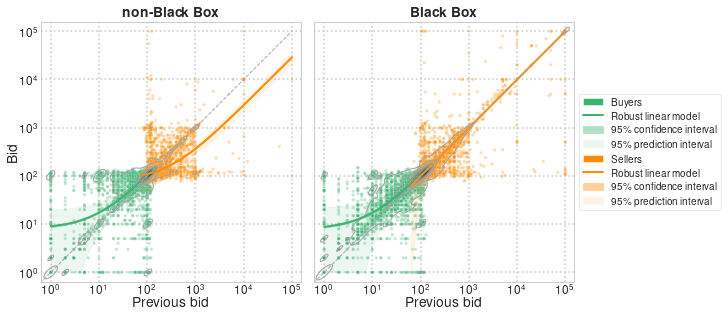

In [96]:
fig, axes = plt.subplots(1,2, figsize=(10,8), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')    

    for side, df_side in data.groupby(['side']):
        # Scatter plot, kernel density estimate, and robust linear model
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, zorder=1)
        _ = splot.set(xscale='log', yscale='log')

        _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=df_side, linewidths=1, log_scale=True,
                        levels=8, cmap=ListedColormap(gray_palette), zorder=2)
    
        confInt, predInt = bid_regression(data=df_side, scale='log', out=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)

    # 45-degree line
    _ = ax.plot(range(max(data['bid'])+1), range(max(data['bid'])+1), linestyle='dashed',
                color='darkgray', linewidth=1, zorder=2)
        
    # Axis layout
    axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}
    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
    except:
        pass
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'non-Black Box'))

# Legend
handles, labels = axes[1].get_legend_handles_labels()
for idx in range(len(handles)):
    if labels[idx] in ['Buyer', 'Seller']:
        handles[idx] = Patch(facecolor=side_colours[labels[idx]])
        labels[idx] = '{}s'.format(labels[idx])

order = [2,0,3,4,5,1,6,7]
handles = [handles[idx] for idx in order]
labels = [labels[idx] for idx in order]
_ = axes[0].legend_.remove()    
_ = axes[1].legend(handles, labels, title=None, loc='center left', bbox_to_anchor=(1, 0.5))

**non-Black Box, Buyers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                16416
Model:                            RLM   Df Residuals:                    16414
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Tue, 08 Dec 2020                                         
Time:                        14:59:37                                         
No. Iterations:                    50                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0713      0.111     72.574      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.915
Model:                            WLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                     8521.
Date:                Tue, 08 Dec 2020   Prob (F-statistic):          1.40e-280
Time:                        14:59:37   Log-Likelihood:                -54616.
No. Observations:               16416   AIC:                         1.092e+05
Df Residuals:                   16414   BIC:                         1.093e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0713      1.032      7.820      0.0

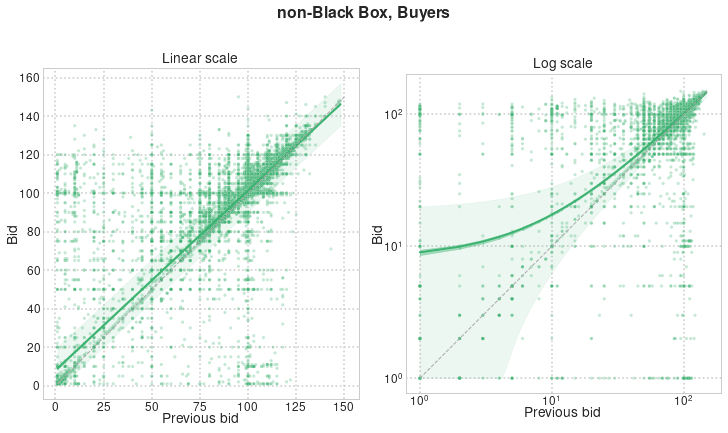

**non-Black Box, Sellers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                18133
Model:                            RLM   Df Residuals:                    18131
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Tue, 08 Dec 2020                                         
Time:                        14:59:46                                         
No. Iterations:                    50                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         80.2830      0.087    924.342      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.204
Model:                            WLS   Adj. R-squared:                  0.204
Method:                 Least Squares   F-statistic:                     50.25
Date:                Tue, 08 Dec 2020   Prob (F-statistic):           5.53e-12
Time:                        14:59:46   Log-Likelihood:                -89198.
No. Observations:               18133   AIC:                         1.784e+05
Df Residuals:                   18131   BIC:                         1.784e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         80.2830      4.850     16.553      0.0

c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


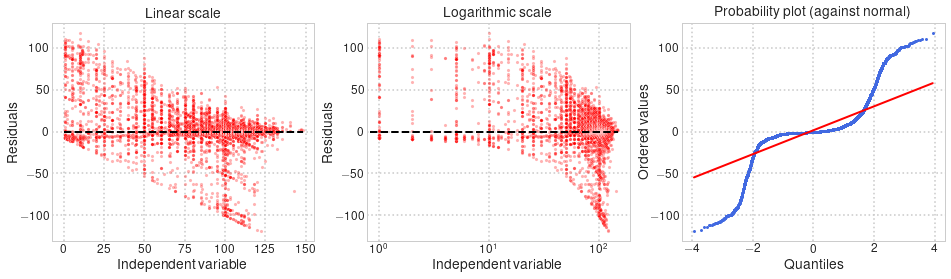

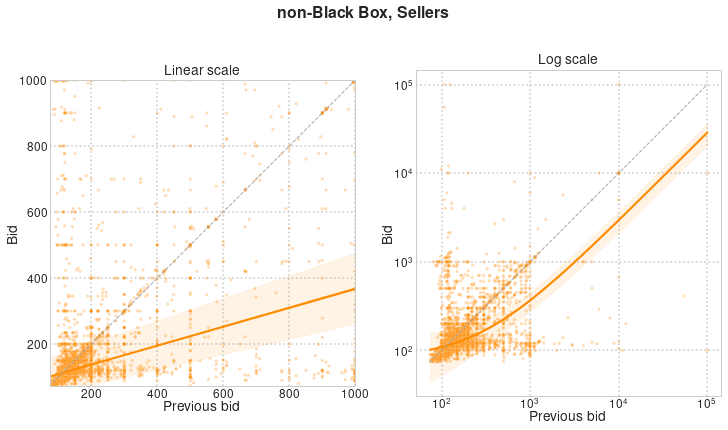

**Black Box, Buyers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                13107
Model:                            RLM   Df Residuals:                    13105
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Tue, 08 Dec 2020                                         
Time:                        14:59:56                                         
No. Iterations:                    27                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.8283      0.142     55.139      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.941
Model:                            WLS   Adj. R-squared:                  0.941
Method:                 Least Squares   F-statistic:                 2.550e+04
Date:                Tue, 08 Dec 2020   Prob (F-statistic):          9.57e-300
Time:                        14:59:56   Log-Likelihood:                -45758.
No. Observations:               13107   AIC:                         9.152e+04
Df Residuals:                   13105   BIC:                         9.153e+04
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.8283      0.574     13.639      0.0

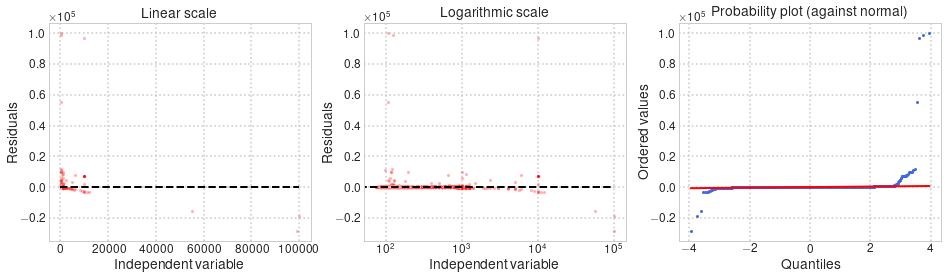

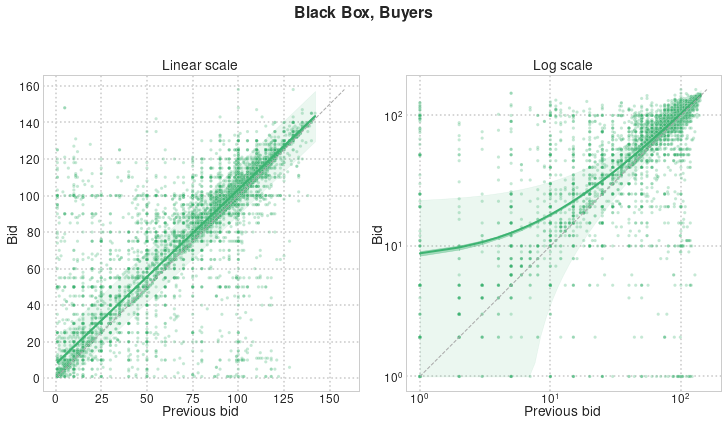

**Black Box, Sellers**

**Robust linear model**

                    Robust linear Model Regression Results                    
Dep. Variable:                      y   No. Observations:                13068
Model:                            RLM   Df Residuals:                    13066
Method:                          IRLS   Df Model:                            1
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Tue, 08 Dec 2020                                         
Time:                        15:00:05                                         
No. Iterations:                    39                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.1994      0.040    -54.998      0.0

**Weighted least squares**

                            WLS Regression Results                            
Dep. Variable:                      y   R-squared:                       1.000
Model:                            WLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.106e+09
Date:                Tue, 08 Dec 2020   Prob (F-statistic):               0.00
Time:                        15:00:05   Log-Likelihood:                -68679.
No. Observations:               13068   AIC:                         1.374e+05
Df Residuals:                   13066   BIC:                         1.374e+05
Df Model:                           1                                         
Covariance Type:              cluster                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.1994      0.143    -15.430      0.0

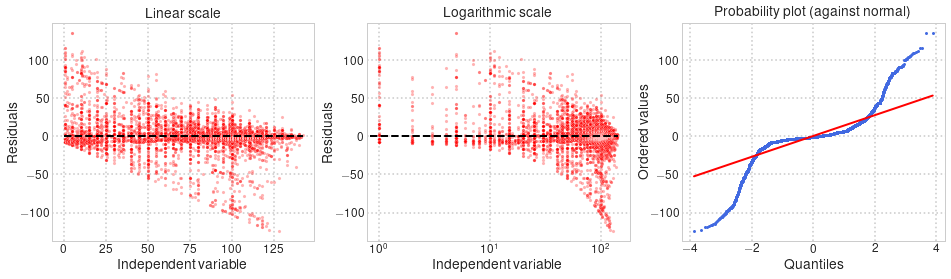

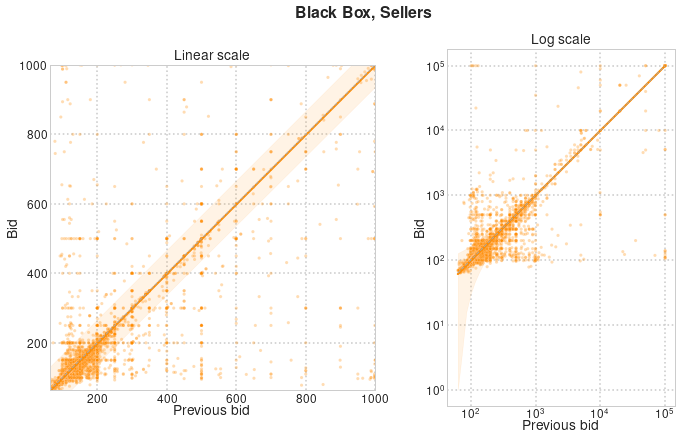

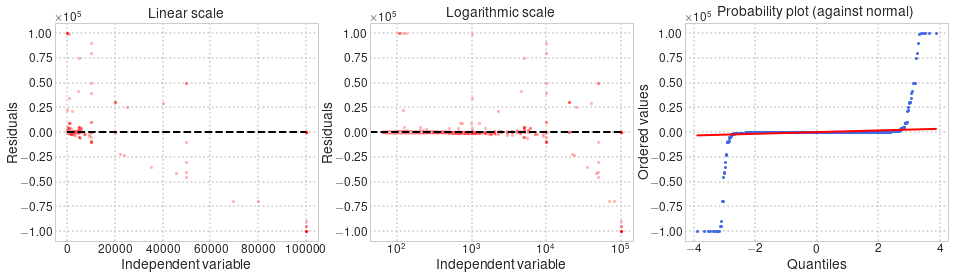

In [97]:
for (BB_mask, side), df_side in df_lags.dropna(subset=['bid-1']).groupby(['BB', 'side']):
    fig, axes = plt.subplots(1, 2, figsize=(10, 6), constrained_layout=True)
    
    suptitle = '{}, {}s'.format('Black Box' if BB_mask else 'non-Black Box', side)
    printmd('**{}**'.format(suptitle))

    bid_range = range(min(df_side['bid']), max(df_side['bid'])+1)
    
    for idx, scale in enumerate(['linear', 'log']):
        ax = axes[idx]            

        confInt, predInt = bid_regression(data=df_side, scale=scale, out=(idx == 0))
        
        # Scatter plot, robust linear model, 45-degree line
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, legend=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)
        _ = ax.plot(bid_range, bid_range, linestyle='dashed', color='darkgray', linewidth=1, zorder=2)
        
        # Axis layout
        _ = ax.set_title('{} scale'.format(scale.capitalize()))

        axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}    
        
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
            
        except:
            pass

        _ = ax.set_aspect('equal', adjustable='box')
        _ = splot.set(xscale=scale, yscale=scale)
        
        if (scale != 'log') and max(df_side['bid']) > bid_q97:
            _ = ax.set_xlim(min(df_side['bid-1']), 1000)
            _ = ax.set_ylim(min(df_side['bid-1']), 1000)

    _ = plt.suptitle(bold_text(suptitle))
    _ = plt.show()
    
    # Residual plot
    residual_plot(confInt['x'], confInt['resid'])

#### Non-linear \& non-parametric regression

Implemented below:
- **LOWESS** (```statsmodels``` locally weighted scatter plot smoother). The algorithm generates a non-parametric smoother using local linear estimates. For every $1 \leq i \leq N$, the smooth $y_i$ is estimated by taking the $r$ closest points to $(x_i,y_i)$ based on their $x_i$ values and applying a weighted linear regression, where $r = fN$ for $f \in (0, 1]$ ($f = 0.2$ in the implementation below). More details: [documentation](https://www.statsmodels.org/stable/generated/statsmodels.nonparametric.smoothers_lowess.lowess.html), [algorithm](https://www.tandfonline.com/doi/abs/10.1080/01621459.1979.10481038).
- **Rational model (n, m)**: $q(x; (a_i)_{i = 0}^n, (b_i)_{i = 0}^m) = \frac{a_0 + a_1 x + \cdots + a_n x^n}{1 + b_1 x + \cdots + b_m x^m}$ fitted with robust non-linear regression in ```SciPy``` (using Huber loss and scale $C = 1$). More details: [documentation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html), [tutorial](https://scipy-cookbook.readthedocs.io/items/robust_regression.html).

Also tried out (unsuitable due to high sensitivity to outliers):
- ```PyQt-Fit``` kernel methods using a Gaussian kernel (Nadaraya-Watson regression (spatial averaging), local-polynomial regressions: [documentation](https://pythonhosted.org/PyQt-Fit/mod_npr_methods.html), [tutorial](https://pyqt-fit.readthedocs.io/en/latest/NonParam_tut.html).
- ```scikit-learn``` epsilon-support vector regressions using non-linear/linear kernels: [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVR.html), [tutorial](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVR.html#sklearn.svm.SVR).

In [98]:
def poly_eval(coeff, x):
    return sum([coeff[i]*x**i for i in range(len(coeff))])

def poly_residuals(coeff, x, y):
    return y - poly_eval(coeff, x)

def rational_eval(coeff, n, m, x):
    a_coeff = coeff[0:n+1]
    b_coeff = coeff[n+1:n+1+m]
    b_coeff = np.insert(b_coeff, 0, 1)

    return poly_eval(a_coeff, x)/poly_eval(b_coeff, x)

def rational_residuals(coeff, n, m, x, y):        
    return y - rational_eval(coeff, n, m, x)

def nonparam_regression(data):
    x = data['bid-1']
    y = data['bid']
    fitted_vals = pd.DataFrame({'x': x, 'y': y})
    models = dict()
    colours = dict()
    
    # LOWESS
    fitted_vals['LOWESS'] = sm.nonparametric.lowess(y, x, return_sorted=False, frac=0.2)
    colours['LOWESS'] = 'blue'
    
    # Rational model
    # Given as a tuple (x0, n, m), where x0 provides the initial estimates of the coefficients,
    # n equals the degree in the numerator, and m equals the degree in the denominator.
    rationalModels = [([1,1,0,0], 1, 2), ([1,1,1,1,1], 2, 2)]
    colours['Rational model (1, 2)'] = 'purple'
    colours['Rational model (2, 2)'] = 'violet'   
    
    for (x0, n, m) in rationalModels:
        model_name = 'Rational model ({}, {})'.format(n, m)
        
        rm = least_squares(rational_residuals, x0=x0, loss='huber',
                           f_scale=1, args=(n, m, x, y), jac='cs')
        coeff = rm.x
        model = lambda x, coeff=coeff, n=n, m=m: rational_eval(coeff, n, m, x)
        fitted_vals[model_name] = model(x)
        models[model_name] = model

    # Quadratic polynomial
    # Alternative implementation: least_squares applied to poly_residuals
    X = np.column_stack((x, x**2))
    X = sm.add_constant(X)
    
    model_RLM = sm.RLM(y, X)
    results_RLM = model_RLM.fit()
    fitted_vals['Quadratic polynomial'] = results_RLM.fittedvalues
    models['Quadratic polynomial'] = results_RLM
    colours['Quadratic polynomial'] = 'red'
      
    fitted_vals.sort_values(by='x', inplace=True)

    return fitted_vals, models, colours

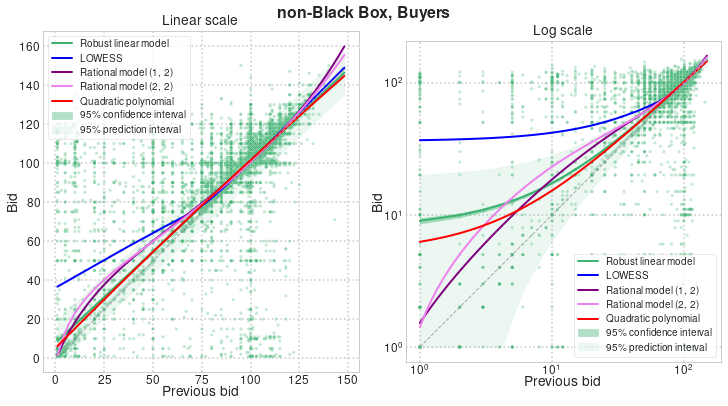

,R2 = 1 - SS_resid/SS_total
RLM,0.502304
LOWESS,0.561522
"Rational model (1, 2)",0.513632
"Rational model (2, 2)",0.525337
Quadratic polynomial,0.492242


c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:1104: RuntimeWarning: invalid value encountered in sqrt
  resid_se = np.sqrt(res.mse_resid * (1 - infl.hat_matrix_diag))
c:\users\bikica\miniconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:693: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


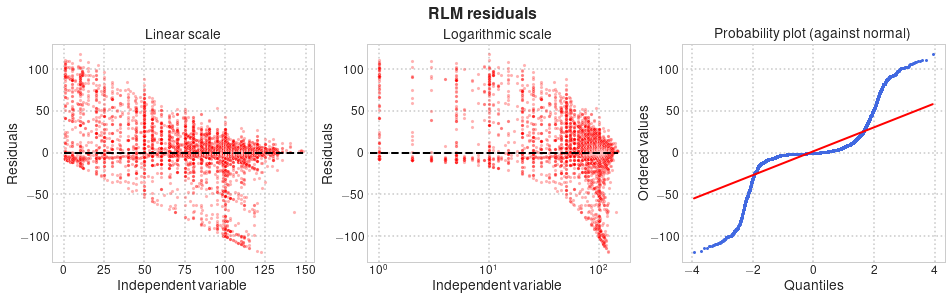

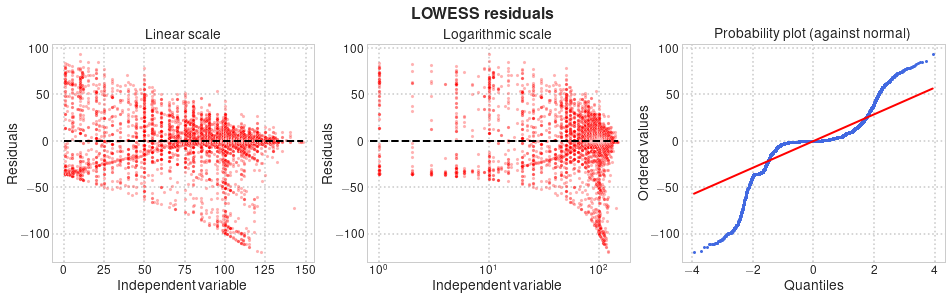

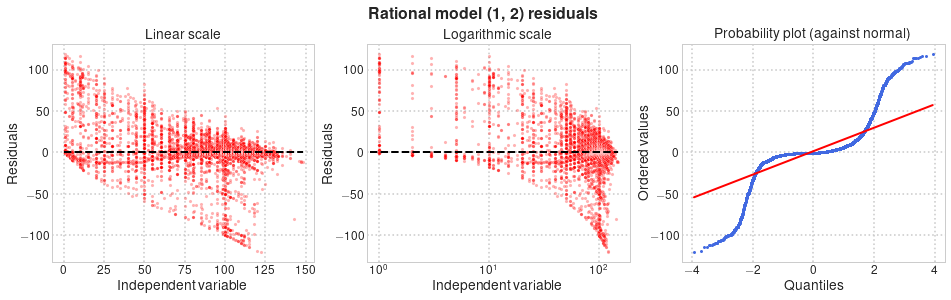

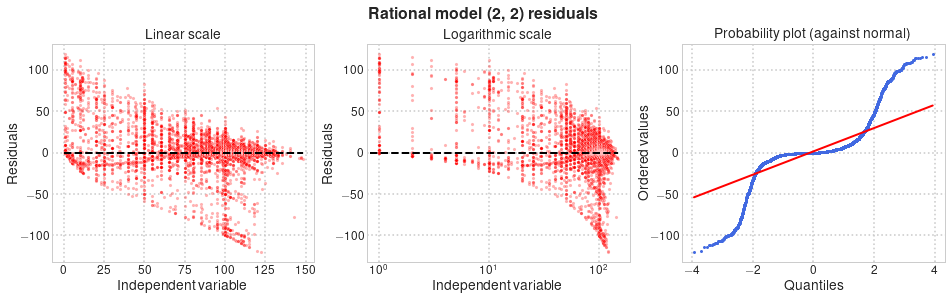

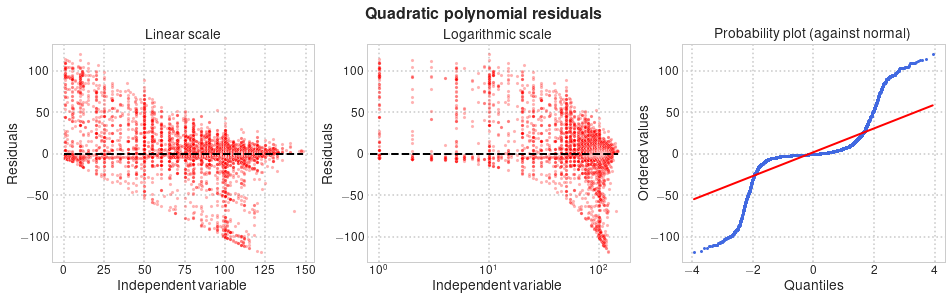

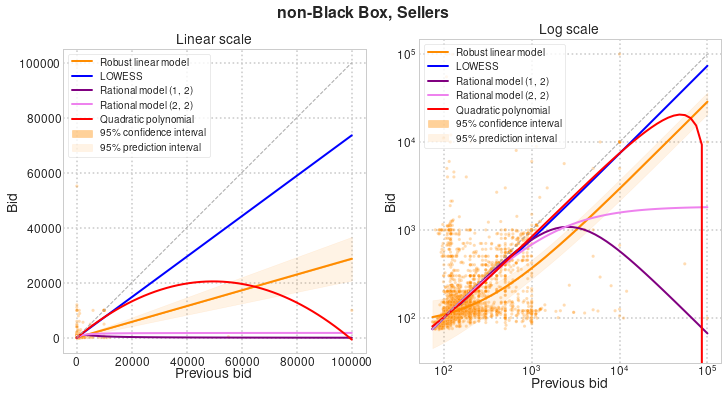

,R2 = 1 - SS_resid/SS_total
RLM,-0.007724
LOWESS,-0.253367
"Rational model (1, 2)",0.008249
"Rational model (2, 2)",0.019374
Quadratic polynomial,0.044327


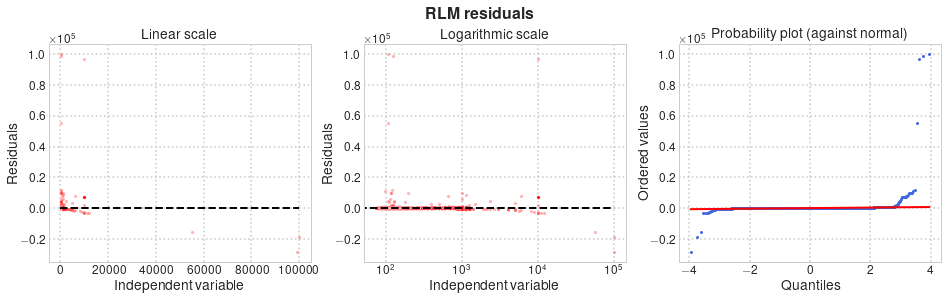

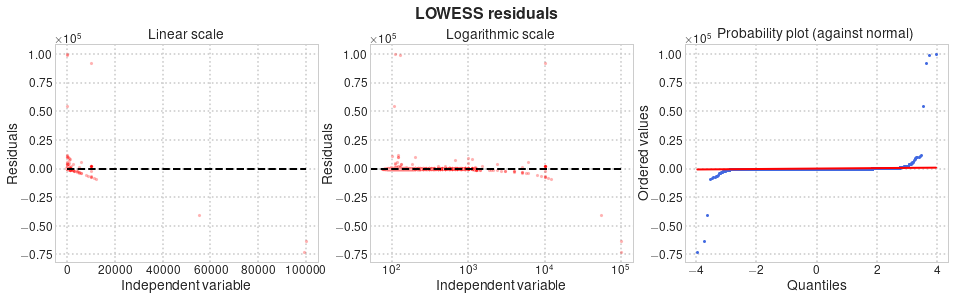

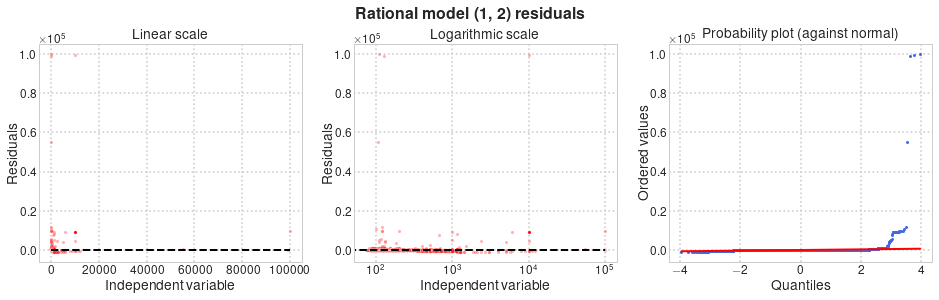

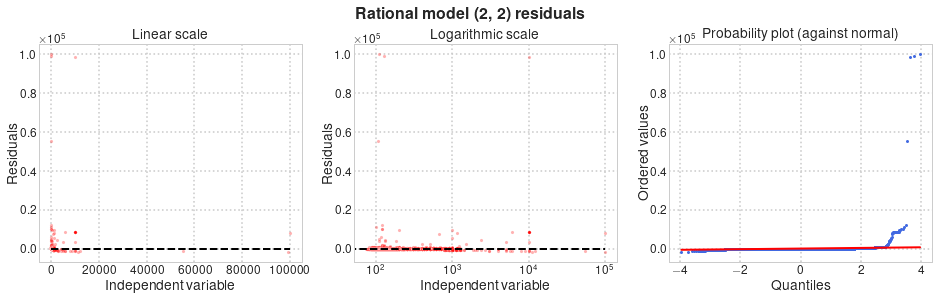

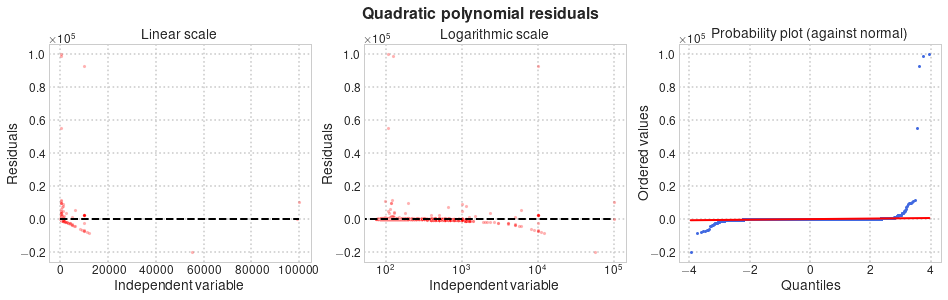

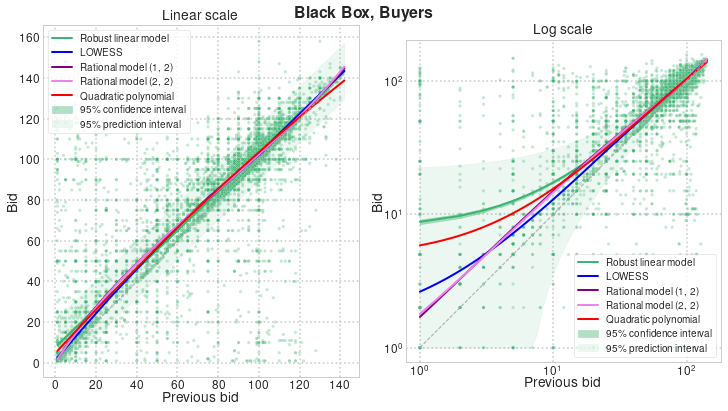

,R2 = 1 - SS_resid/SS_total
RLM,0.742966
LOWESS,0.735945
"Rational model (1, 2)",0.740881
"Rational model (2, 2)",0.740475
Quadratic polynomial,0.741602


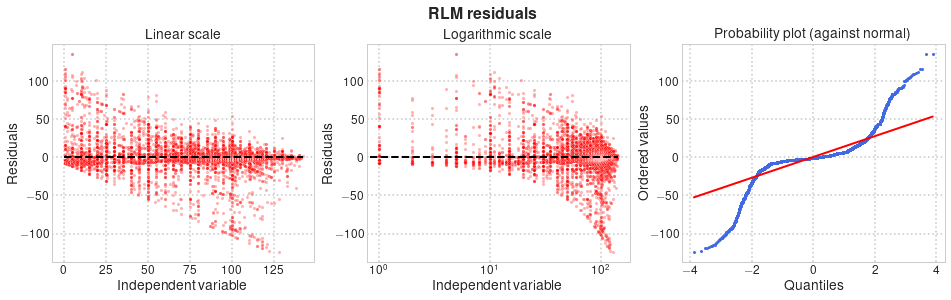

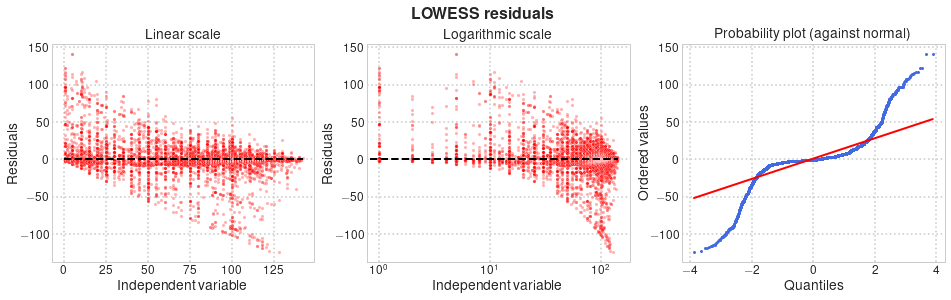

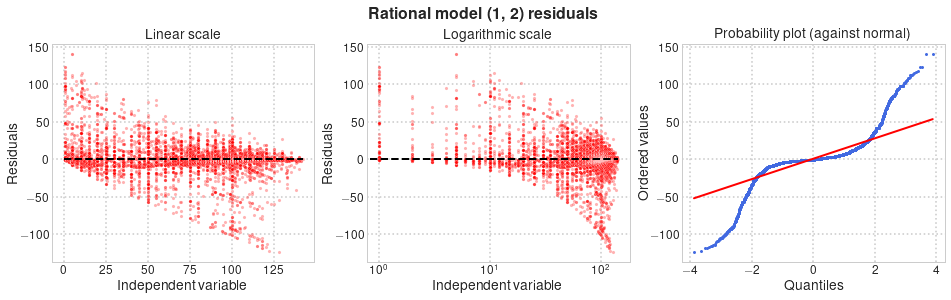

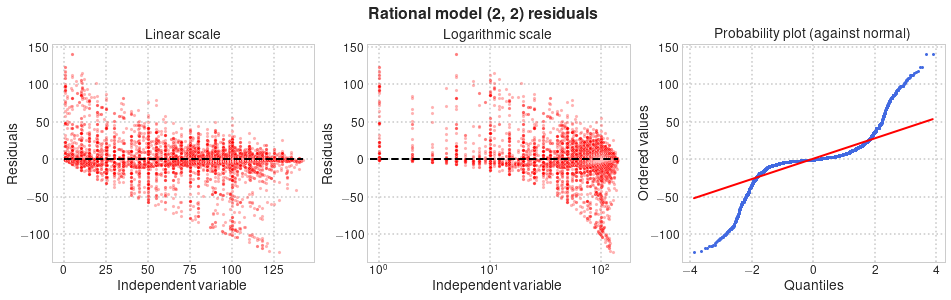

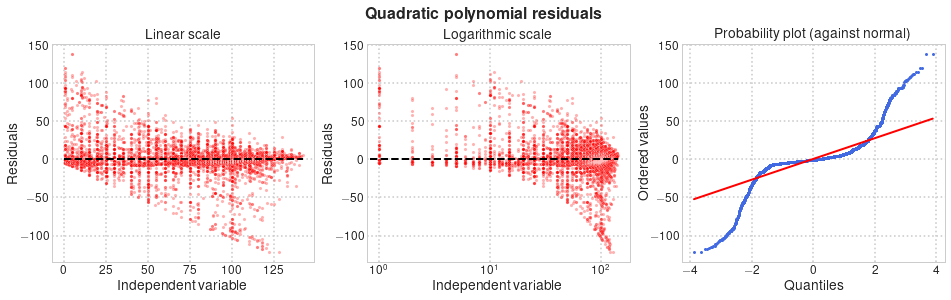

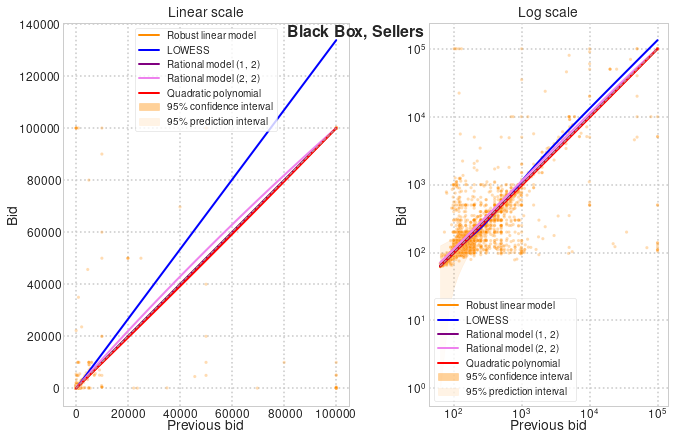

,R2 = 1 - SS_resid/SS_total
RLM,0.582963
LOWESS,0.302862
"Rational model (1, 2)",0.582961
"Rational model (2, 2)",0.582525
Quadratic polynomial,0.582996


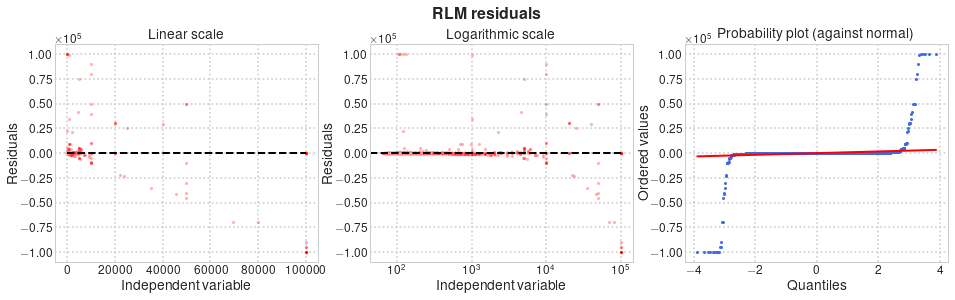

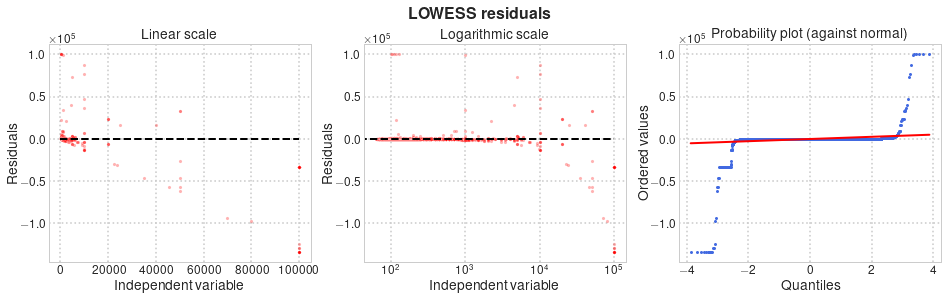

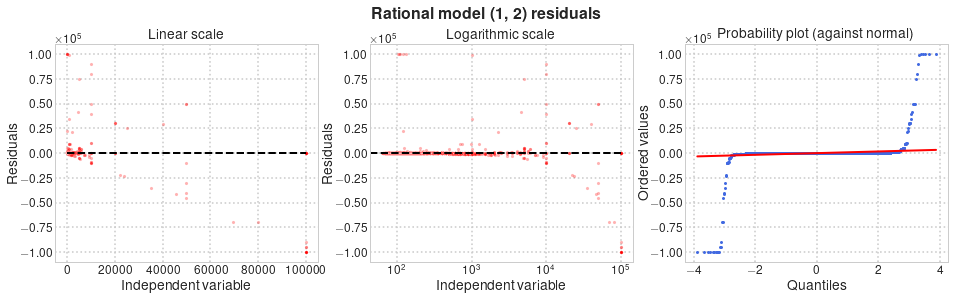

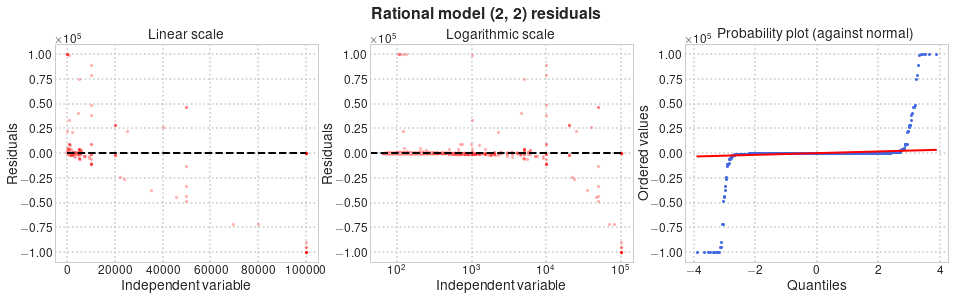

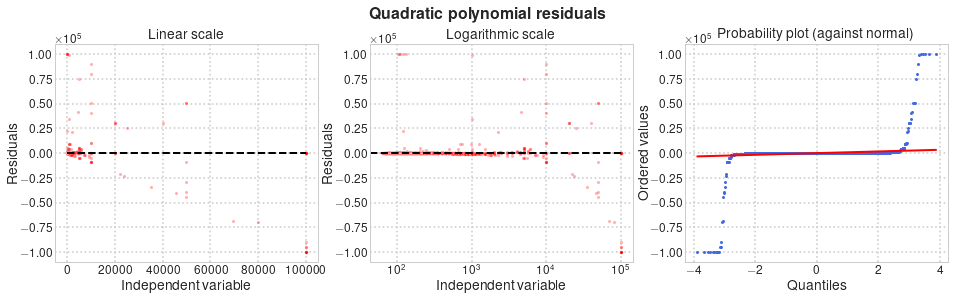

In [99]:
for (BB_mask, side), df_side in df_lags.dropna(subset=['bid-1']).groupby(['BB', 'side']):
    fig, axes = plt.subplots(1, 2, figsize=(10, 6), constrained_layout=True)
    
    suptitle = '{}, {}s'.format('Black Box' if BB_mask else 'non-Black Box', side)
    _ = plt.suptitle(bold_text(suptitle), y=0.95)
    
    x = df_side['bid-1']
    y = df_side['bid']
    mean_y = y.mean()
    
    xranges = {'linear': np.linspace(min(x), max(x)), 'log': np.geomspace(min(x), max(x))}
    fitted_vals, models, colours = nonparam_regression(df_side)
    
    for idx, scale in enumerate(['linear', 'log']):
        ax = axes[idx]
        xrange = xranges[scale]
        
        confInt, predInt = bid_regression(data=df_side, scale=scale, out=False)
        
        # Scatter plot, robust linear model, non-parametric regression models, 45-degree line
        splot = sns.scatterplot(x=x, y=y, ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, legend=False)
        regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)
                
        for method in fitted_vals.drop(columns=['x', 'y']).columns:
            if method == 'LOWESS':
                f = interp1d(fitted_vals['x'], fitted_vals[method], bounds_error=False)
                _ = ax.plot(xrange, f(xrange), label=method, linewidth=2, c=colours[method])
                
            elif 'Rational model' in method:
                _ = ax.plot(xrange, models[method](xrange), label=method, linewidth=2, c=colours[method])
                
            elif method == 'Quadratic polynomial':
                X = np.column_stack((xrange, xrange**2))
                X = sm.add_constant(X)
                _ = ax.plot(xrange, models[method].predict(X), label=method, linewidth=2, c=colours[method])

        _ = ax.plot(xrange, xrange, linestyle='dashed', color='darkgray', linewidth=1, zorder=2)
                
        # Axis layout
        _ = ax.set_title('{} scale'.format(scale.capitalize()))

        axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}
        
        try:
            _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
            _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
        except:
            pass
        
        _ = ax.set_aspect('equal', adjustable='box')
        _ = splot.set(xscale=scale, yscale=scale)

        _ = ax.legend()
    
    _ = plt.show()
    
    # Residual plots
    SS_total = sum((y - mean_y)**2)
    R2 = {} # 1 - SS_total/SS_resid
    
    residual_plot(confInt['x'], confInt['resid'])
    _ = plt.suptitle(bold_text('RLM residuals'), y=1.01)
    R2['RLM'] = 1 - sum(confInt['resid']**2)/SS_total    
    
    for method in fitted_vals.drop(columns=['x', 'y']).columns:
        yhat = fitted_vals[method]
        resid = fitted_vals['y'] - yhat
        residual_plot(fitted_vals['x'], resid)
        _ = plt.suptitle(bold_text('{} residuals'.format(method)), y=1.01)
        R2[method] = 1 - sum(resid**2)/SS_total
    
    pd.DataFrame.from_dict(R2, orient='index', columns=['R2 = 1 - SS_resid/SS_total'])

The scatter plots below are overlaid with density kernel estimates, robust linear model fits with bootstrap estimates of 95% confidence intervals, and robust non-linear (rational) model fits.

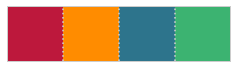

In [100]:
rm_colours = {'Buyer': '#2d748c', 'Seller': '#bd183c'}
sns.palplot([rm_colours['Seller'], side_colours['Seller'], rm_colours['Buyer'], side_colours['Buyer']])

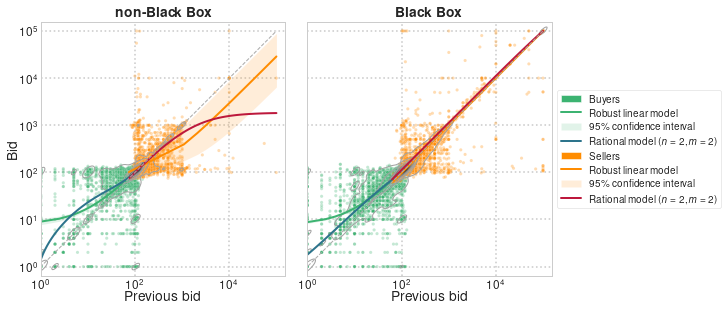

In [101]:
fig, axes = plt.subplots(1,2, figsize=(10,8), sharex=True, sharey=True,
                         constrained_layout=True)

for BB_mask, data in df_lags.dropna(subset=['bid-1']).groupby(['BB']):
    i = int(BB_mask)
    ax = axes[i]
    _ = ax.set_aspect('equal', adjustable='box')    

    for side, df_side in data.groupby(['side']):
        x = df_side['bid-1']
        y = df_side['bid']
        
        # Scatter plot, kernel density estimate, robust linear model, and rational model (2, 2)
        splot = sns.scatterplot(x='bid-1', y='bid', ax=ax, data=df_side, alpha=0.3, s=10,
                                hue='side', palette=side_colours, zorder=1)
        _ = splot.set(xscale='log', yscale='log')

        _ = sns.kdeplot(x='bid-1', y='bid', ax=ax, data=df_side, linewidths=1, log_scale=True,
                       levels=8, cmap=ListedColormap(gray_palette), zorder=2)
        
        _ = sns.regplot(x=x, y=y, ax=ax, data=df_side, robust=True, scatter=False,
                        color=side_colours[side], line_kws={'linewidth': 2})
        
        n = m = 2
        rm = least_squares(rational_residuals, x0=[1,1,1,1,1], loss='huber', f_scale=1,
                           args=(n,m,x,y), jac='cs')
        
        coeff = rm.x
        xrange = np.geomspace(min(x), max(x))
        _ = ax.plot(xrange, rational_eval(coeff, n, m, xrange), label=r'Rational model $(n=2, m=2)$',
                    linewidth=2, c=rm_colours[side])
            
        #confInt, predInt = bid_regression(data=df_side, scale='log', out=False)
        #regression_plot(ax=ax, colour=side_colours[side], confInt=confInt, predInt=predInt)

    # 45-degree line
    _ = ax.plot(range(max(data['bid'])+1), range(max(data['bid'])+1), linestyle='dashed',
                color='darkgray', linewidth=1, zorder=2)
        
    # Axis layout
    axis_labels = {'bid': 'Bid', 'bid-1': 'Previous bid'}
    
    try:
        _ = ax.set_xlabel(axis_labels[ax.get_xlabel()], labelpad=0)
        _ = ax.set_ylabel(axis_labels[ax.get_ylabel()], labelpad=0)
        
    except:
        pass
    
    _ = ax.set_title(bold_text('Black Box' if BB_mask else 'non-Black Box'))

# Legend
handles, labels = axes[0].get_legend_handles_labels()
for idx in range(len(handles)):
    if labels[idx] in ['Buyer', 'Seller']:
        handles[idx] = Patch(facecolor=side_colours[labels[idx]])
        labels[idx] = '{}s'.format(labels[idx])
    if 'Rational model' in labels[idx]:
        labels[idx] = r'Rational model $(n=2, m=2)$'

for side in ['Buyer', 'Seller']:
    handles.extend([Line2D([0], [0], color=side_colours[side], linewidth=2),
                    Patch(facecolor=side_colours[side], alpha=0.15)])
    labels.extend(['Robust linear model', r'95\% confidence interval'])
   
order = [2,4,5,0,3,6,7,1]
handles = [handles[idx] for idx in order]
labels = [labels[idx] for idx in order]
_ = axes[0].legend_.remove()
_ = axes[1].legend(handles, labels, title=None, loc='center left', bbox_to_anchor=(1, 0.5))

_ = plt.savefig('Figures/Paper/Regression_bids.pdf', bbox_inches='tight')